In [1]:
# AeroCNN-II
import os
import sys
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer

import datetime
%matplotlib inline

In [2]:
n_kernel=100
l2Regularizer=1e-09
kernel_size1 = 3
kernel_size2 = 3
#kernel_size3 = 5
n_grid = 100
strides1 = 1
strides2 = 2
lr=5e-04
batch_size=20

In [3]:
alpha = np.linspace(-10,20,16).reshape((16,1))

In [4]:
aa = np.zeros((16*133,1))
for i in range(0, 133):
    aa[16*i:16*(i+1), :] = alpha[:,:]

In [5]:
aa = aa.reshape((133, 16, 1, 1))

In [6]:
os.chdir('D:\\AeroCNN2Inputs')

In [7]:
origin = "D:\\AeroCNN2Inputs2"
origin_data = "D:\\AirfoilClCdCoordinates_out\\AirfoilClCdCoordinates_out"
origin_poisson = "D:\\CNN_poisson_files\\poisson\\bc2"

In [8]:
folders_orig = os.listdir(origin)
folders = [file for file in folders_orig if file.endswith('.csv')]

In [9]:
image_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        image_df = pd.concat([image_df, data])

In [10]:
image_np = image_df.iloc[:, :].values

In [11]:
image = image_np.reshape((133, 16, n_grid, n_grid))

In [12]:
image = 1-image/100

In [13]:
# Laplace/Poisson field
field_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin_poisson + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        field_df = pd.concat([field_df, data], axis=0)

In [14]:
field_np = field_df.iloc[:, :].values

In [15]:
imr = SimpleImputer(missing_values=np.nan, strategy='mean')
imr = imr.fit(field_np)
imputed_field = imr.transform(field_np)

In [16]:
field = imputed_field.reshape((133, 16, n_grid, n_grid))

In [17]:
field_nor = (field-np.min(field))/(np.max(field)-np.min(field))

In [18]:
file_name = origin_data + "\\AirfoilIndexList.xlsx"
airfoilName_df = pd.read_excel(file_name)
geometry_orig = airfoilName_df.iloc[:, 1].values

In [29]:
geometry = np.zeros((133*16,1))
geometry = geometry.astype(np.string_)
for i in geometry_orig:
    index_ = np.where(geometry_orig==i)
    for j in range(0,16):
        geometry[16*index_[0]+j,:] = np.asarray(i)

In [30]:
geometry = geometry.reshape((133, 16, 1))

In [31]:
x_all, x_test, aa_all, aa_test, geo_all, geo_test, y_all, y_test = train_test_split(image, aa, geometry, field_nor, test_size=0.1, random_state=1)

In [32]:
x_train, x_val, aa_train, aa_val, geo_train, geo_val, y_train, y_val = train_test_split(x_all, aa_all, geo_all, y_all, test_size=0.1, random_state=1)

In [33]:
x_train = x_train.reshape((x_train.shape[0]*x_train.shape[1], x_train.shape[2], x_train.shape[3], 1))
x_val = x_val.reshape((x_val.shape[0]*x_val.shape[1], x_val.shape[2], x_val.shape[3], 1))
x_test = x_test.reshape((x_test.shape[0]*x_test.shape[1], x_test.shape[2], x_test.shape[3], 1))
aa_train = aa_train.reshape((aa_train.shape[0]*aa_train.shape[1], aa_train.shape[2], aa_train.shape[3]))
aa_val = aa_val.reshape((aa_val.shape[0]*aa_val.shape[1], aa_val.shape[2], aa_val.shape[3]))
aa_test = aa_test.reshape((aa_test.shape[0]*aa_test.shape[1], aa_test.shape[2], aa_test.shape[3]))
geo_train = geo_train.reshape((geo_train.shape[0]*geo_train.shape[1], geo_train.shape[2]))
geo_val = geo_val.reshape((geo_val.shape[0]*geo_val.shape[1], geo_val.shape[2]))
geo_test = geo_test.reshape((geo_test.shape[0]*geo_test.shape[1], geo_test.shape[2]))
y_train = y_train.reshape((y_train.shape[0]*y_train.shape[1], y_train.shape[2], y_train.shape[3], 1))
y_val = y_val.reshape((y_val.shape[0]*y_val.shape[1], y_val.shape[2], y_val.shape[3], 1))
y_test = y_test.reshape((y_test.shape[0]*y_test.shape[1], y_test.shape[2], y_test.shape[3], 1))

In [34]:
tf.keras.backend.set_image_data_format('channels_last')

In [35]:
input_image = tf.keras.Input(shape=(n_grid, n_grid, 1))

x_conv1 = tf.keras.layers.Conv2D(n_kernel, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                 activation='relu', padding='same',
                                 kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                 name='Conv2DLayer1')(input_image)
x_1 = tf.keras.layers.MaxPooling2D((2,2))(x_conv1)
x_conv2 = tf.keras.layers.Conv2D(n_kernel*2, (kernel_size2, kernel_size2), strides=(strides1, strides1),
                                 activation='relu', padding='same',
                                 kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                 name='Conv2DLayer2')(x_1)
x_2 = tf.keras.layers.MaxPooling2D((2,2))(x_conv2)

x_deconv1 = tf.keras.layers.Conv2DTranspose(n_kernel*2, (kernel_size2, kernel_size2),
                                            strides=(strides2,strides2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer1')(x_2)
x_deconv2 = tf.keras.layers.Conv2DTranspose(n_kernel, (kernel_size1, kernel_size1),
                                            strides=(strides2,strides2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer2')(x_deconv1)

x_conv_final = tf.keras.layers.Conv2D(1, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                      activation='relu', padding='valid',
                                      kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                      name='Conv2DLayerFinal')(x_deconv2)
x_flat = tf.keras.layers.Flatten()(x_conv_final)
x_ = tf.keras.layers.Dense(units=int((n_grid)**2), activation='linear', name='FCLayer',
                           kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer))(x_flat)

output_data = tf.keras.layers.Reshape((n_grid,n_grid,1))(x_)

# AeroCNN-II/Poisson/BC 2
model = tf.keras.Model(input_image, output_data)

In [36]:
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 100, 100, 1)]     0         
                                                                 
 Conv2DLayer1 (Conv2D)       (None, 100, 100, 100)     1000      
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 50, 50, 100)      0         
 2D)                                                             
                                                                 
 Conv2DLayer2 (Conv2D)       (None, 50, 50, 200)       180200    
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 25, 25, 200)      0         
 2D)                                                             
                                                                 
 Conv2DTLayer1 (Conv2DTransp  (None, 50, 50, 200)      3602

In [37]:
#with mirrored_strategy.scope():
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
              loss = tf.keras.losses.MeanSquaredError(),
              metrics=[tf.keras.metrics.RootMeanSquaredError(name="rmse")])

In [38]:
#with mirrored_strategy.scope():
# 끝까지 학습시키고 싶을 땐 ReduceLRONPlateau에서 min_delta를 1e-11로, patience=100,
# EarlyStopping에서 patience를 200으로 설정. 평상시에는(50. 100, 1e-7로.)
# 아예 loss가 1e-6되면 멈추게끔 할 수도?
start = datetime.datetime.now()
history = model.fit(x_train, y_train, epochs=5000, shuffle=True, 
                    validation_data=[x_val, y_val], batch_size=batch_size,
                    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='loss', patience=100,
                                                                min_delta=6e-7
                                                                restore_best_weights=True,
                                                                verbose=1),
                               tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', factor=0.5,
                                                                    mode='min', patience=50,
                                                                    min_delta=1e-7,
                                                                    min_lr=1e-06,
                                                                    verbose=1)])
end = datetime.datetime.now()

Epoch 1/5000
86/86 [==============================] - 6s 45ms/step - loss: 0.0464 - rmse: 0.2154 - val_loss: 0.0195 - val_rmse: 0.1398 - lr: 5.0000e-04
Epoch 2/5000
86/86 [==============================] - 3s 34ms/step - loss: 0.0111 - rmse: 0.1052 - val_loss: 3.1233e-04 - val_rmse: 0.0174 - lr: 5.0000e-04
Epoch 3/5000
86/86 [==============================] - 3s 34ms/step - loss: 3.5311e-04 - rmse: 0.0185 - val_loss: 2.0345e-04 - val_rmse: 0.0139 - lr: 5.0000e-04
Epoch 4/5000
86/86 [==============================] - 3s 36ms/step - loss: 1.7573e-04 - rmse: 0.0129 - val_loss: 8.7034e-05 - val_rmse: 0.0087 - lr: 5.0000e-04
Epoch 5/5000
86/86 [==============================] - 3s 37ms/step - loss: 1.5170e-04 - rmse: 0.0119 - val_loss: 6.5933e-05 - val_rmse: 0.0074 - lr: 5.0000e-04
Epoch 6/5000
86/86 [==============================] - 3s 34ms/step - loss: 1.4674e-04 - rmse: 0.0117 - val_loss: 5.9907e-05 - val_rmse: 0.0070 - lr: 5.0000e-04
Epoch 7/5000
86/86 [==============================] 

86/86 [==============================] - 3s 31ms/step - loss: 1.0011e-04 - rmse: 0.0095 - val_loss: 4.5227e-05 - val_rmse: 0.0059 - lr: 5.0000e-04
Epoch 53/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.0626e-05 - rmse: 0.0078 - val_loss: 3.7228e-05 - val_rmse: 0.0052 - lr: 5.0000e-04
Epoch 54/5000
86/86 [==============================] - 3s 31ms/step - loss: 8.6259e-05 - rmse: 0.0087 - val_loss: 4.2675e-05 - val_rmse: 0.0057 - lr: 5.0000e-04
Epoch 55/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.7881e-05 - rmse: 0.0076 - val_loss: 1.3621e-04 - val_rmse: 0.0112 - lr: 5.0000e-04
Epoch 56/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.4686e-05 - rmse: 0.0080 - val_loss: 3.3992e-05 - val_rmse: 0.0049 - lr: 5.0000e-04
Epoch 57/5000
86/86 [==============================] - 3s 31ms/step - loss: 9.4929e-05 - rmse: 0.0092 - val_loss: 4.1771e-05 - val_rmse: 0.0056 - lr: 5.0000e-04
Epoch 58/5000
86/86 [===========================

Epoch 103/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.6799e-05 - rmse: 0.0061 - val_loss: 1.2868e-04 - val_rmse: 0.0109 - lr: 5.0000e-04
Epoch 104/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.8159e-05 - rmse: 0.0076 - val_loss: 1.6132e-04 - val_rmse: 0.0123 - lr: 5.0000e-04
Epoch 105/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.4725e-05 - rmse: 0.0059 - val_loss: 3.5359e-05 - val_rmse: 0.0050 - lr: 5.0000e-04
Epoch 106/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.0785e-05 - rmse: 0.0064 - val_loss: 2.0140e-04 - val_rmse: 0.0138 - lr: 5.0000e-04
Epoch 107/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.4367e-05 - rmse: 0.0074 - val_loss: 3.9871e-05 - val_rmse: 0.0055 - lr: 5.0000e-04
Epoch 108/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.1462e-05 - rmse: 0.0064 - val_loss: 4.0393e-05 - val_rmse: 0.0055 - lr: 5.0000e-04
Epoch 109/5000
86/86 [======

86/86 [==============================] - 3s 31ms/step - loss: 3.3048e-05 - rmse: 0.0048 - val_loss: 2.4148e-05 - val_rmse: 0.0038 - lr: 5.0000e-04
Epoch 154/5000
86/86 [==============================] - 3s 33ms/step - loss: 2.5114e-05 - rmse: 0.0039 - val_loss: 2.4809e-05 - val_rmse: 0.0039 - lr: 5.0000e-04
Epoch 155/5000
86/86 [==============================] - 3s 31ms/step - loss: 3.0942e-05 - rmse: 0.0046 - val_loss: 2.1376e-05 - val_rmse: 0.0034 - lr: 5.0000e-04
Epoch 156/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.0064e-04 - rmse: 0.0095 - val_loss: 7.9279e-05 - val_rmse: 0.0083 - lr: 5.0000e-04
Epoch 157/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.0695e-04 - rmse: 0.0099 - val_loss: 3.9066e-05 - val_rmse: 0.0054 - lr: 5.0000e-04
Epoch 158/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.8172e-05 - rmse: 0.0043 - val_loss: 3.9099e-05 - val_rmse: 0.0054 - lr: 5.0000e-04
Epoch 159/5000
86/86 [=====================

Epoch 204/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.1693e-05 - rmse: 0.0035 - val_loss: 2.4283e-05 - val_rmse: 0.0039 - lr: 5.0000e-04
Epoch 205/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.4210e-05 - rmse: 0.0039 - val_loss: 2.0702e-05 - val_rmse: 0.0034 - lr: 5.0000e-04
Epoch 206/5000
86/86 [==============================] - 3s 33ms/step - loss: 1.6291e-05 - rmse: 0.0027 - val_loss: 1.7597e-05 - val_rmse: 0.0029 - lr: 5.0000e-04
Epoch 207/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.9069e-05 - rmse: 0.0045 - val_loss: 3.9696e-05 - val_rmse: 0.0055 - lr: 5.0000e-04
Epoch 208/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.8212e-05 - rmse: 0.0030 - val_loss: 3.5829e-05 - val_rmse: 0.0052 - lr: 5.0000e-04
Epoch 209/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.8977e-05 - rmse: 0.0031 - val_loss: 1.6796e-05 - val_rmse: 0.0028 - lr: 5.0000e-04
Epoch 210/5000
86/86 [======

86/86 [==============================] - 3s 31ms/step - loss: 1.7494e-05 - rmse: 0.0030 - val_loss: 1.8269e-05 - val_rmse: 0.0031 - lr: 5.0000e-04
Epoch 255/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.5608e-05 - rmse: 0.0026 - val_loss: 2.7472e-05 - val_rmse: 0.0043 - lr: 5.0000e-04
Epoch 256/5000
86/86 [==============================] - 3s 31ms/step - loss: 3.5188e-05 - rmse: 0.0052 - val_loss: 1.7111e-05 - val_rmse: 0.0029 - lr: 5.0000e-04
Epoch 257/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.0369e-05 - rmse: 0.0034 - val_loss: 3.2620e-05 - val_rmse: 0.0049 - lr: 5.0000e-04
Epoch 258/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.6921e-05 - rmse: 0.0043 - val_loss: 2.6643e-05 - val_rmse: 0.0042 - lr: 5.0000e-04
Epoch 259/5000
86/86 [==============================] - 3s 31ms/step - loss: 3.1503e-05 - rmse: 0.0048 - val_loss: 3.9006e-05 - val_rmse: 0.0055 - lr: 5.0000e-04
Epoch 260/5000
86/86 [=====================

Epoch 305/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.8988e-05 - rmse: 0.0033 - val_loss: 2.9233e-05 - val_rmse: 0.0046 - lr: 5.0000e-04
Epoch 306/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.7332e-05 - rmse: 0.0044 - val_loss: 2.0467e-05 - val_rmse: 0.0035 - lr: 5.0000e-04
Epoch 307/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.5587e-05 - rmse: 0.0042 - val_loss: 1.7019e-05 - val_rmse: 0.0030 - lr: 5.0000e-04
Epoch 308/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.5998e-05 - rmse: 0.0028 - val_loss: 1.3490e-05 - val_rmse: 0.0023 - lr: 5.0000e-04
Epoch 309/5000
86/86 [==============================] - 3s 33ms/step - loss: 1.1599e-05 - rmse: 0.0019 - val_loss: 1.3834e-05 - val_rmse: 0.0024 - lr: 5.0000e-04
Epoch 310/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.2682e-05 - rmse: 0.0021 - val_loss: 1.7177e-05 - val_rmse: 0.0030 - lr: 5.0000e-04
Epoch 311/5000
86/86 [======

86/86 [==============================] - 3s 31ms/step - loss: 7.7948e-05 - rmse: 0.0084 - val_loss: 2.9058e-05 - val_rmse: 0.0046 - lr: 5.0000e-04
Epoch 356/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.8424e-05 - rmse: 0.0033 - val_loss: 1.3262e-05 - val_rmse: 0.0024 - lr: 5.0000e-04
Epoch 357/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.0931e-05 - rmse: 0.0018 - val_loss: 1.3731e-05 - val_rmse: 0.0025 - lr: 5.0000e-04
Epoch 358/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.2212e-05 - rmse: 0.0021 - val_loss: 1.9952e-05 - val_rmse: 0.0035 - lr: 5.0000e-04
Epoch 359/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.0810e-05 - rmse: 0.0018 - val_loss: 1.6146e-05 - val_rmse: 0.0029 - lr: 5.0000e-04
Epoch 360/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.1227e-05 - rmse: 0.0019 - val_loss: 1.6515e-05 - val_rmse: 0.0030 - lr: 5.0000e-04
Epoch 361/5000
86/86 [=====================

Epoch 406/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.3437e-05 - rmse: 0.0025 - val_loss: 2.9154e-05 - val_rmse: 0.0047 - lr: 5.0000e-04
Epoch 407/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.6949e-05 - rmse: 0.0031 - val_loss: 1.2872e-05 - val_rmse: 0.0024 - lr: 5.0000e-04
Epoch 408/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.2556e-05 - rmse: 0.0023 - val_loss: 1.0523e-05 - val_rmse: 0.0018 - lr: 5.0000e-04
Epoch 409/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.2168e-05 - rmse: 0.0022 - val_loss: 1.9129e-05 - val_rmse: 0.0035 - lr: 5.0000e-04
Epoch 410/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.9842e-05 - rmse: 0.0036 - val_loss: 4.9225e-05 - val_rmse: 0.0065 - lr: 5.0000e-04
Epoch 411/5000
86/86 [==============================] - 3s 31ms/step - loss: 2.3498e-05 - rmse: 0.0040 - val_loss: 1.1787e-05 - val_rmse: 0.0021 - lr: 5.0000e-04
Epoch 412/5000
86/86 [======

86/86 [==============================] - 3s 31ms/step - loss: 1.7180e-05 - rmse: 0.0032 - val_loss: 1.1085e-05 - val_rmse: 0.0021 - lr: 5.0000e-04
Epoch 457/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.2402e-05 - rmse: 0.0024 - val_loss: 1.4041e-05 - val_rmse: 0.0027 - lr: 5.0000e-04
Epoch 458/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.1592e-05 - rmse: 0.0022 - val_loss: 2.9038e-05 - val_rmse: 0.0047 - lr: 5.0000e-04
Epoch 459/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.8404e-05 - rmse: 0.0034 - val_loss: 1.2867e-05 - val_rmse: 0.0025 - lr: 5.0000e-04
Epoch 460/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.1177e-05 - rmse: 0.0021 - val_loss: 1.1501e-05 - val_rmse: 0.0022 - lr: 5.0000e-04
Epoch 461/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.2021e-05 - rmse: 0.0023 - val_loss: 1.2797e-05 - val_rmse: 0.0025 - lr: 5.0000e-04
Epoch 462/5000
86/86 [=====================

86/86 [==============================] - 3s 31ms/step - loss: 7.4954e-06 - rmse: 0.0010 - val_loss: 1.1649e-05 - val_rmse: 0.0023 - lr: 2.5000e-04
Epoch 506/5000
86/86 [==============================] - 3s 31ms/step - loss: 1.2814e-05 - rmse: 0.0025 - val_loss: 1.0359e-05 - val_rmse: 0.0020 - lr: 2.5000e-04
Epoch 507/5000
86/86 [==============================] - 3s 31ms/step - loss: 9.5701e-06 - rmse: 0.0018 - val_loss: 9.5307e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 508/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.6104e-06 - rmse: 0.0011 - val_loss: 9.4116e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 509/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.1232e-06 - rmse: 8.1551e-04 - val_loss: 9.9218e-06 - val_rmse: 0.0019 - lr: 2.5000e-04
Epoch 510/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.1890e-06 - rmse: 8.5770e-04 - val_loss: 9.4519e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 511/5000
86/86 [=============

86/86 [==============================] - 3s 31ms/step - loss: 8.9779e-06 - rmse: 0.0017 - val_loss: 9.3268e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 556/5000
86/86 [==============================] - 3s 33ms/step - loss: 6.8969e-06 - rmse: 8.1328e-04 - val_loss: 9.5360e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 557/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.7973e-06 - rmse: 0.0013 - val_loss: 1.1781e-05 - val_rmse: 0.0024 - lr: 2.5000e-04
Epoch 558/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.6241e-06 - rmse: 0.0012 - val_loss: 9.2090e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 559/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.3759e-06 - rmse: 0.0011 - val_loss: 9.9668e-06 - val_rmse: 0.0019 - lr: 2.5000e-04
Epoch 560/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.3259e-06 - rmse: 0.0011 - val_loss: 1.1613e-05 - val_rmse: 0.0023 - lr: 2.5000e-04
Epoch 561/5000
86/86 [=================

86/86 [==============================] - 3s 31ms/step - loss: 7.3200e-06 - rmse: 0.0011 - val_loss: 8.7309e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 606/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.7787e-06 - rmse: 0.0013 - val_loss: 1.1804e-05 - val_rmse: 0.0024 - lr: 2.5000e-04
Epoch 607/5000
86/86 [==============================] - 3s 31ms/step - loss: 8.5718e-06 - rmse: 0.0016 - val_loss: 1.1495e-05 - val_rmse: 0.0023 - lr: 2.5000e-04
Epoch 608/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.0180e-06 - rmse: 0.0010 - val_loss: 1.0070e-05 - val_rmse: 0.0020 - lr: 2.5000e-04
Epoch 609/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.4270e-06 - rmse: 0.0012 - val_loss: 9.1127e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 610/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.6949e-06 - rmse: 8.3972e-04 - val_loss: 8.9964e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 611/5000
86/86 [=================

Epoch 655/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.5825e-06 - rmse: 0.0013 - val_loss: 8.9879e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 656/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.7394e-06 - rmse: 9.7496e-04 - val_loss: 8.8388e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 657/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.8769e-06 - rmse: 0.0010 - val_loss: 9.1759e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 658/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.1395e-06 - rmse: 0.0012 - val_loss: 8.8297e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 659/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.3282e-06 - rmse: 0.0012 - val_loss: 9.9384e-06 - val_rmse: 0.0020 - lr: 2.5000e-04
Epoch 660/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.4434e-06 - rmse: 8.1967e-04 - val_loss: 9.2741e-06 - val_rmse: 0.0019 - lr: 2.5000e-04
Epoch 661/5000
86/86

Epoch 705/5000
86/86 [==============================] - 3s 32ms/step - loss: 6.2384e-06 - rmse: 8.0934e-04 - val_loss: 8.4884e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 706/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.2074e-06 - rmse: 7.9258e-04 - val_loss: 8.2900e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 707/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.4854e-06 - rmse: 9.5417e-04 - val_loss: 9.2783e-06 - val_rmse: 0.0019 - lr: 2.5000e-04
Epoch 708/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.2806e-06 - rmse: 0.0013 - val_loss: 8.6671e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 709/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.4975e-06 - rmse: 9.6470e-04 - val_loss: 8.0521e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 710/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.7208e-06 - rmse: 0.0011 - val_loss: 1.0296e-05 - val_rmse: 0.0022 - lr: 2.5000e-04
Epoch 711/50

Epoch 755/5000
86/86 [==============================] - 3s 31ms/step - loss: 7.0108e-06 - rmse: 0.0013 - val_loss: 8.7115e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 756/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.4982e-06 - rmse: 0.0011 - val_loss: 8.5921e-06 - val_rmse: 0.0018 - lr: 2.5000e-04
Epoch 757/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.8495e-06 - rmse: 6.9066e-04 - val_loss: 7.9230e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 758/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.8992e-06 - rmse: 7.2854e-04 - val_loss: 8.2074e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 759/5000
86/86 [==============================] - 3s 33ms/step - loss: 5.6961e-06 - rmse: 5.7591e-04 - val_loss: 8.3725e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 760/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.8244e-06 - rmse: 6.8123e-04 - val_loss: 7.8246e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 761/50

Epoch 805/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.5309e-06 - rmse: 5.8819e-04 - val_loss: 7.9276e-06 - val_rmse: 0.0017 - lr: 2.5000e-04
Epoch 806/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.5930e-06 - rmse: 6.4194e-04 - val_loss: 7.7703e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 807/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.5318e-06 - rmse: 5.9570e-04 - val_loss: 7.6427e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 808/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.6382e-06 - rmse: 6.8207e-04 - val_loss: 9.0367e-06 - val_rmse: 0.0020 - lr: 2.5000e-04
Epoch 809/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.5641e-06 - rmse: 6.2852e-04 - val_loss: 7.8257e-06 - val_rmse: 0.0016 - lr: 2.5000e-04
Epoch 810/5000
86/86 [==============================] - 3s 31ms/step - loss: 6.8189e-06 - rmse: 0.0013 - val_loss: 9.2948e-06 - val_rmse: 0.0020 - lr: 2.5000e-04
Epoch 81

Epoch 854/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.2015e-06 - rmse: 4.4413e-04 - val_loss: 7.3363e-06 - val_rmse: 0.0015 - lr: 1.2500e-04
Epoch 855/5000
86/86 [==============================] - 3s 33ms/step - loss: 5.1689e-06 - rmse: 4.0814e-04 - val_loss: 7.4277e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoch 856/5000
86/86 [==============================] - 3s 33ms/step - loss: 5.1397e-06 - rmse: 3.7325e-04 - val_loss: 7.4367e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoch 857/5000
86/86 [==============================] - 3s 33ms/step - loss: 5.1340e-06 - rmse: 3.6813e-04 - val_loss: 7.4417e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoch 858/5000
86/86 [==============================] - 3s 33ms/step - loss: 5.1336e-06 - rmse: 3.7018e-04 - val_loss: 7.4199e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoch 859/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.1342e-06 - rmse: 3.7351e-04 - val_loss: 7.4017e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoc

86/86 [==============================] - 3s 31ms/step - loss: 5.2132e-06 - rmse: 5.5128e-04 - val_loss: 8.8796e-06 - val_rmse: 0.0020 - lr: 1.2500e-04
Epoch 904/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.2552e-06 - rmse: 5.8975e-04 - val_loss: 7.4607e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoch 905/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.0877e-06 - rmse: 4.2682e-04 - val_loss: 7.4148e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoch 906/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.1466e-06 - rmse: 4.9302e-04 - val_loss: 7.3016e-06 - val_rmse: 0.0015 - lr: 1.2500e-04
Epoch 907/5000
86/86 [==============================] - 3s 31ms/step - loss: 5.0999e-06 - rmse: 4.4528e-04 - val_loss: 7.2789e-06 - val_rmse: 0.0015 - lr: 1.2500e-04
Epoch 908/5000
86/86 [==============================] - 3s 33ms/step - loss: 5.0519e-06 - rmse: 3.9019e-04 - val_loss: 7.3443e-06 - val_rmse: 0.0016 - lr: 1.2500e-04
Epoch 909/5000
86/8

86/86 [==============================] - 3s 31ms/step - loss: 4.9503e-06 - rmse: 3.5482e-04 - val_loss: 7.2167e-06 - val_rmse: 0.0015 - lr: 6.2500e-05
Epoch 952/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.9249e-06 - rmse: 3.1855e-04 - val_loss: 7.1607e-06 - val_rmse: 0.0015 - lr: 6.2500e-05
Epoch 953/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.9379e-06 - rmse: 3.3968e-04 - val_loss: 7.1610e-06 - val_rmse: 0.0015 - lr: 6.2500e-05
Epoch 954/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.9371e-06 - rmse: 3.3996e-04 - val_loss: 7.2078e-06 - val_rmse: 0.0015 - lr: 6.2500e-05
Epoch 955/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.9618e-06 - rmse: 3.7592e-04 - val_loss: 7.2130e-06 - val_rmse: 0.0015 - lr: 6.2500e-05
Epoch 956/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.9279e-06 - rmse: 3.2908e-04 - val_loss: 7.1836e-06 - val_rmse: 0.0015 - lr: 6.2500e-05
Epoch 957/5000
86/8

86/86 [==============================] - 3s 31ms/step - loss: 4.8806e-06 - rmse: 3.1702e-04 - val_loss: 7.1445e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1000/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8844e-06 - rmse: 3.2372e-04 - val_loss: 7.1271e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1001/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8753e-06 - rmse: 3.1028e-04 - val_loss: 7.1155e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1002/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8779e-06 - rmse: 3.1512e-04 - val_loss: 7.1566e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1003/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8730e-06 - rmse: 3.0810e-04 - val_loss: 7.1208e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1004/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8772e-06 - rmse: 3.1552e-04 - val_loss: 7.1476e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1005/500

86/86 [==============================] - 3s 31ms/step - loss: 4.8511e-06 - rmse: 3.0813e-04 - val_loss: 7.1486e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1049/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8550e-06 - rmse: 3.1518e-04 - val_loss: 7.1127e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1050/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8601e-06 - rmse: 3.2395e-04 - val_loss: 7.1056e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1051/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8466e-06 - rmse: 3.0313e-04 - val_loss: 7.1246e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1052/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8605e-06 - rmse: 3.2600e-04 - val_loss: 7.0914e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1053/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8495e-06 - rmse: 3.0958e-04 - val_loss: 7.0991e-06 - val_rmse: 0.0015 - lr: 3.1250e-05
Epoch 1054/500

86/86 [==============================] - 3s 31ms/step - loss: 4.8246e-06 - rmse: 2.9301e-04 - val_loss: 7.1027e-06 - val_rmse: 0.0015 - lr: 1.5625e-05
Epoch 1097/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8293e-06 - rmse: 3.0141e-04 - val_loss: 7.0825e-06 - val_rmse: 0.0015 - lr: 1.5625e-05
Epoch 1098/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8331e-06 - rmse: 3.0798e-04 - val_loss: 7.0811e-06 - val_rmse: 0.0015 - lr: 1.5625e-05
Epoch 1099/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.8189e-06 - rmse: 2.8454e-04 - val_loss: 7.0600e-06 - val_rmse: 0.0015 - lr: 1.5625e-05
Epoch 1100/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8282e-06 - rmse: 3.0074e-04 - val_loss: 7.0837e-06 - val_rmse: 0.0015 - lr: 1.5625e-05
Epoch 1101/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8198e-06 - rmse: 2.8694e-04 - val_loss: 7.0990e-06 - val_rmse: 0.0015 - lr: 1.5625e-05
Epoch 1102/500

86/86 [==============================] - 3s 33ms/step - loss: 4.8082e-06 - rmse: 2.8021e-04 - val_loss: 7.0576e-06 - val_rmse: 0.0015 - lr: 7.8125e-06
Epoch 1145/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8083e-06 - rmse: 2.8048e-04 - val_loss: 7.0810e-06 - val_rmse: 0.0015 - lr: 7.8125e-06
Epoch 1146/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8092e-06 - rmse: 2.8235e-04 - val_loss: 7.0562e-06 - val_rmse: 0.0015 - lr: 7.8125e-06
Epoch 1147/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8084e-06 - rmse: 2.8117e-04 - val_loss: 7.0644e-06 - val_rmse: 0.0015 - lr: 7.8125e-06
Epoch 1148/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8088e-06 - rmse: 2.8206e-04 - val_loss: 7.0595e-06 - val_rmse: 0.0015 - lr: 7.8125e-06
Epoch 1149/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.8077e-06 - rmse: 2.8029e-04 - val_loss: 7.0774e-06 - val_rmse: 0.0015 - lr: 7.8125e-06
Epoch 1150/500

86/86 [==============================] - 3s 31ms/step - loss: 4.8027e-06 - rmse: 2.7865e-04 - val_loss: 7.0644e-06 - val_rmse: 0.0015 - lr: 3.9063e-06
Epoch 1193/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8024e-06 - rmse: 2.7814e-04 - val_loss: 7.0588e-06 - val_rmse: 0.0015 - lr: 3.9063e-06
Epoch 1194/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.8010e-06 - rmse: 2.7573e-04 - val_loss: 7.0639e-06 - val_rmse: 0.0015 - lr: 3.9063e-06
Epoch 1195/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8015e-06 - rmse: 2.7673e-04 - val_loss: 7.0762e-06 - val_rmse: 0.0015 - lr: 3.9063e-06
Epoch 1196/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8019e-06 - rmse: 2.7756e-04 - val_loss: 7.0588e-06 - val_rmse: 0.0015 - lr: 3.9063e-06
Epoch 1197/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.8022e-06 - rmse: 2.7821e-04 - val_loss: 7.0675e-06 - val_rmse: 0.0015 - lr: 3.9063e-06
Epoch 1198/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7984e-06 - rmse: 2.7520e-04 - val_loss: 7.0573e-06 - val_rmse: 0.0015 - lr: 1.9531e-06
Epoch 1241/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7984e-06 - rmse: 2.7518e-04 - val_loss: 7.0511e-06 - val_rmse: 0.0015 - lr: 1.9531e-06
Epoch 1242/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7987e-06 - rmse: 2.7588e-04 - val_loss: 7.0511e-06 - val_rmse: 0.0015 - lr: 1.9531e-06
Epoch 1243/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7984e-06 - rmse: 2.7524e-04 - val_loss: 7.0518e-06 - val_rmse: 0.0015 - lr: 1.9531e-06
Epoch 1244/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7984e-06 - rmse: 2.7534e-04 - val_loss: 7.0557e-06 - val_rmse: 0.0015 - lr: 1.9531e-06
Epoch 1245/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7981e-06 - rmse: 2.7496e-04 - val_loss: 7.0551e-06 - val_rmse: 0.0015 - lr: 1.9531e-06
Epoch 1246/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7964e-06 - rmse: 2.7378e-04 - val_loss: 7.0534e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1289/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7962e-06 - rmse: 2.7338e-04 - val_loss: 7.0505e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1290/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7962e-06 - rmse: 2.7334e-04 - val_loss: 7.0497e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1291/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7961e-06 - rmse: 2.7319e-04 - val_loss: 7.0523e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1292/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7964e-06 - rmse: 2.7374e-04 - val_loss: 7.0563e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1293/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7963e-06 - rmse: 2.7363e-04 - val_loss: 7.0519e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1294/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7956e-06 - rmse: 2.7360e-04 - val_loss: 7.0537e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1338/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7960e-06 - rmse: 2.7433e-04 - val_loss: 7.0520e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1339/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7955e-06 - rmse: 2.7347e-04 - val_loss: 7.0529e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1340/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7955e-06 - rmse: 2.7344e-04 - val_loss: 7.0505e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1341/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7961e-06 - rmse: 2.7451e-04 - val_loss: 7.0666e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1342/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7962e-06 - rmse: 2.7472e-04 - val_loss: 7.0523e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1343/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7950e-06 - rmse: 2.7389e-04 - val_loss: 7.0445e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1387/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7953e-06 - rmse: 2.7434e-04 - val_loss: 7.0515e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1388/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7953e-06 - rmse: 2.7449e-04 - val_loss: 7.0525e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1389/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7952e-06 - rmse: 2.7434e-04 - val_loss: 7.0549e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1390/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7950e-06 - rmse: 2.7399e-04 - val_loss: 7.0560e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1391/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7950e-06 - rmse: 2.7402e-04 - val_loss: 7.0500e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1392/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7943e-06 - rmse: 2.7398e-04 - val_loss: 7.0511e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1436/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7944e-06 - rmse: 2.7417e-04 - val_loss: 7.0482e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1437/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7946e-06 - rmse: 2.7444e-04 - val_loss: 7.0498e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1438/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7942e-06 - rmse: 2.7374e-04 - val_loss: 7.0451e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1439/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7945e-06 - rmse: 2.7436e-04 - val_loss: 7.0662e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1440/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7948e-06 - rmse: 2.7493e-04 - val_loss: 7.0508e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1441/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7935e-06 - rmse: 2.7378e-04 - val_loss: 7.0540e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1485/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7935e-06 - rmse: 2.7382e-04 - val_loss: 7.0531e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1486/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7932e-06 - rmse: 2.7336e-04 - val_loss: 7.0522e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1487/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7932e-06 - rmse: 2.7332e-04 - val_loss: 7.0573e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1488/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7938e-06 - rmse: 2.7438e-04 - val_loss: 7.0505e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1489/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7933e-06 - rmse: 2.7352e-04 - val_loss: 7.0480e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1490/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7924e-06 - rmse: 2.7310e-04 - val_loss: 7.0483e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1534/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7924e-06 - rmse: 2.7308e-04 - val_loss: 7.0553e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1535/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7926e-06 - rmse: 2.7355e-04 - val_loss: 7.0469e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1536/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7925e-06 - rmse: 2.7347e-04 - val_loss: 7.0559e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1537/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7923e-06 - rmse: 2.7308e-04 - val_loss: 7.0503e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1538/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7923e-06 - rmse: 2.7305e-04 - val_loss: 7.0479e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1539/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7917e-06 - rmse: 2.7316e-04 - val_loss: 7.0510e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1583/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7917e-06 - rmse: 2.7319e-04 - val_loss: 7.0468e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1584/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7919e-06 - rmse: 2.7365e-04 - val_loss: 7.0497e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1585/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7921e-06 - rmse: 2.7394e-04 - val_loss: 7.0434e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1586/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7915e-06 - rmse: 2.7288e-04 - val_loss: 7.0514e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1587/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7918e-06 - rmse: 2.7352e-04 - val_loss: 7.0543e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1588/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7916e-06 - rmse: 2.7441e-04 - val_loss: 7.0449e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1632/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7918e-06 - rmse: 2.7477e-04 - val_loss: 7.0608e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1633/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7915e-06 - rmse: 2.7431e-04 - val_loss: 7.0468e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1634/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7920e-06 - rmse: 2.7510e-04 - val_loss: 7.0448e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1635/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7920e-06 - rmse: 2.7510e-04 - val_loss: 7.0516e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1636/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7923e-06 - rmse: 2.7568e-04 - val_loss: 7.0493e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1637/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7901e-06 - rmse: 2.7288e-04 - val_loss: 7.0419e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1681/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7900e-06 - rmse: 2.7275e-04 - val_loss: 7.0431e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1682/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7899e-06 - rmse: 2.7264e-04 - val_loss: 7.0445e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1683/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7898e-06 - rmse: 2.7247e-04 - val_loss: 7.0457e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1684/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7897e-06 - rmse: 2.7241e-04 - val_loss: 7.0477e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1685/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7900e-06 - rmse: 2.7299e-04 - val_loss: 7.0478e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1686/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7893e-06 - rmse: 2.7290e-04 - val_loss: 7.0439e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1730/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7892e-06 - rmse: 2.7260e-04 - val_loss: 7.0441e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1731/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7894e-06 - rmse: 2.7301e-04 - val_loss: 7.0470e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1732/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7899e-06 - rmse: 2.7393e-04 - val_loss: 7.0439e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1733/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7900e-06 - rmse: 2.7420e-04 - val_loss: 7.0480e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1734/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7893e-06 - rmse: 2.7294e-04 - val_loss: 7.0438e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1735/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7888e-06 - rmse: 2.7335e-04 - val_loss: 7.0423e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1779/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7886e-06 - rmse: 2.7300e-04 - val_loss: 7.0392e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1780/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7889e-06 - rmse: 2.7345e-04 - val_loss: 7.0484e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1781/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7886e-06 - rmse: 2.7302e-04 - val_loss: 7.0443e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1782/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7885e-06 - rmse: 2.7291e-04 - val_loss: 7.0411e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1783/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7885e-06 - rmse: 2.7292e-04 - val_loss: 7.0371e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1784/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7875e-06 - rmse: 2.7221e-04 - val_loss: 7.0414e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1828/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7874e-06 - rmse: 2.7209e-04 - val_loss: 7.0371e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1829/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7874e-06 - rmse: 2.7209e-04 - val_loss: 7.0441e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1830/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7875e-06 - rmse: 2.7229e-04 - val_loss: 7.0449e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1831/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7874e-06 - rmse: 2.7214e-04 - val_loss: 7.0402e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1832/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7874e-06 - rmse: 2.7225e-04 - val_loss: 7.0431e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1833/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7869e-06 - rmse: 2.7244e-04 - val_loss: 7.0360e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1877/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7870e-06 - rmse: 2.7266e-04 - val_loss: 7.0430e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1878/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7870e-06 - rmse: 2.7265e-04 - val_loss: 7.0444e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1879/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7866e-06 - rmse: 2.7200e-04 - val_loss: 7.0428e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1880/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7866e-06 - rmse: 2.7199e-04 - val_loss: 7.0470e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1881/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7866e-06 - rmse: 2.7208e-04 - val_loss: 7.0435e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1882/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7861e-06 - rmse: 2.7241e-04 - val_loss: 7.0455e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1926/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7862e-06 - rmse: 2.7257e-04 - val_loss: 7.0368e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1927/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7860e-06 - rmse: 2.7231e-04 - val_loss: 7.0463e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1928/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7866e-06 - rmse: 2.7341e-04 - val_loss: 7.0386e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1929/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7862e-06 - rmse: 2.7266e-04 - val_loss: 7.0440e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1930/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7859e-06 - rmse: 2.7207e-04 - val_loss: 7.0415e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1931/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7858e-06 - rmse: 2.7323e-04 - val_loss: 7.0377e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1975/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7857e-06 - rmse: 2.7294e-04 - val_loss: 7.0402e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1976/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7861e-06 - rmse: 2.7381e-04 - val_loss: 7.0468e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1977/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7858e-06 - rmse: 2.7316e-04 - val_loss: 7.0388e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1978/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7856e-06 - rmse: 2.7291e-04 - val_loss: 7.0426e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1979/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7852e-06 - rmse: 2.7215e-04 - val_loss: 7.0359e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 1980/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7858e-06 - rmse: 2.7453e-04 - val_loss: 7.0373e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2024/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7858e-06 - rmse: 2.7450e-04 - val_loss: 7.0463e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2025/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7861e-06 - rmse: 2.7503e-04 - val_loss: 7.0361e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2026/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7857e-06 - rmse: 2.7450e-04 - val_loss: 7.0388e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2027/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7862e-06 - rmse: 2.7538e-04 - val_loss: 7.0383e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2028/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7858e-06 - rmse: 2.7464e-04 - val_loss: 7.0504e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2029/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7837e-06 - rmse: 2.7207e-04 - val_loss: 7.0437e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2073/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7840e-06 - rmse: 2.7254e-04 - val_loss: 7.0484e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2074/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7840e-06 - rmse: 2.7254e-04 - val_loss: 7.0415e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2075/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7840e-06 - rmse: 2.7261e-04 - val_loss: 7.0364e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2076/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7837e-06 - rmse: 2.7219e-04 - val_loss: 7.0471e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2077/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7841e-06 - rmse: 2.7294e-04 - val_loss: 7.0387e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2078/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7831e-06 - rmse: 2.7233e-04 - val_loss: 7.0363e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2122/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7833e-06 - rmse: 2.7273e-04 - val_loss: 7.0321e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2123/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7837e-06 - rmse: 2.7349e-04 - val_loss: 7.0314e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2124/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7833e-06 - rmse: 2.7265e-04 - val_loss: 7.0383e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2125/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7830e-06 - rmse: 2.7219e-04 - val_loss: 7.0421e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2126/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7828e-06 - rmse: 2.7180e-04 - val_loss: 7.0467e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2127/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7827e-06 - rmse: 2.7280e-04 - val_loss: 7.0327e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2171/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7824e-06 - rmse: 2.7227e-04 - val_loss: 7.0308e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2172/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7827e-06 - rmse: 2.7286e-04 - val_loss: 7.0370e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2173/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7823e-06 - rmse: 2.7224e-04 - val_loss: 7.0382e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2174/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7823e-06 - rmse: 2.7232e-04 - val_loss: 7.0420e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2175/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7825e-06 - rmse: 2.7267e-04 - val_loss: 7.0347e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2176/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7817e-06 - rmse: 2.7236e-04 - val_loss: 7.0323e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2220/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7814e-06 - rmse: 2.7191e-04 - val_loss: 7.0411e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2221/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7817e-06 - rmse: 2.7238e-04 - val_loss: 7.0298e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2222/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7815e-06 - rmse: 2.7211e-04 - val_loss: 7.0394e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2223/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7815e-06 - rmse: 2.7218e-04 - val_loss: 7.0335e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2224/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7812e-06 - rmse: 2.7156e-04 - val_loss: 7.0327e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2225/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7810e-06 - rmse: 2.7244e-04 - val_loss: 7.0321e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2269/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7809e-06 - rmse: 2.7222e-04 - val_loss: 7.0327e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2270/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7808e-06 - rmse: 2.7209e-04 - val_loss: 7.0357e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2271/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7810e-06 - rmse: 2.7261e-04 - val_loss: 7.0329e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2272/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7808e-06 - rmse: 2.7214e-04 - val_loss: 7.0304e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2273/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7808e-06 - rmse: 2.7223e-04 - val_loss: 7.0296e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2274/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7799e-06 - rmse: 2.7187e-04 - val_loss: 7.0370e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2318/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7799e-06 - rmse: 2.7175e-04 - val_loss: 7.0344e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2319/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7802e-06 - rmse: 2.7238e-04 - val_loss: 7.0388e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2320/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7801e-06 - rmse: 2.7231e-04 - val_loss: 7.0370e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2321/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7804e-06 - rmse: 2.7286e-04 - val_loss: 7.0311e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2322/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7805e-06 - rmse: 2.7303e-04 - val_loss: 7.0244e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2323/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7792e-06 - rmse: 2.7186e-04 - val_loss: 7.0348e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2367/5000
86/86 [==============================] - 3s 34ms/step - loss: 4.7791e-06 - rmse: 2.7175e-04 - val_loss: 7.0319e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2368/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7793e-06 - rmse: 2.7208e-04 - val_loss: 7.0348e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2369/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7792e-06 - rmse: 2.7197e-04 - val_loss: 7.0318e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2370/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7789e-06 - rmse: 2.7144e-04 - val_loss: 7.0319e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2371/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7791e-06 - rmse: 2.7188e-04 - val_loss: 7.0317e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2372/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7792e-06 - rmse: 2.7324e-04 - val_loss: 7.0341e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2416/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7791e-06 - rmse: 2.7301e-04 - val_loss: 7.0507e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2417/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7793e-06 - rmse: 2.7338e-04 - val_loss: 7.0436e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2418/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7790e-06 - rmse: 2.7300e-04 - val_loss: 7.0255e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2419/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7793e-06 - rmse: 2.7347e-04 - val_loss: 7.0316e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2420/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7794e-06 - rmse: 2.7373e-04 - val_loss: 7.0307e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2421/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7772e-06 - rmse: 2.7088e-04 - val_loss: 7.0368e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2465/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7777e-06 - rmse: 2.7181e-04 - val_loss: 7.0335e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2466/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7774e-06 - rmse: 2.7131e-04 - val_loss: 7.0358e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2467/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7775e-06 - rmse: 2.7147e-04 - val_loss: 7.0332e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2468/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7772e-06 - rmse: 2.7101e-04 - val_loss: 7.0288e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2469/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7772e-06 - rmse: 2.7102e-04 - val_loss: 7.0332e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2470/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7768e-06 - rmse: 2.7144e-04 - val_loss: 7.0341e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2514/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7767e-06 - rmse: 2.7128e-04 - val_loss: 7.0318e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2515/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7766e-06 - rmse: 2.7113e-04 - val_loss: 7.0290e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2516/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7768e-06 - rmse: 2.7148e-04 - val_loss: 7.0262e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2517/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7770e-06 - rmse: 2.7191e-04 - val_loss: 7.0336e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2518/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7768e-06 - rmse: 2.7156e-04 - val_loss: 7.0272e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2519/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7764e-06 - rmse: 2.7204e-04 - val_loss: 7.0265e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2563/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7767e-06 - rmse: 2.7272e-04 - val_loss: 7.0345e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2564/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7761e-06 - rmse: 2.7162e-04 - val_loss: 7.0272e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2565/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7773e-06 - rmse: 2.7383e-04 - val_loss: 7.0280e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2566/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7762e-06 - rmse: 2.7191e-04 - val_loss: 7.0277e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2567/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7762e-06 - rmse: 2.7196e-04 - val_loss: 7.0283e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2568/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7756e-06 - rmse: 2.7201e-04 - val_loss: 7.0350e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2612/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7755e-06 - rmse: 2.7180e-04 - val_loss: 7.0258e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2613/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7754e-06 - rmse: 2.7162e-04 - val_loss: 7.0254e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2614/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7756e-06 - rmse: 2.7208e-04 - val_loss: 7.0240e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2615/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7754e-06 - rmse: 2.7169e-04 - val_loss: 7.0260e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2616/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7759e-06 - rmse: 2.7262e-04 - val_loss: 7.0282e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2617/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7740e-06 - rmse: 2.7035e-04 - val_loss: 7.0341e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2661/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7743e-06 - rmse: 2.7100e-04 - val_loss: 7.0275e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2662/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7741e-06 - rmse: 2.7065e-04 - val_loss: 7.0270e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2663/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7748e-06 - rmse: 2.7187e-04 - val_loss: 7.0246e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2664/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7745e-06 - rmse: 2.7137e-04 - val_loss: 7.0218e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2665/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7742e-06 - rmse: 2.7086e-04 - val_loss: 7.0287e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2666/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7738e-06 - rmse: 2.7138e-04 - val_loss: 7.0190e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2710/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7738e-06 - rmse: 2.7137e-04 - val_loss: 7.0242e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2711/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7738e-06 - rmse: 2.7147e-04 - val_loss: 7.0193e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2712/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7735e-06 - rmse: 2.7087e-04 - val_loss: 7.0243e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2713/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7738e-06 - rmse: 2.7142e-04 - val_loss: 7.0259e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2714/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7738e-06 - rmse: 2.7144e-04 - val_loss: 7.0293e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2715/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7731e-06 - rmse: 2.7143e-04 - val_loss: 7.0217e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2759/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7730e-06 - rmse: 2.7133e-04 - val_loss: 7.0204e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2760/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7731e-06 - rmse: 2.7141e-04 - val_loss: 7.0319e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2761/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7727e-06 - rmse: 2.7082e-04 - val_loss: 7.0292e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2762/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7728e-06 - rmse: 2.7106e-04 - val_loss: 7.0215e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2763/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7730e-06 - rmse: 2.7133e-04 - val_loss: 7.0206e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2764/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7723e-06 - rmse: 2.7138e-04 - val_loss: 7.0280e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2808/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7720e-06 - rmse: 2.7085e-04 - val_loss: 7.0264e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2809/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7719e-06 - rmse: 2.7057e-04 - val_loss: 7.0243e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2810/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7725e-06 - rmse: 2.7179e-04 - val_loss: 7.0260e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2811/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7722e-06 - rmse: 2.7132e-04 - val_loss: 7.0289e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2812/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7719e-06 - rmse: 2.7064e-04 - val_loss: 7.0221e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2813/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7725e-06 - rmse: 2.7309e-04 - val_loss: 7.0224e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2857/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7716e-06 - rmse: 2.7148e-04 - val_loss: 7.0249e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2858/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7719e-06 - rmse: 2.7197e-04 - val_loss: 7.0291e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2859/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7716e-06 - rmse: 2.7153e-04 - val_loss: 7.0221e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2860/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7721e-06 - rmse: 2.7235e-04 - val_loss: 7.0197e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2861/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7722e-06 - rmse: 2.7262e-04 - val_loss: 7.0264e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2862/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7707e-06 - rmse: 2.7102e-04 - val_loss: 7.0180e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2906/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7709e-06 - rmse: 2.7138e-04 - val_loss: 7.0258e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2907/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7706e-06 - rmse: 2.7089e-04 - val_loss: 7.0178e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2908/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7706e-06 - rmse: 2.7092e-04 - val_loss: 7.0308e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2909/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7706e-06 - rmse: 2.7095e-04 - val_loss: 7.0229e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2910/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7705e-06 - rmse: 2.7089e-04 - val_loss: 7.0296e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2911/500

86/86 [==============================] - 3s 38ms/step - loss: 4.7696e-06 - rmse: 2.7046e-04 - val_loss: 7.0230e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2955/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7698e-06 - rmse: 2.7087e-04 - val_loss: 7.0226e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2956/5000
86/86 [==============================] - 3s 32ms/step - loss: 4.7697e-06 - rmse: 2.7063e-04 - val_loss: 7.0204e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2957/5000
86/86 [==============================] - 3s 35ms/step - loss: 4.7695e-06 - rmse: 2.7039e-04 - val_loss: 7.0170e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2958/5000
86/86 [==============================] - 3s 32ms/step - loss: 4.7696e-06 - rmse: 2.7049e-04 - val_loss: 7.0222e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2959/5000
86/86 [==============================] - 3s 34ms/step - loss: 4.7694e-06 - rmse: 2.7013e-04 - val_loss: 7.0252e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 2960/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7699e-06 - rmse: 2.7237e-04 - val_loss: 7.0213e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3004/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7692e-06 - rmse: 2.7113e-04 - val_loss: 7.0207e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3005/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7692e-06 - rmse: 2.7111e-04 - val_loss: 7.0172e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3006/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7696e-06 - rmse: 2.7176e-04 - val_loss: 7.0243e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3007/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7693e-06 - rmse: 2.7137e-04 - val_loss: 7.0162e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3008/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7693e-06 - rmse: 2.7133e-04 - val_loss: 7.0164e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3009/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7689e-06 - rmse: 2.7175e-04 - val_loss: 7.0139e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3053/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7694e-06 - rmse: 2.7278e-04 - val_loss: 7.0193e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3054/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7688e-06 - rmse: 2.7161e-04 - val_loss: 7.0207e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3055/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7690e-06 - rmse: 2.7199e-04 - val_loss: 7.0130e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3056/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7688e-06 - rmse: 2.7166e-04 - val_loss: 7.0243e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3057/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7685e-06 - rmse: 2.7117e-04 - val_loss: 7.0219e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3058/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7678e-06 - rmse: 2.7119e-04 - val_loss: 7.0205e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3102/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7679e-06 - rmse: 2.7134e-04 - val_loss: 7.0139e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3103/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7682e-06 - rmse: 2.7185e-04 - val_loss: 7.0219e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3104/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7676e-06 - rmse: 2.7081e-04 - val_loss: 7.0192e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3105/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7674e-06 - rmse: 2.7043e-04 - val_loss: 7.0221e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3106/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7674e-06 - rmse: 2.7059e-04 - val_loss: 7.0228e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3107/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7664e-06 - rmse: 2.6990e-04 - val_loss: 7.0154e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3151/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7665e-06 - rmse: 2.7007e-04 - val_loss: 7.0138e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3152/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7666e-06 - rmse: 2.7037e-04 - val_loss: 7.0147e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3153/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7672e-06 - rmse: 2.7140e-04 - val_loss: 7.0147e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3154/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7665e-06 - rmse: 2.7023e-04 - val_loss: 7.0283e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3155/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7665e-06 - rmse: 2.7013e-04 - val_loss: 7.0220e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3156/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7668e-06 - rmse: 2.7191e-04 - val_loss: 7.0130e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3200/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7663e-06 - rmse: 2.7102e-04 - val_loss: 7.0341e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3201/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7666e-06 - rmse: 2.7168e-04 - val_loss: 7.0386e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3202/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7669e-06 - rmse: 2.7217e-04 - val_loss: 7.0257e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3203/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7666e-06 - rmse: 2.7176e-04 - val_loss: 7.0113e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3204/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7664e-06 - rmse: 2.7134e-04 - val_loss: 7.0156e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3205/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7649e-06 - rmse: 2.6988e-04 - val_loss: 7.0149e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3249/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7654e-06 - rmse: 2.7073e-04 - val_loss: 7.0148e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3250/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7652e-06 - rmse: 2.7054e-04 - val_loss: 7.0168e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3251/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7653e-06 - rmse: 2.7063e-04 - val_loss: 7.0162e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3252/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7651e-06 - rmse: 2.7030e-04 - val_loss: 7.0199e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3253/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7651e-06 - rmse: 2.7030e-04 - val_loss: 7.0158e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3254/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7646e-06 - rmse: 2.7071e-04 - val_loss: 7.0151e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3298/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7645e-06 - rmse: 2.7040e-04 - val_loss: 7.0165e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3299/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7648e-06 - rmse: 2.7104e-04 - val_loss: 7.0162e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3300/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7645e-06 - rmse: 2.7045e-04 - val_loss: 7.0197e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3301/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7647e-06 - rmse: 2.7086e-04 - val_loss: 7.0212e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3302/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7645e-06 - rmse: 2.7051e-04 - val_loss: 7.0106e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3303/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7637e-06 - rmse: 2.7024e-04 - val_loss: 7.0162e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3347/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7636e-06 - rmse: 2.7021e-04 - val_loss: 7.0124e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3348/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7633e-06 - rmse: 2.6959e-04 - val_loss: 7.0161e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3349/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7635e-06 - rmse: 2.7008e-04 - val_loss: 7.0342e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3350/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7639e-06 - rmse: 2.7084e-04 - val_loss: 7.0281e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3351/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7634e-06 - rmse: 2.6998e-04 - val_loss: 7.0170e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3352/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7635e-06 - rmse: 2.7138e-04 - val_loss: 7.0188e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3396/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7639e-06 - rmse: 2.7202e-04 - val_loss: 7.0140e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3397/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7640e-06 - rmse: 2.7222e-04 - val_loss: 7.0194e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3398/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7640e-06 - rmse: 2.7239e-04 - val_loss: 7.0158e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3399/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7634e-06 - rmse: 2.7120e-04 - val_loss: 7.0169e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3400/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7636e-06 - rmse: 2.7169e-04 - val_loss: 7.0122e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3401/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7617e-06 - rmse: 2.6943e-04 - val_loss: 7.0103e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3445/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7618e-06 - rmse: 2.6951e-04 - val_loss: 7.0129e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3446/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7619e-06 - rmse: 2.6973e-04 - val_loss: 7.0200e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3447/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7619e-06 - rmse: 2.6972e-04 - val_loss: 7.0173e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3448/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7618e-06 - rmse: 2.6965e-04 - val_loss: 7.0190e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3449/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7618e-06 - rmse: 2.6971e-04 - val_loss: 7.0109e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3450/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7615e-06 - rmse: 2.7037e-04 - val_loss: 7.0066e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3494/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7614e-06 - rmse: 2.7018e-04 - val_loss: 7.0092e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3495/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7610e-06 - rmse: 2.6952e-04 - val_loss: 7.0189e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3496/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7612e-06 - rmse: 2.6991e-04 - val_loss: 7.0033e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3497/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7617e-06 - rmse: 2.7072e-04 - val_loss: 7.0105e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3498/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7614e-06 - rmse: 2.7025e-04 - val_loss: 7.0125e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3499/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7608e-06 - rmse: 2.7042e-04 - val_loss: 7.0083e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3543/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7605e-06 - rmse: 2.6995e-04 - val_loss: 7.0109e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3544/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7604e-06 - rmse: 2.6977e-04 - val_loss: 7.0043e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3545/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7610e-06 - rmse: 2.7075e-04 - val_loss: 7.0016e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3546/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7610e-06 - rmse: 2.7091e-04 - val_loss: 7.0112e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3547/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7607e-06 - rmse: 2.7042e-04 - val_loss: 7.0071e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3548/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7600e-06 - rmse: 2.7021e-04 - val_loss: 7.0163e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3592/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7598e-06 - rmse: 2.6992e-04 - val_loss: 7.0198e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3593/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7596e-06 - rmse: 2.6965e-04 - val_loss: 7.0084e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3594/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7595e-06 - rmse: 2.6943e-04 - val_loss: 7.0162e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3595/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7600e-06 - rmse: 2.7030e-04 - val_loss: 7.0154e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3596/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7599e-06 - rmse: 2.7012e-04 - val_loss: 7.0153e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3597/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7602e-06 - rmse: 2.7202e-04 - val_loss: 7.0133e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3641/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7610e-06 - rmse: 2.7346e-04 - val_loss: 7.0101e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3642/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7598e-06 - rmse: 2.7122e-04 - val_loss: 7.0090e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3643/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7598e-06 - rmse: 2.7137e-04 - val_loss: 7.0165e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3644/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7598e-06 - rmse: 2.7134e-04 - val_loss: 7.0044e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3645/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7600e-06 - rmse: 2.7174e-04 - val_loss: 7.0046e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3646/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7592e-06 - rmse: 2.7142e-04 - val_loss: 7.0139e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3690/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7592e-06 - rmse: 2.7159e-04 - val_loss: 7.0187e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3691/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7591e-06 - rmse: 2.7135e-04 - val_loss: 7.0115e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3692/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7590e-06 - rmse: 2.7120e-04 - val_loss: 7.0148e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3693/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7582e-06 - rmse: 2.6976e-04 - val_loss: 7.0068e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3694/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7585e-06 - rmse: 2.7029e-04 - val_loss: 7.0074e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3695/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7571e-06 - rmse: 2.6901e-04 - val_loss: 7.0062e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3739/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7571e-06 - rmse: 2.6907e-04 - val_loss: 7.0056e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3740/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7570e-06 - rmse: 2.6891e-04 - val_loss: 7.0099e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3741/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7571e-06 - rmse: 2.6902e-04 - val_loss: 7.0103e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3742/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7577e-06 - rmse: 2.7020e-04 - val_loss: 7.0103e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3743/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7574e-06 - rmse: 2.6966e-04 - val_loss: 7.0121e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3744/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7564e-06 - rmse: 2.6908e-04 - val_loss: 7.0094e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3788/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7565e-06 - rmse: 2.6930e-04 - val_loss: 7.0115e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3789/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7565e-06 - rmse: 2.6923e-04 - val_loss: 7.0104e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3790/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7565e-06 - rmse: 2.6935e-04 - val_loss: 7.0195e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3791/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7564e-06 - rmse: 2.6909e-04 - val_loss: 7.0060e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3792/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7564e-06 - rmse: 2.6908e-04 - val_loss: 7.0132e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3793/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7558e-06 - rmse: 2.6929e-04 - val_loss: 7.0018e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3837/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7559e-06 - rmse: 2.6956e-04 - val_loss: 7.0035e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3838/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7558e-06 - rmse: 2.6923e-04 - val_loss: 7.0052e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3839/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7557e-06 - rmse: 2.6922e-04 - val_loss: 7.0088e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3840/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7560e-06 - rmse: 2.6980e-04 - val_loss: 7.0095e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3841/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7559e-06 - rmse: 2.6956e-04 - val_loss: 7.0022e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3842/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7560e-06 - rmse: 2.7097e-04 - val_loss: 7.0122e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3886/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7560e-06 - rmse: 2.7102e-04 - val_loss: 7.0047e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3887/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7554e-06 - rmse: 2.6994e-04 - val_loss: 7.0069e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3888/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7559e-06 - rmse: 2.7090e-04 - val_loss: 7.0042e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3889/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7557e-06 - rmse: 2.7048e-04 - val_loss: 7.0073e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3890/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7554e-06 - rmse: 2.6997e-04 - val_loss: 7.0071e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3891/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7551e-06 - rmse: 2.7071e-04 - val_loss: 7.0005e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3935/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7554e-06 - rmse: 2.7133e-04 - val_loss: 7.0124e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3936/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7551e-06 - rmse: 2.7065e-04 - val_loss: 7.0026e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3937/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7555e-06 - rmse: 2.7151e-04 - val_loss: 7.0216e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3938/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7553e-06 - rmse: 2.7115e-04 - val_loss: 7.0079e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3939/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7547e-06 - rmse: 2.7011e-04 - val_loss: 7.0033e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3940/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7535e-06 - rmse: 2.6904e-04 - val_loss: 7.0046e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3984/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7539e-06 - rmse: 2.6978e-04 - val_loss: 7.0052e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3985/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7535e-06 - rmse: 2.6903e-04 - val_loss: 7.0034e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3986/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7540e-06 - rmse: 2.7004e-04 - val_loss: 7.0010e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3987/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7534e-06 - rmse: 2.6902e-04 - val_loss: 7.0053e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3988/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7534e-06 - rmse: 2.6896e-04 - val_loss: 7.0040e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 3989/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7532e-06 - rmse: 2.6978e-04 - val_loss: 7.0073e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4033/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7529e-06 - rmse: 2.6941e-04 - val_loss: 7.0013e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4034/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7531e-06 - rmse: 2.6977e-04 - val_loss: 7.0093e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4035/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7531e-06 - rmse: 2.6980e-04 - val_loss: 7.0025e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4036/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7529e-06 - rmse: 2.6946e-04 - val_loss: 7.0078e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4037/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7536e-06 - rmse: 2.7079e-04 - val_loss: 6.9939e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4038/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7525e-06 - rmse: 2.6985e-04 - val_loss: 7.0060e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4082/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7528e-06 - rmse: 2.7055e-04 - val_loss: 7.0061e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4083/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7523e-06 - rmse: 2.6958e-04 - val_loss: 7.0022e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4084/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7523e-06 - rmse: 2.6960e-04 - val_loss: 7.0042e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4085/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7521e-06 - rmse: 2.6937e-04 - val_loss: 7.0048e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4086/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7522e-06 - rmse: 2.6948e-04 - val_loss: 6.9969e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4087/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7516e-06 - rmse: 2.6953e-04 - val_loss: 7.0054e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4131/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7514e-06 - rmse: 2.6918e-04 - val_loss: 7.0039e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4132/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7514e-06 - rmse: 2.6920e-04 - val_loss: 7.0052e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4133/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7515e-06 - rmse: 2.6958e-04 - val_loss: 7.0078e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4134/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7517e-06 - rmse: 2.6995e-04 - val_loss: 6.9975e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4135/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7514e-06 - rmse: 2.6944e-04 - val_loss: 6.9995e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4136/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7509e-06 - rmse: 2.6973e-04 - val_loss: 6.9989e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4180/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7503e-06 - rmse: 2.6859e-04 - val_loss: 7.0020e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4181/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7508e-06 - rmse: 2.6956e-04 - val_loss: 6.9966e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4182/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7503e-06 - rmse: 2.6854e-04 - val_loss: 7.0064e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4183/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7506e-06 - rmse: 2.6922e-04 - val_loss: 6.9986e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4184/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7505e-06 - rmse: 2.6913e-04 - val_loss: 6.9997e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4185/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7497e-06 - rmse: 2.6887e-04 - val_loss: 7.0036e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4229/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7499e-06 - rmse: 2.6925e-04 - val_loss: 7.0031e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4230/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7499e-06 - rmse: 2.6918e-04 - val_loss: 6.9953e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4231/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7501e-06 - rmse: 2.6953e-04 - val_loss: 6.9926e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4232/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7497e-06 - rmse: 2.6883e-04 - val_loss: 6.9870e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4233/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7499e-06 - rmse: 2.6925e-04 - val_loss: 7.0040e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4234/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7492e-06 - rmse: 2.6925e-04 - val_loss: 7.0004e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4278/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7491e-06 - rmse: 2.6909e-04 - val_loss: 7.0039e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4279/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7494e-06 - rmse: 2.6956e-04 - val_loss: 6.9997e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4280/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7493e-06 - rmse: 2.6945e-04 - val_loss: 6.9976e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4281/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7490e-06 - rmse: 2.6903e-04 - val_loss: 7.0043e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4282/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7496e-06 - rmse: 2.7006e-04 - val_loss: 6.9896e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4283/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7479e-06 - rmse: 2.6815e-04 - val_loss: 6.9994e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4327/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7478e-06 - rmse: 2.6806e-04 - val_loss: 7.0012e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4328/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7482e-06 - rmse: 2.6869e-04 - val_loss: 7.0026e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4329/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7481e-06 - rmse: 2.6853e-04 - val_loss: 7.0020e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4330/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7478e-06 - rmse: 2.6803e-04 - val_loss: 7.0010e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4331/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7480e-06 - rmse: 2.6848e-04 - val_loss: 7.0004e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4332/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7478e-06 - rmse: 2.6941e-04 - val_loss: 6.9924e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4376/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7476e-06 - rmse: 2.6906e-04 - val_loss: 6.9992e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4377/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7472e-06 - rmse: 2.6832e-04 - val_loss: 7.0001e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4378/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7483e-06 - rmse: 2.7024e-04 - val_loss: 6.9960e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4379/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7482e-06 - rmse: 2.7023e-04 - val_loss: 7.0002e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4380/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7476e-06 - rmse: 2.6906e-04 - val_loss: 6.9962e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4381/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7470e-06 - rmse: 2.6914e-04 - val_loss: 6.9951e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4425/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7467e-06 - rmse: 2.6866e-04 - val_loss: 6.9982e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4426/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7469e-06 - rmse: 2.6898e-04 - val_loss: 6.9971e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4427/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7468e-06 - rmse: 2.6899e-04 - val_loss: 6.9977e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4428/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7466e-06 - rmse: 2.6847e-04 - val_loss: 7.0021e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4429/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7467e-06 - rmse: 2.6874e-04 - val_loss: 6.9931e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4430/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7460e-06 - rmse: 2.6875e-04 - val_loss: 7.0000e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4474/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7459e-06 - rmse: 2.6854e-04 - val_loss: 7.0028e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4475/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7458e-06 - rmse: 2.6843e-04 - val_loss: 6.9921e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4476/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7456e-06 - rmse: 2.6803e-04 - val_loss: 6.9960e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4477/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7461e-06 - rmse: 2.6892e-04 - val_loss: 6.9939e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4478/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7460e-06 - rmse: 2.6874e-04 - val_loss: 6.9990e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4479/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7459e-06 - rmse: 2.6982e-04 - val_loss: 6.9905e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4523/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7458e-06 - rmse: 2.6971e-04 - val_loss: 6.9907e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4524/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7455e-06 - rmse: 2.6910e-04 - val_loss: 6.9912e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4525/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7458e-06 - rmse: 2.6978e-04 - val_loss: 7.0005e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4526/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7452e-06 - rmse: 2.6875e-04 - val_loss: 6.9909e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4527/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7460e-06 - rmse: 2.7019e-04 - val_loss: 6.9932e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4528/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7447e-06 - rmse: 2.6907e-04 - val_loss: 6.9986e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4572/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7451e-06 - rmse: 2.6970e-04 - val_loss: 6.9955e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4573/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7454e-06 - rmse: 2.7042e-04 - val_loss: 6.9930e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4574/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7457e-06 - rmse: 2.7085e-04 - val_loss: 6.9979e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4575/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7452e-06 - rmse: 2.7009e-04 - val_loss: 6.9931e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4576/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7450e-06 - rmse: 2.6966e-04 - val_loss: 7.0060e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4577/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7440e-06 - rmse: 2.6909e-04 - val_loss: 7.0022e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4621/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7437e-06 - rmse: 2.6852e-04 - val_loss: 6.9952e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4622/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7436e-06 - rmse: 2.6839e-04 - val_loss: 6.9941e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4623/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7441e-06 - rmse: 2.6938e-04 - val_loss: 6.9970e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4624/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7437e-06 - rmse: 2.6855e-04 - val_loss: 6.9958e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4625/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7434e-06 - rmse: 2.6801e-04 - val_loss: 7.0017e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4626/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7429e-06 - rmse: 2.6840e-04 - val_loss: 6.9902e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4670/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7430e-06 - rmse: 2.6854e-04 - val_loss: 6.9961e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4671/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7426e-06 - rmse: 2.6784e-04 - val_loss: 6.9943e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4672/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7427e-06 - rmse: 2.6800e-04 - val_loss: 6.9905e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4673/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7430e-06 - rmse: 2.6859e-04 - val_loss: 6.9922e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4674/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7427e-06 - rmse: 2.6816e-04 - val_loss: 6.9934e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4675/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7425e-06 - rmse: 2.6905e-04 - val_loss: 6.9963e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4719/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7421e-06 - rmse: 2.6819e-04 - val_loss: 6.9880e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4720/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7423e-06 - rmse: 2.6866e-04 - val_loss: 6.9881e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4721/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7423e-06 - rmse: 2.6863e-04 - val_loss: 6.9870e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4722/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7421e-06 - rmse: 2.6827e-04 - val_loss: 6.9837e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4723/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7427e-06 - rmse: 2.6951e-04 - val_loss: 6.9896e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4724/500

86/86 [==============================] - 3s 33ms/step - loss: 4.7410e-06 - rmse: 2.6746e-04 - val_loss: 6.9847e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4768/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7415e-06 - rmse: 2.6858e-04 - val_loss: 6.9880e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4769/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7413e-06 - rmse: 2.6810e-04 - val_loss: 6.9837e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4770/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7412e-06 - rmse: 2.6797e-04 - val_loss: 6.9941e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4771/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7411e-06 - rmse: 2.6778e-04 - val_loss: 6.9990e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4772/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7411e-06 - rmse: 2.6783e-04 - val_loss: 6.9885e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4773/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7412e-06 - rmse: 2.6917e-04 - val_loss: 6.9864e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4817/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7406e-06 - rmse: 2.6820e-04 - val_loss: 6.9843e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4818/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7408e-06 - rmse: 2.6864e-04 - val_loss: 7.0036e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4819/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7410e-06 - rmse: 2.6890e-04 - val_loss: 6.9905e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4820/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7406e-06 - rmse: 2.6827e-04 - val_loss: 6.9910e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4821/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7406e-06 - rmse: 2.6835e-04 - val_loss: 6.9900e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4822/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7401e-06 - rmse: 2.6865e-04 - val_loss: 6.9810e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4866/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7411e-06 - rmse: 2.7036e-04 - val_loss: 6.9853e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4867/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7398e-06 - rmse: 2.6805e-04 - val_loss: 6.9820e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4868/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7407e-06 - rmse: 2.6980e-04 - val_loss: 6.9916e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4869/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7399e-06 - rmse: 2.6826e-04 - val_loss: 6.9880e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4870/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7397e-06 - rmse: 2.6806e-04 - val_loss: 6.9839e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4871/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7393e-06 - rmse: 2.6845e-04 - val_loss: 6.9795e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4915/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7391e-06 - rmse: 2.6816e-04 - val_loss: 6.9829e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4916/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7391e-06 - rmse: 2.6806e-04 - val_loss: 6.9849e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4917/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7393e-06 - rmse: 2.6855e-04 - val_loss: 6.9924e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4918/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7386e-06 - rmse: 2.6726e-04 - val_loss: 6.9838e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4919/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7391e-06 - rmse: 2.6819e-04 - val_loss: 6.9898e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4920/500

86/86 [==============================] - 3s 31ms/step - loss: 4.7383e-06 - rmse: 2.6787e-04 - val_loss: 6.9801e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4964/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7381e-06 - rmse: 2.6759e-04 - val_loss: 6.9872e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4965/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7381e-06 - rmse: 2.6760e-04 - val_loss: 6.9780e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4966/5000
86/86 [==============================] - 3s 33ms/step - loss: 4.7380e-06 - rmse: 2.6744e-04 - val_loss: 6.9864e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4967/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7380e-06 - rmse: 2.6755e-04 - val_loss: 6.9835e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4968/5000
86/86 [==============================] - 3s 31ms/step - loss: 4.7382e-06 - rmse: 2.6782e-04 - val_loss: 6.9857e-06 - val_rmse: 0.0015 - lr: 1.0000e-06
Epoch 4969/500

In [39]:
time = end - start
print("Training time:", time)

Training time: 3:44:48.005162


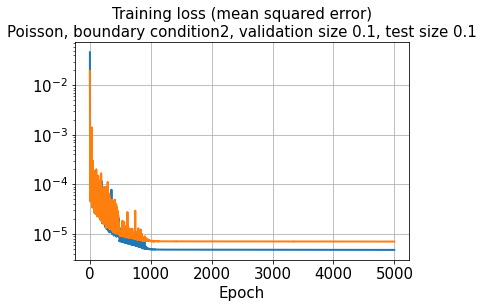

In [70]:
hist = history.history
plt.plot(hist['loss'], lw=2)
plt.plot(hist['val_loss'],lw=2)
plt.title('Training loss (mean squared error)\nPoisson, boundary condition2, validation size 0.1, test size 0.1', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
#plt.ylim([5e-5, 1e-1])
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

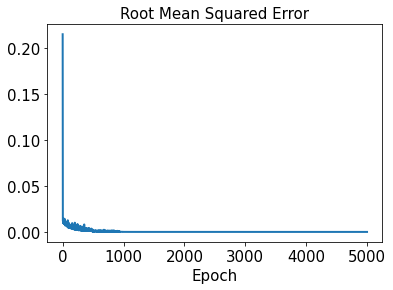

In [41]:
plt.plot(hist['rmse'], lw=2)
plt.title('Root Mean Squared Error', size=15)
plt.xlabel('Epoch', size=15)
plt.tick_params(axis='both', which='major', labelsize=15)
plt.show()

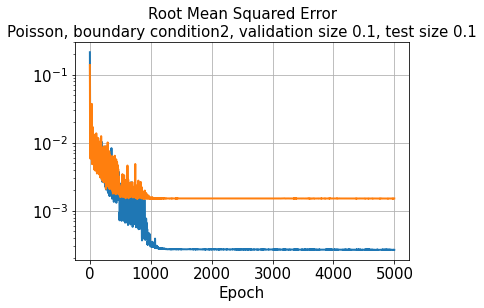

In [42]:
plt.plot(hist['rmse'], lw=2)
plt.plot(hist['val_rmse'], lw=2)
plt.title('Root Mean Squared Error\nPoisson, boundary condition2, validation size 0.1, test size 0.1', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

In [43]:
#with mirrored_strategy.scope():
test_results = model.evaluate(x_train)

54/54 [==============================] - 0s 3ms/step - loss: 4.6660e-06 - rmse: 0.0000e+00


In [44]:
#with mirrored_strategy.scope():
decoded_train = model.predict(x_train)

54/54 [==============================] - 1s 12ms/step


In [72]:
decoded_val = model.predict(x_val)

6/6 [==============================] - 0s 66ms/step


In [45]:
#with mirrored_strategy.scope():
decoded_test = model.predict(x_test)

7/7 [==============================] - 0s 10ms/step


In [46]:
error_train_abs = np.abs(decoded_train - y_train)

In [73]:
error_val_abs = np.abs(decoded_val - y_val)

In [47]:
error_test_abs = np.abs(decoded_test - y_test)

In [52]:
os.chdir("D:\\TrainedModels\\20221030")
model.save('Poisson_bc2_100kernel_2by2MaxPooling_2CNNlayer_valSize0.1testSize0.1.h5',
           overwrite=True, include_optimizer=True, save_format='h5')

In [53]:
l2_error_train = np.sqrt(np.sum((decoded_train - y_train)**2) / np.sum(y_train**2))
print(l2_error_train)

0.00039704175589755646


In [74]:
l2_error_val = np.sqrt(np.sum((decoded_val - y_val)**2) / np.sum(y_val**2))
print(l2_error_val)

0.002270167074884386


In [54]:
l2_error_test = np.sqrt(np.sum((decoded_test - y_test)**2) / np.sum(y_test**2))
print(l2_error_test)

0.004762432491348763


In [55]:
l2_error_train_list = []
for i in range(0, len(aa_train)):
    l2_error_train_data = np.sqrt(np.sum((decoded_train[i] - y_train[i])**2) / np.sum(y_train[i]**2))
    l2_error_train_list.append(l2_error_train_data)
#print(l2_error_train_list)

In [75]:
l2_error_val_list = []
for i in range(0, len(aa_val)):
    l2_error_val_data = np.sqrt(np.sum((decoded_val[i] - y_val[i])**2) / np.sum(y_val[i]**2))
    l2_error_val_list.append(l2_error_val_data)

In [56]:
l2_error_test_list = []
for i in range(0, len(aa_test)):
    l2_error_test_data = np.sqrt(np.sum((decoded_test[i] - y_test[i])**2) / np.sum(y_test[i]**2))
    l2_error_test_list.append(l2_error_test_data)
#print(l2_error_test_list)

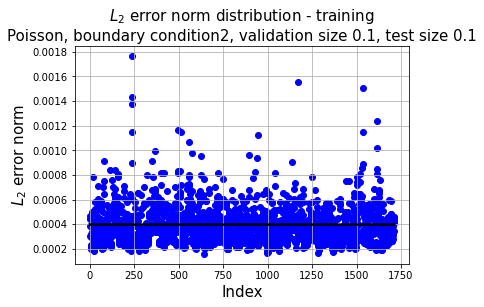

In [76]:
plt.plot(np.linspace(1, aa_train.shape[0], aa_train.shape[0]),
         l2_error_train*np.ones(aa_train.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_train.shape[0], aa_train.shape[0]), l2_error_train_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - training\nPoisson, boundary condition2, validation size 0.1, test size 0.1',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(training).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

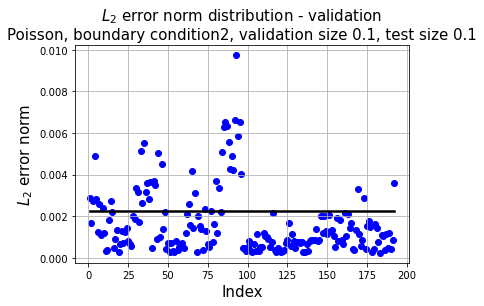

In [77]:
plt.plot(np.linspace(1, aa_val.shape[0], aa_val.shape[0]),
         l2_error_val*np.ones(aa_val.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_val.shape[0], aa_val.shape[0]), l2_error_val_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - validation\nPoisson, boundary condition2, validation size 0.1, test size 0.1',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(validation).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

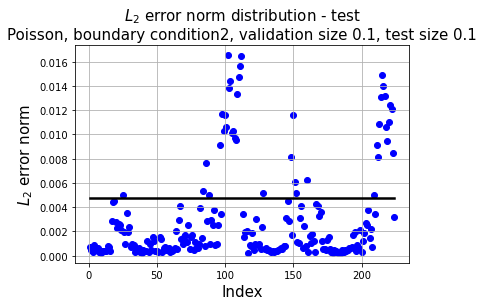

In [78]:
plt.plot(np.linspace(1, aa_test.shape[0], aa_test.shape[0]),
         l2_error_test*np.ones(aa_test.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_test.shape[0], aa_test.shape[0]), l2_error_test_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - test\nPoisson, boundary condition2, validation size 0.1, test size 0.1',
          fontsize=15)
plt.grid()
save_test_name = "20221030L2ErrorDistribution_Poisson_bc2(test).jpg"
plt.savefig(save_test_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

In [79]:
os.chdir("D:\\CNN_poisson_files\\images\\20221030\\valSize0.1TestSize0.1")

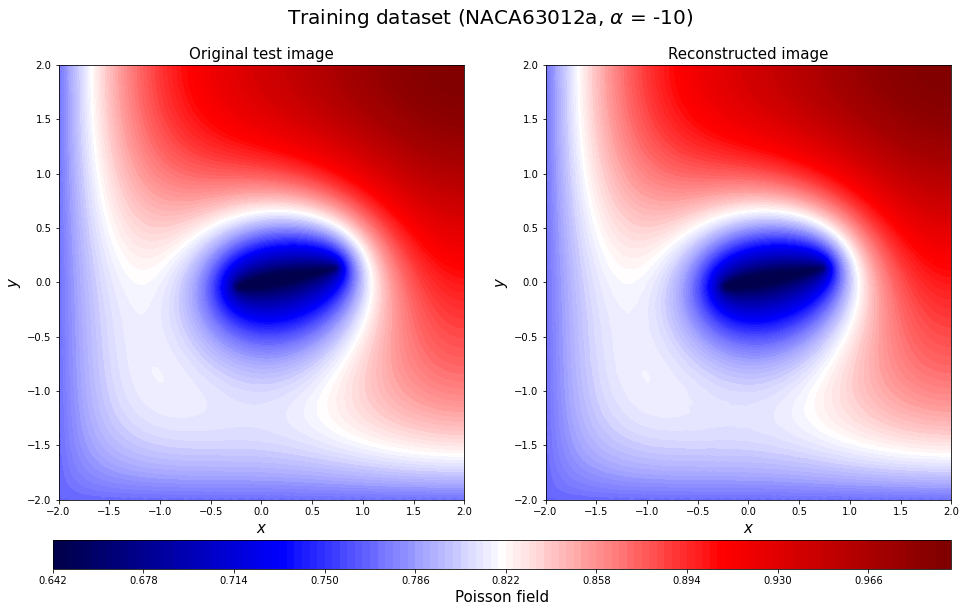

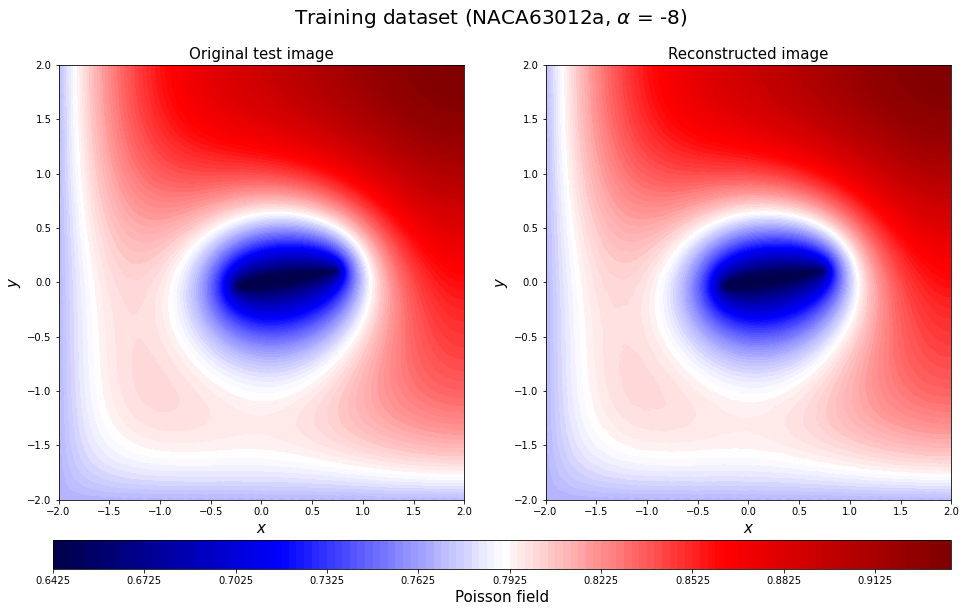

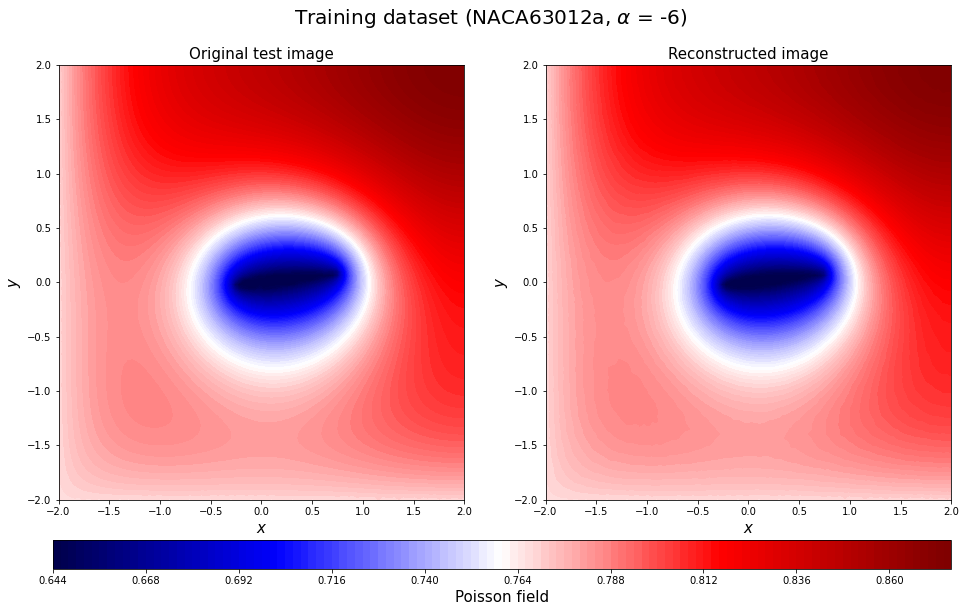

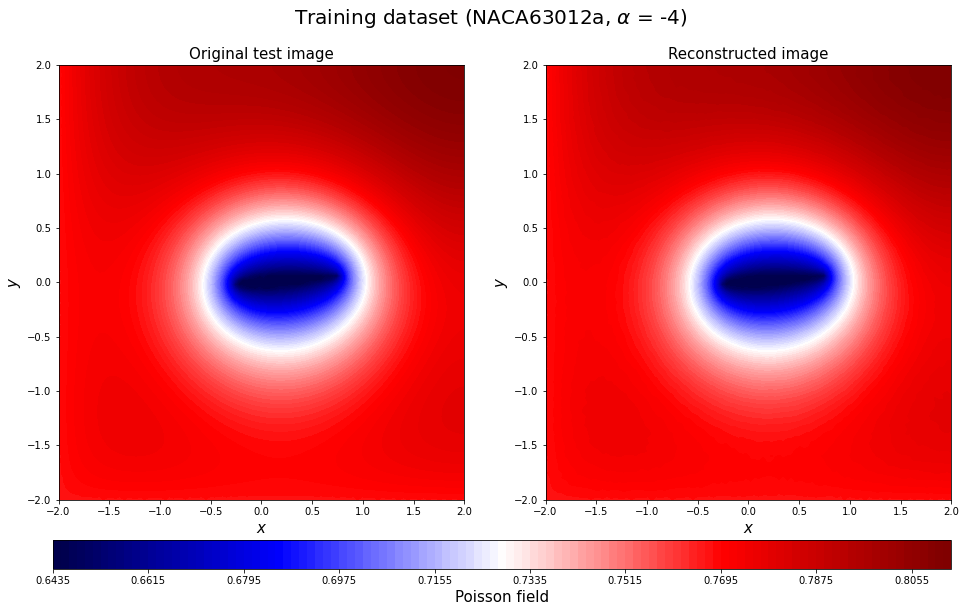

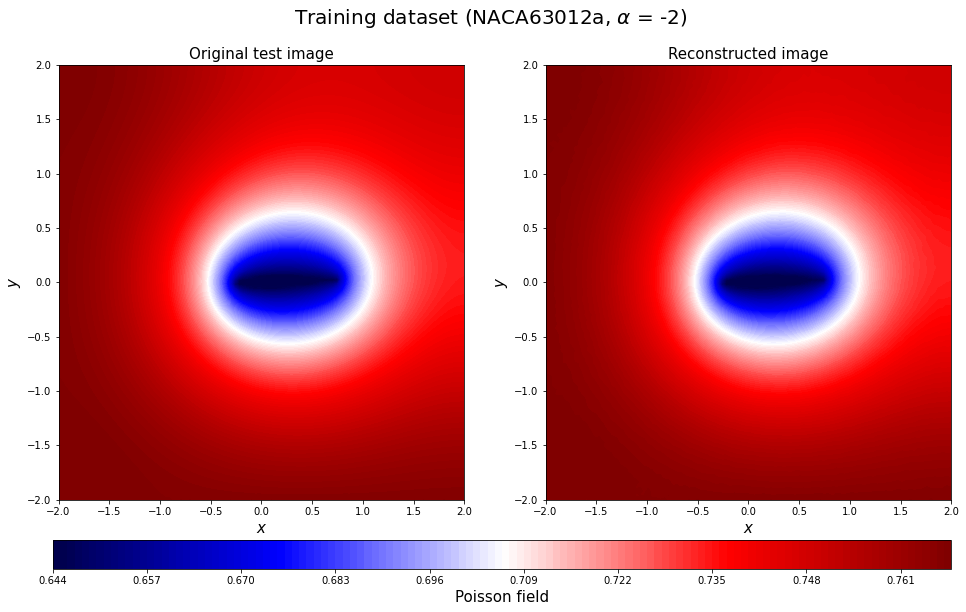

...

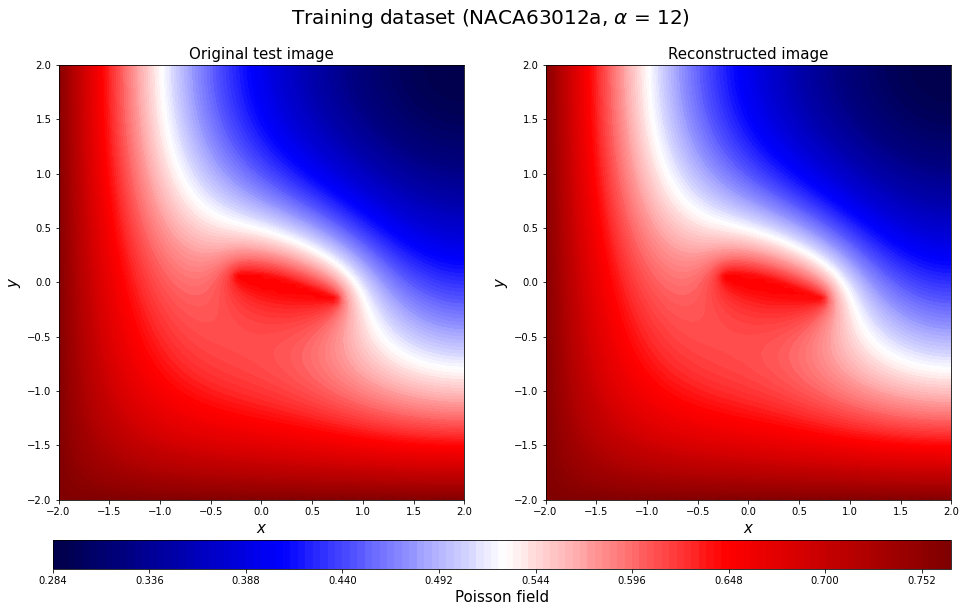

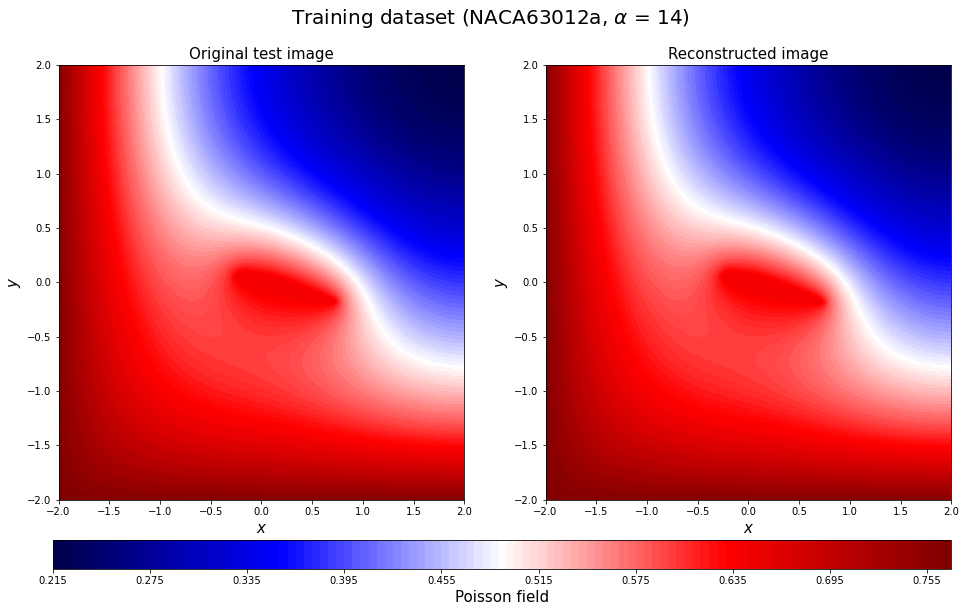

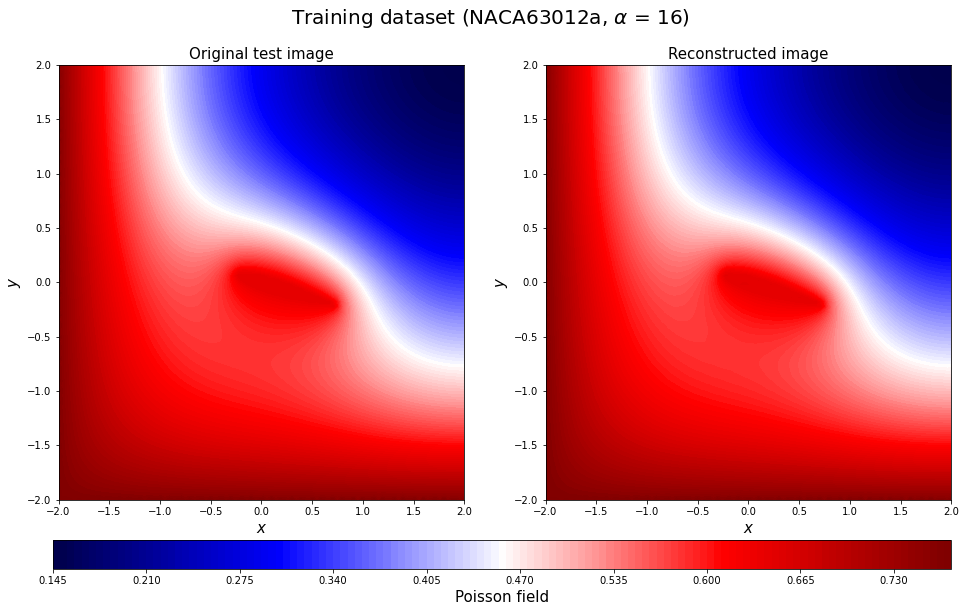

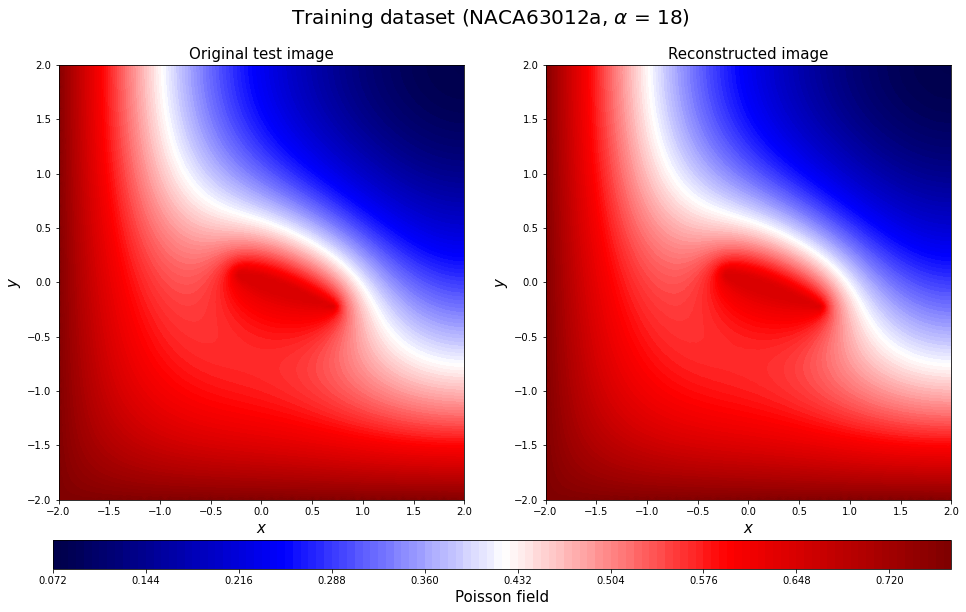

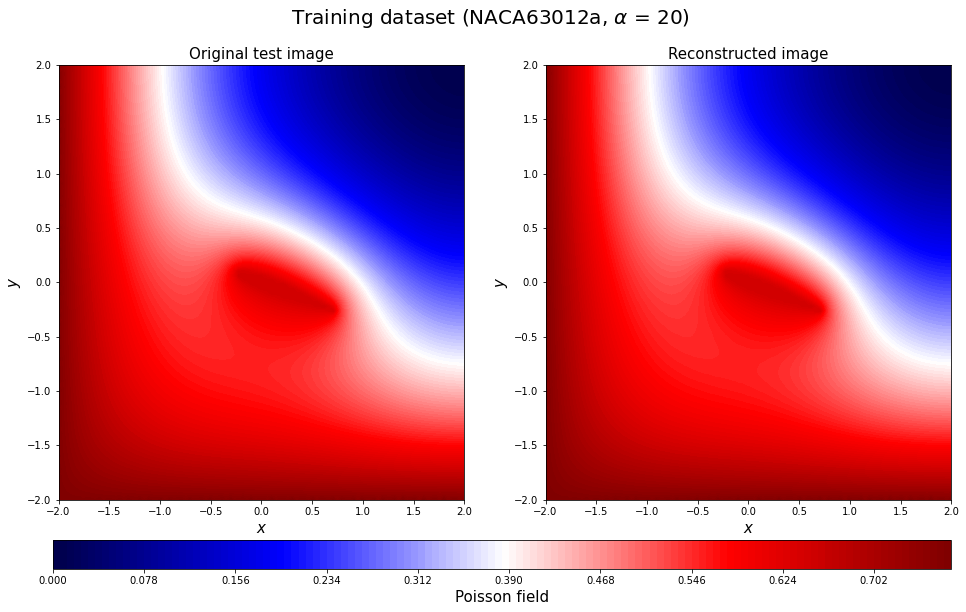

In [80]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train0_rotate = y_train[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train0_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[c])[3:-2], aa_train[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

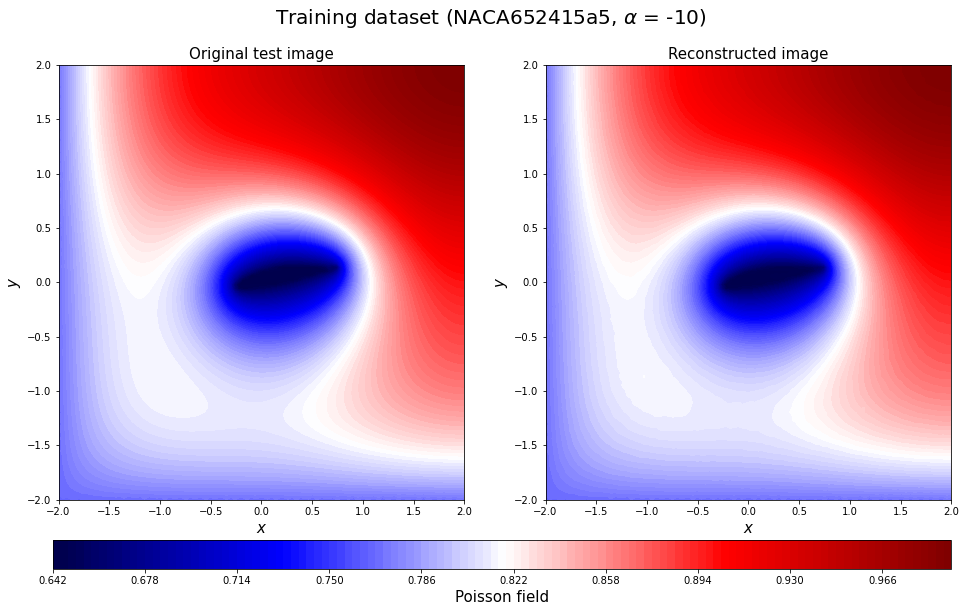

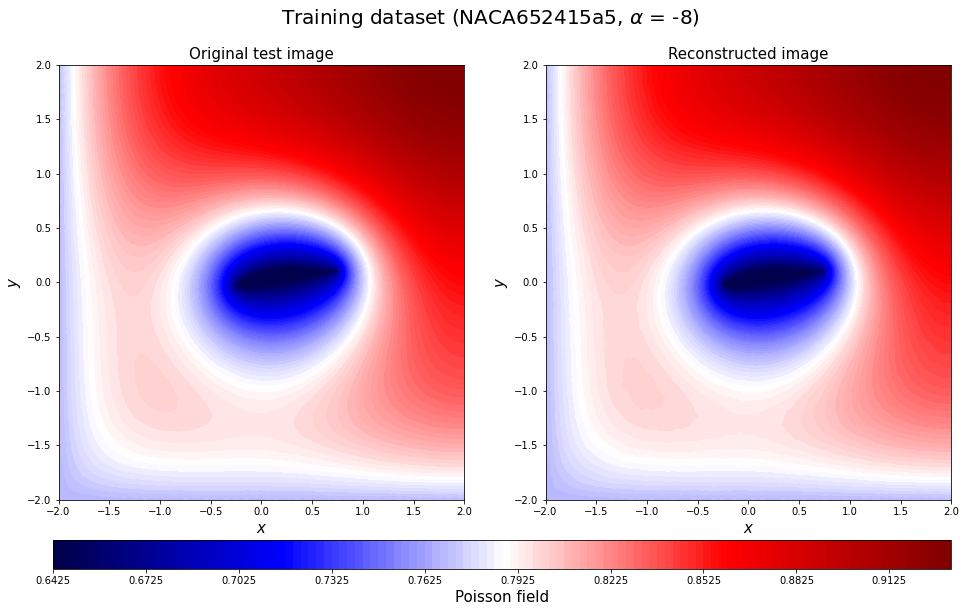

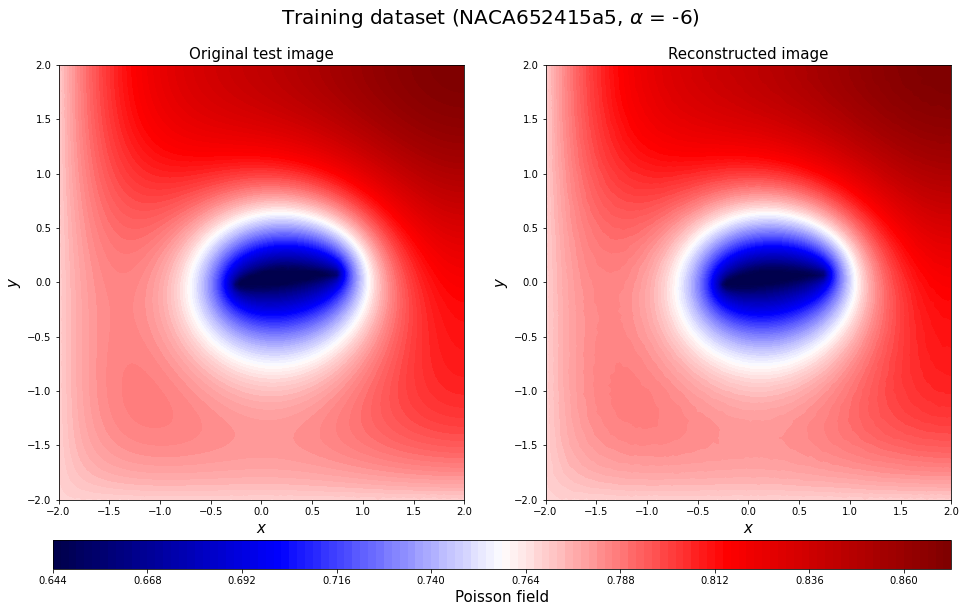

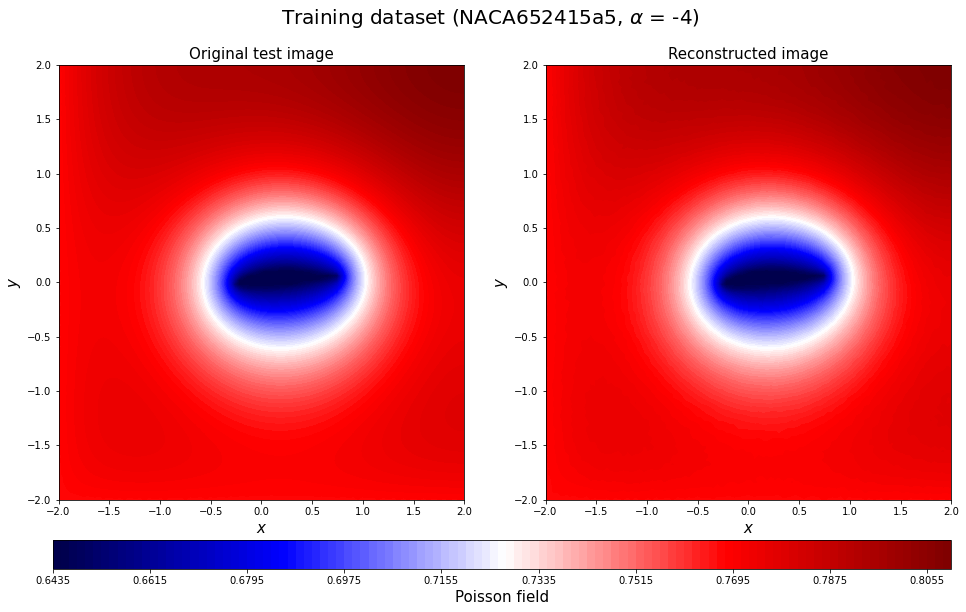

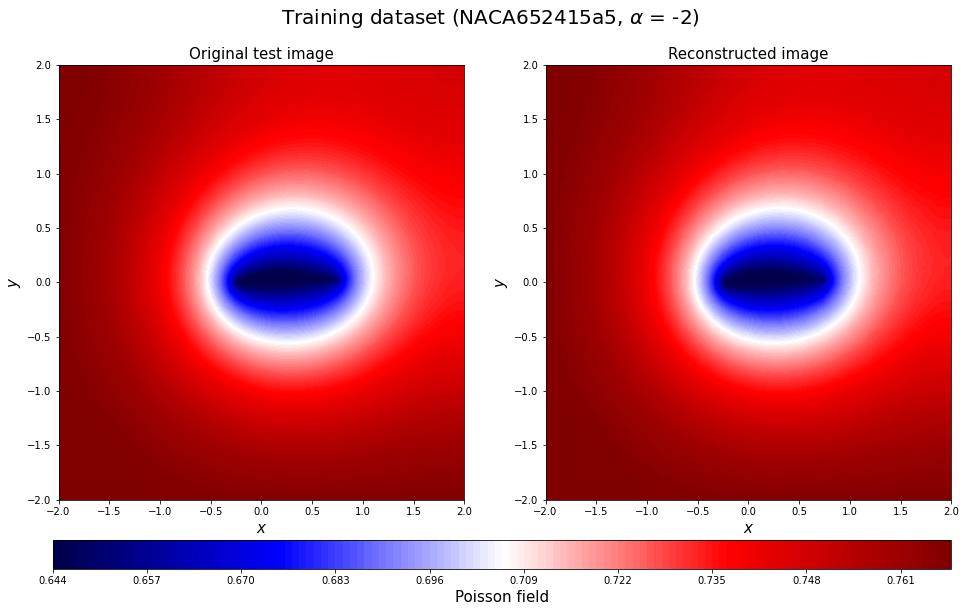

...

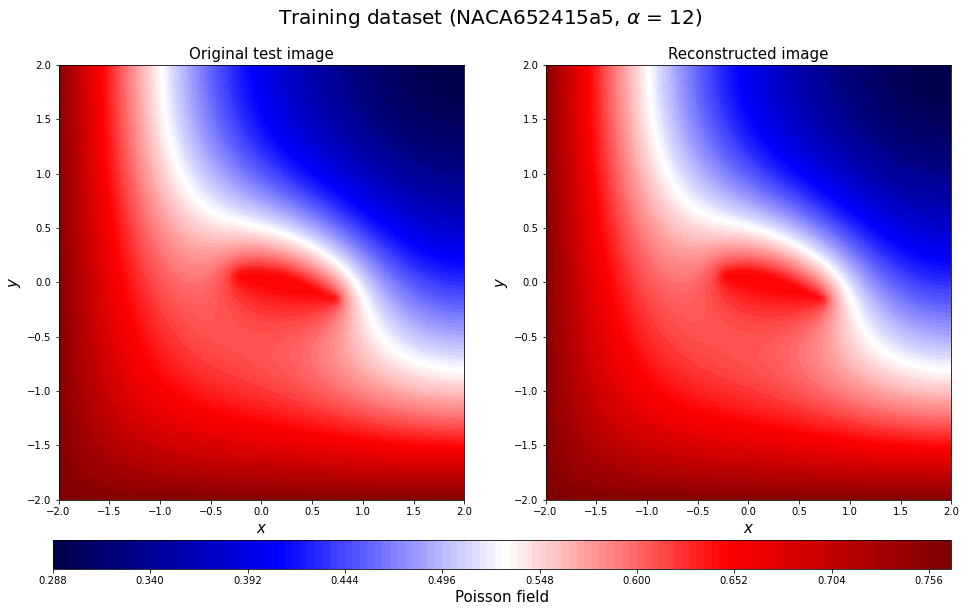

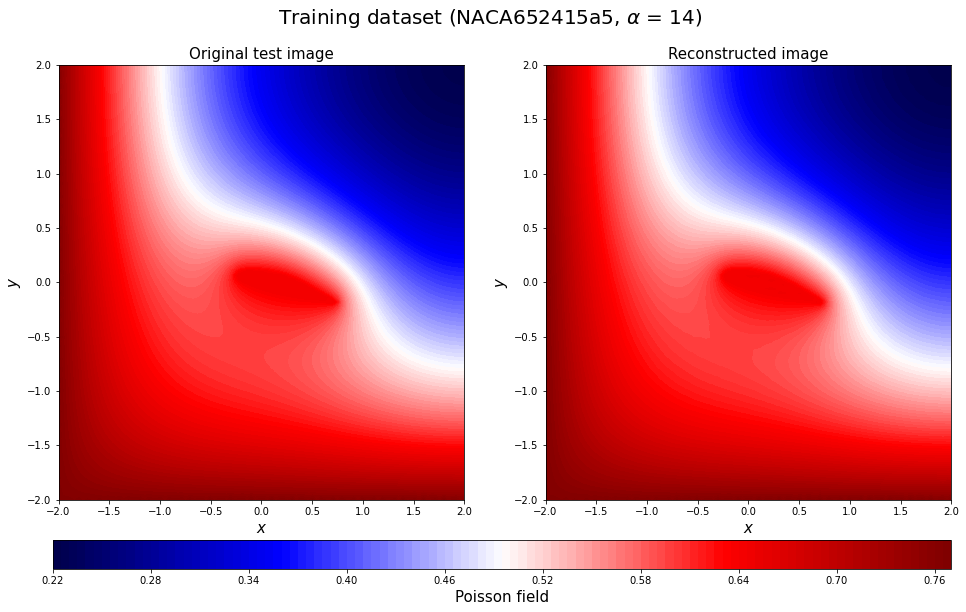

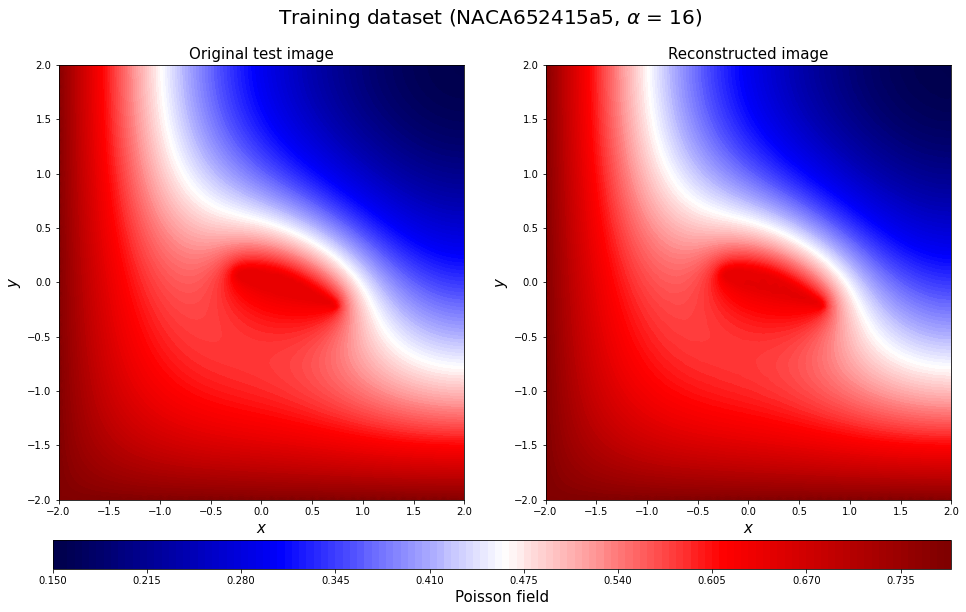

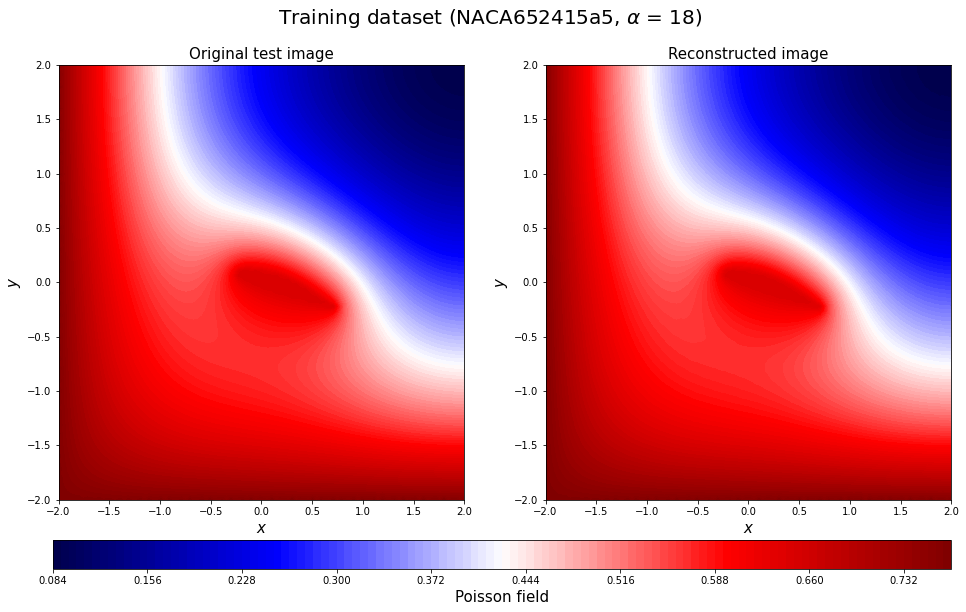

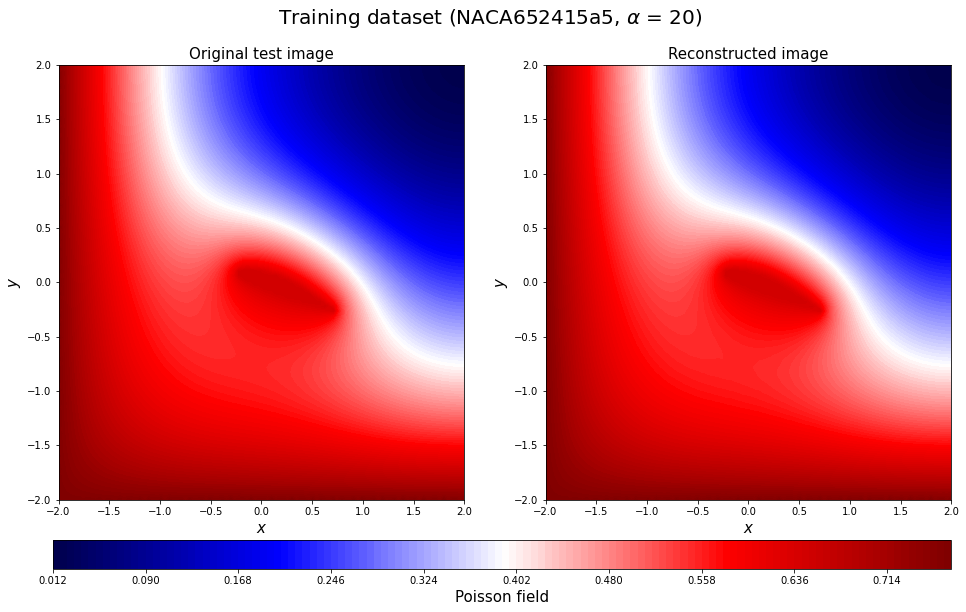

In [81]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train20_rotate = y_train[20*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[20*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train20_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[20*16+c])[3:-2], aa_train[20*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[20*16+c])[3:-2])+str(aa_train[20*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

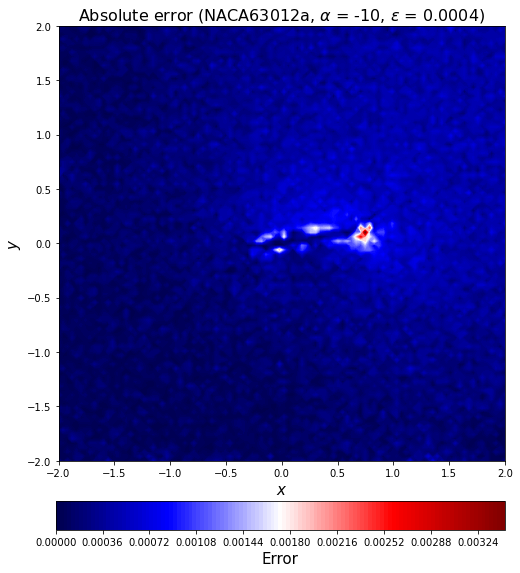

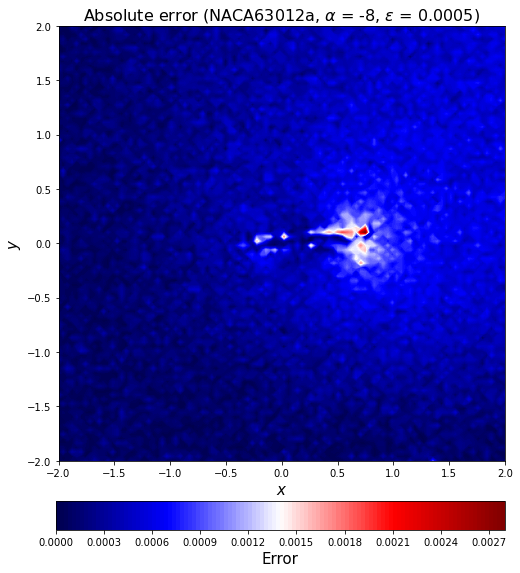

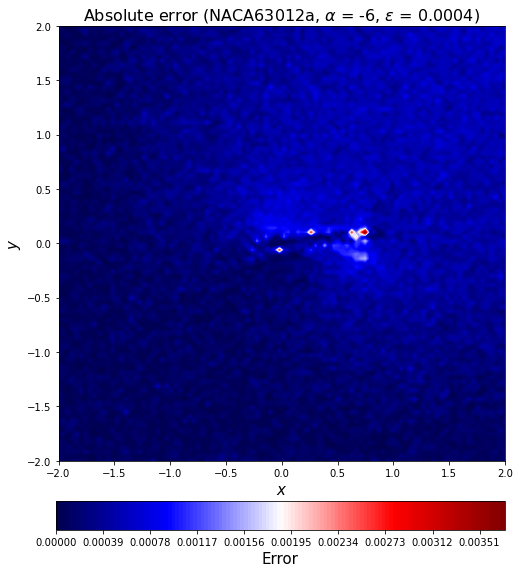

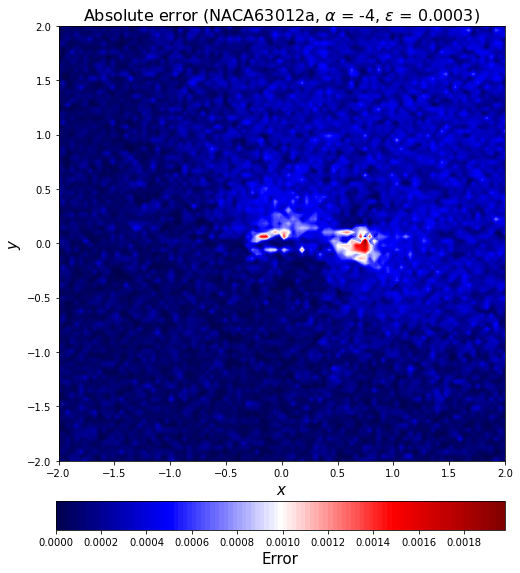

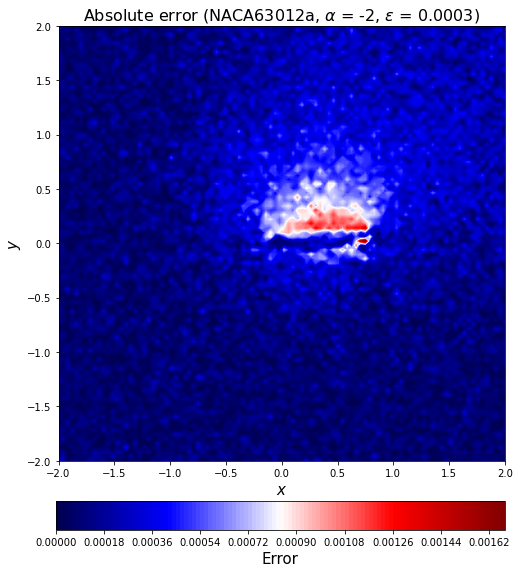

...

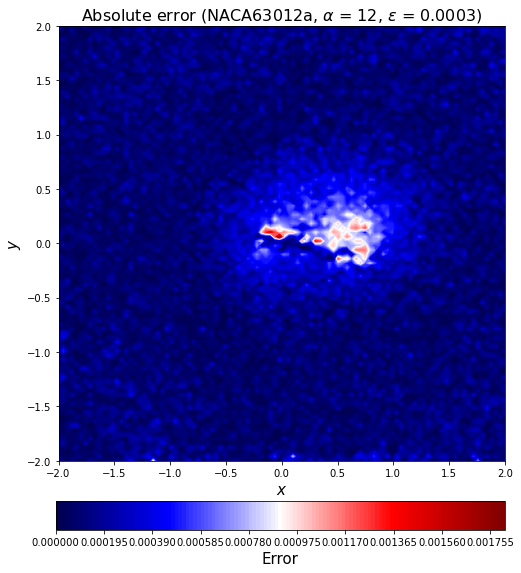

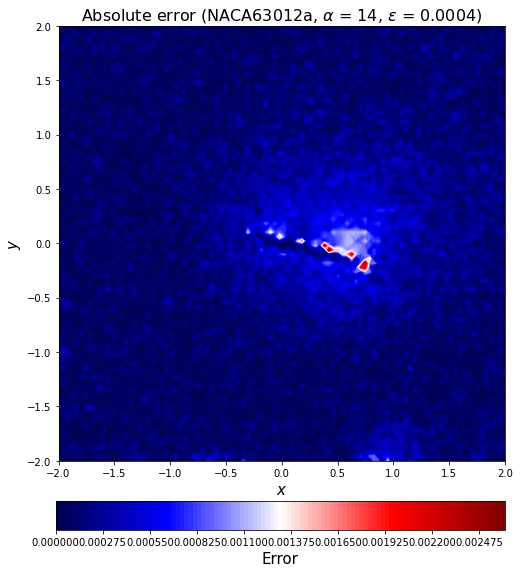

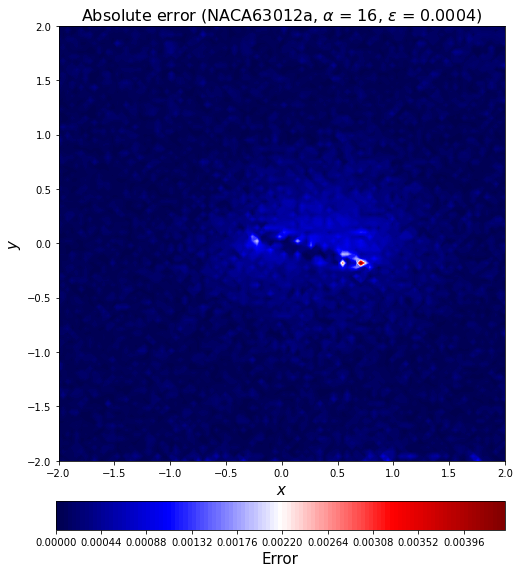

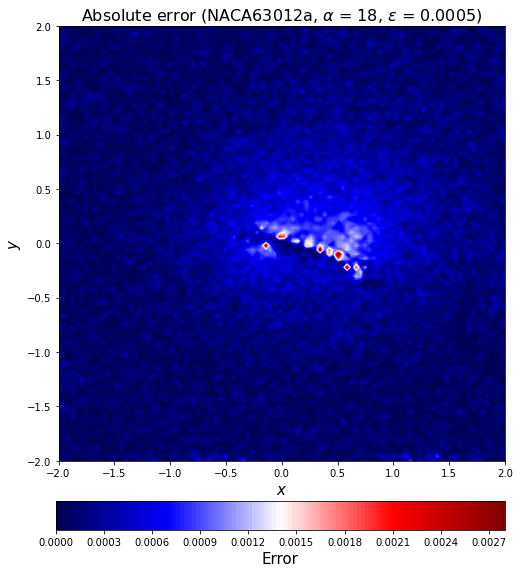

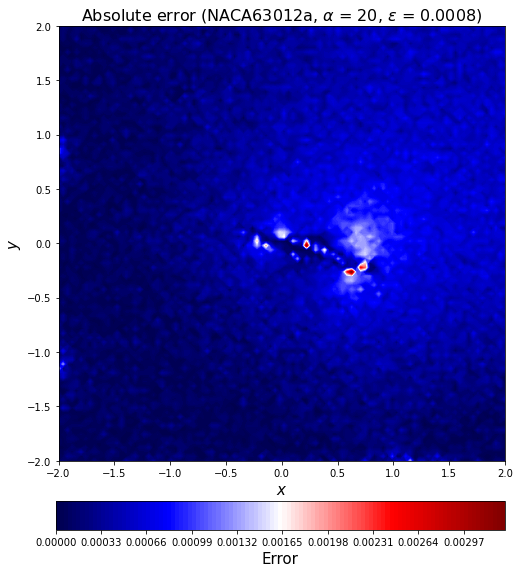

In [82]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[c])[3:-2],
                                                                             aa_train[c], l2_error_train_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])[3:-2]+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

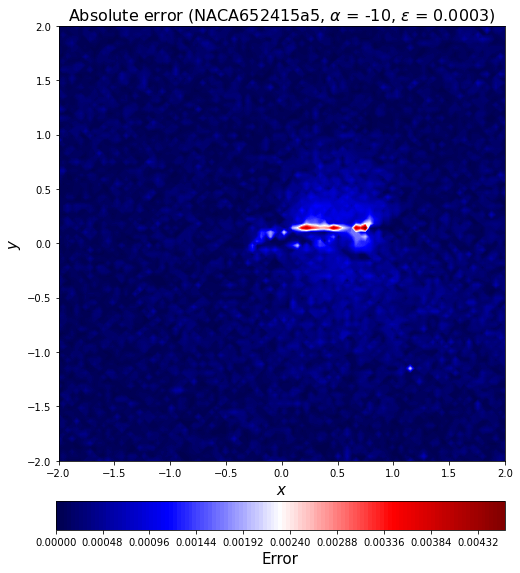

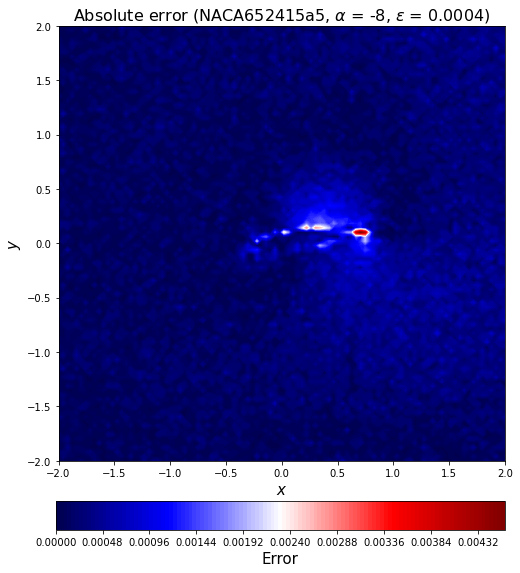

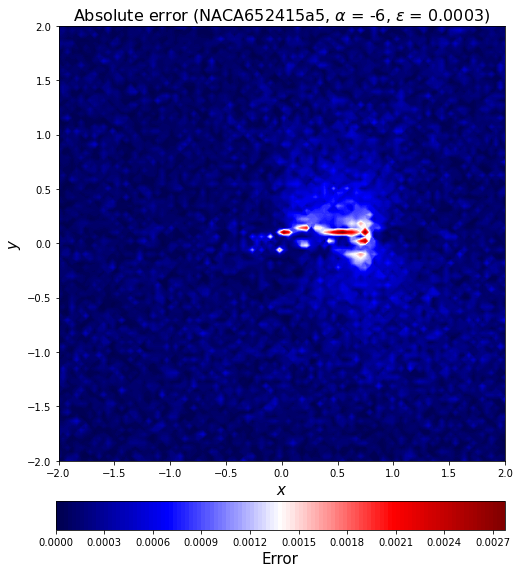

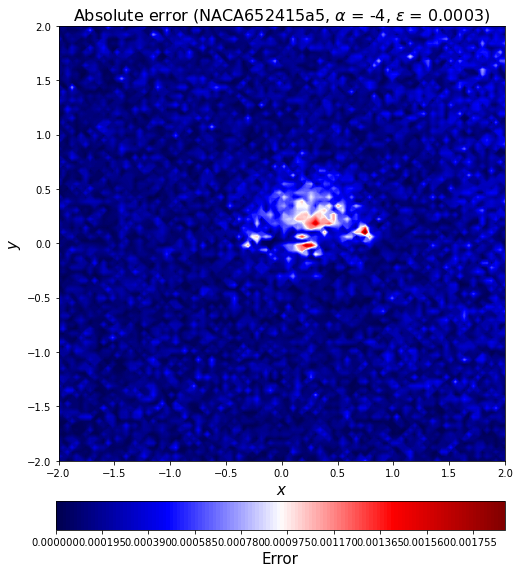

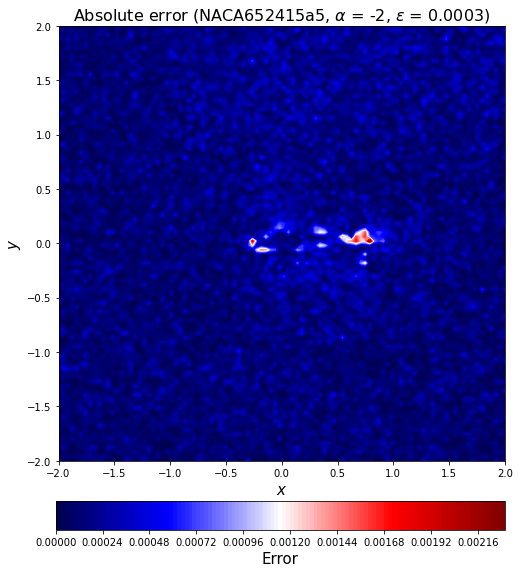

...

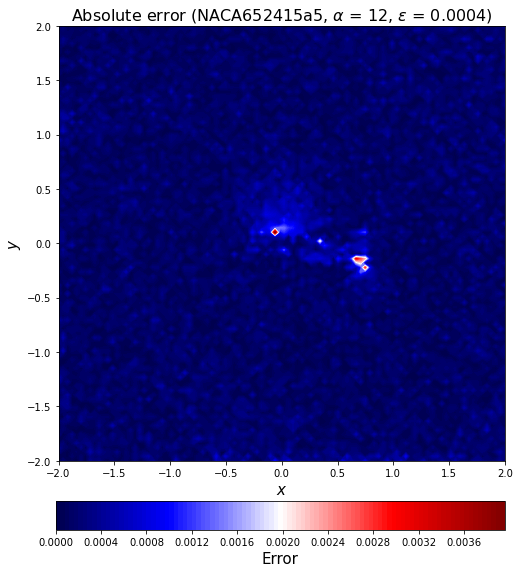

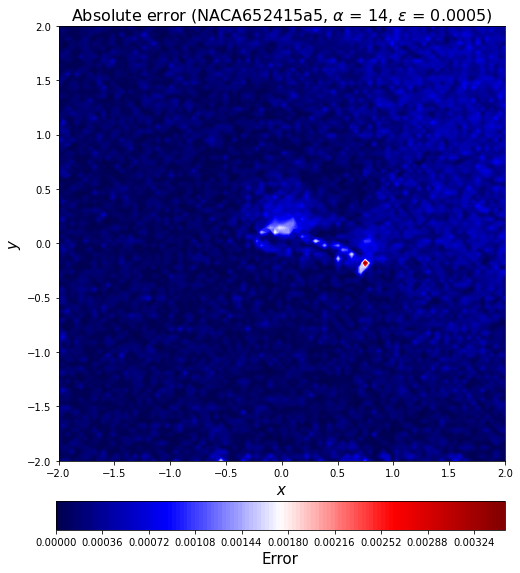

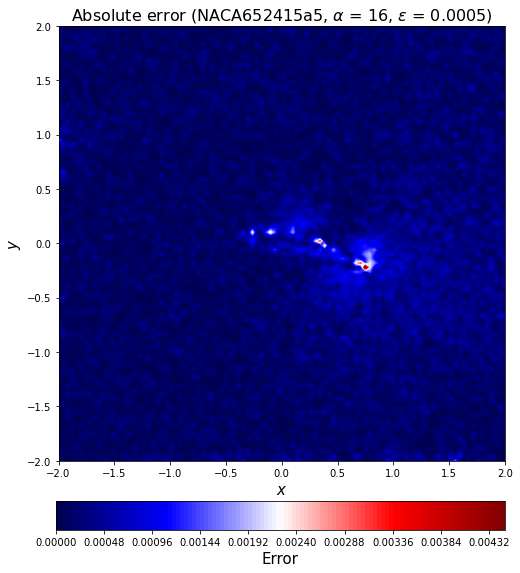

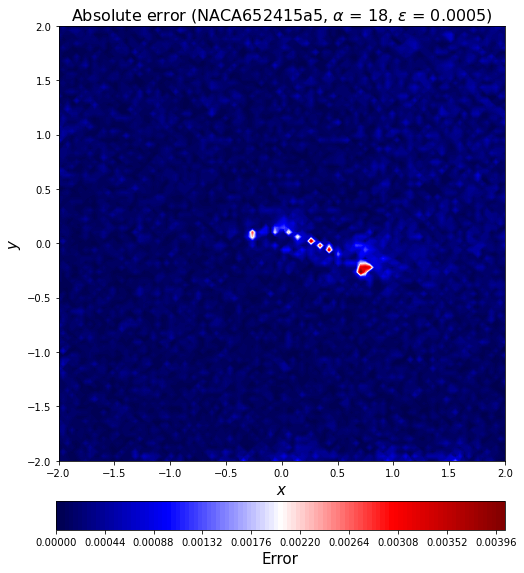

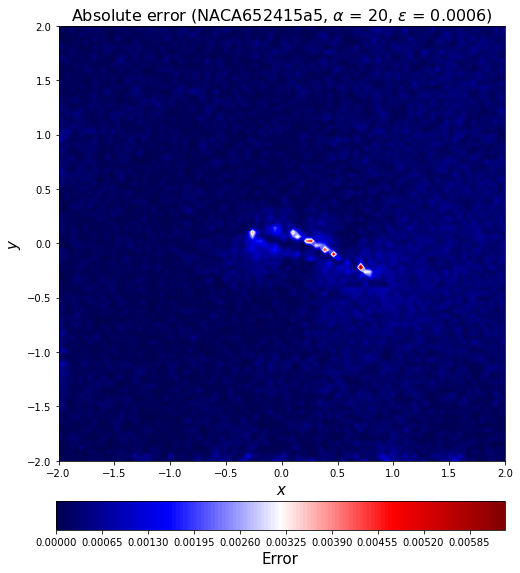

In [83]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[16*20+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[16*20+c])[3:-2],
                                                                             aa_train[16*20+c], l2_error_train_list[16*20+c]),fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[16*20+c])[3:-2])+str(aa_train[16*20+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

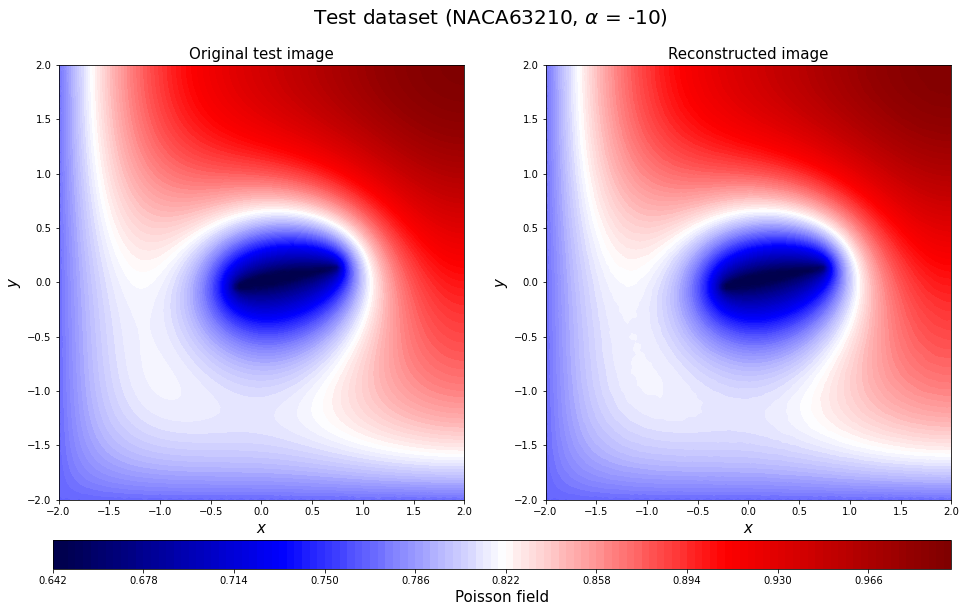

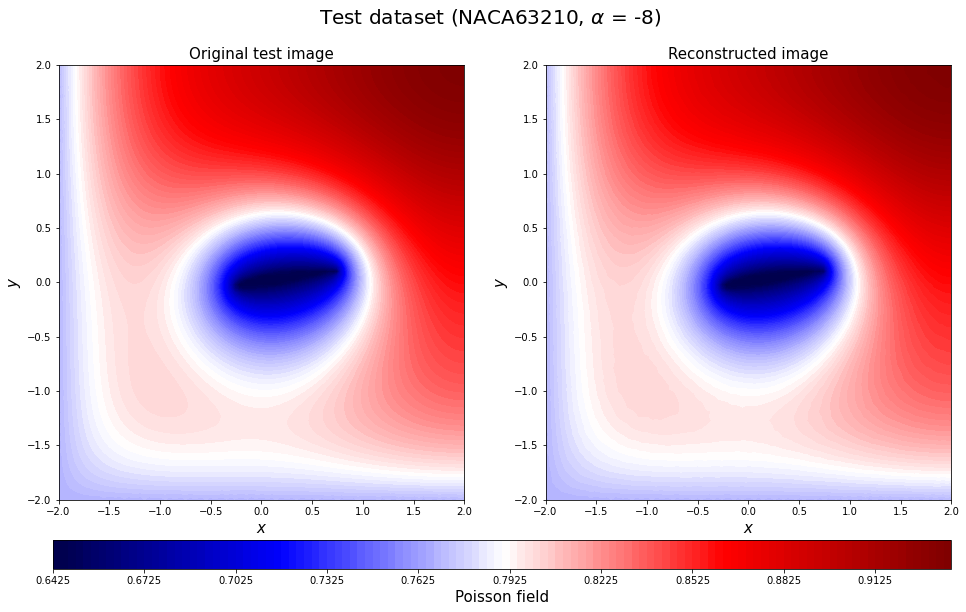

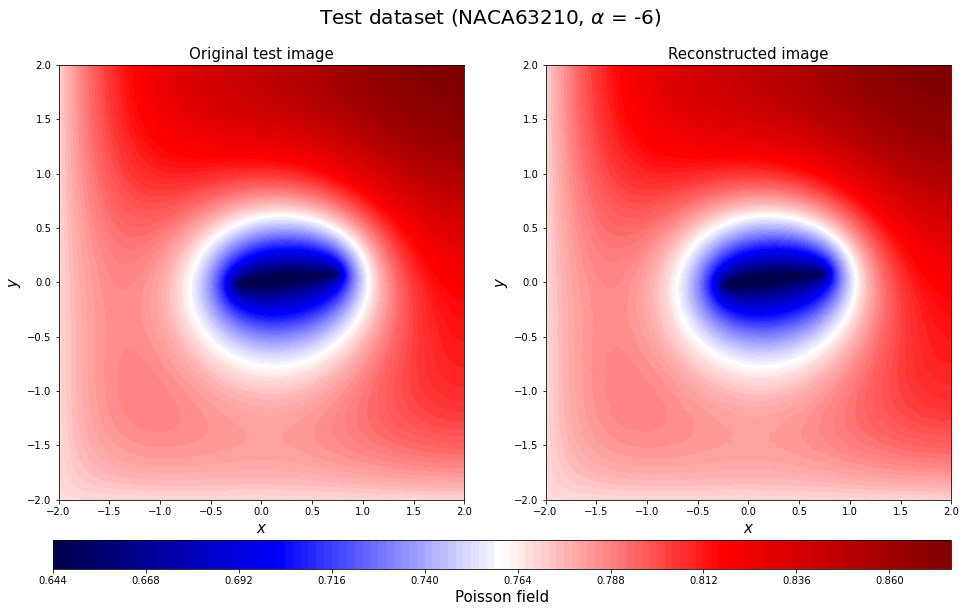

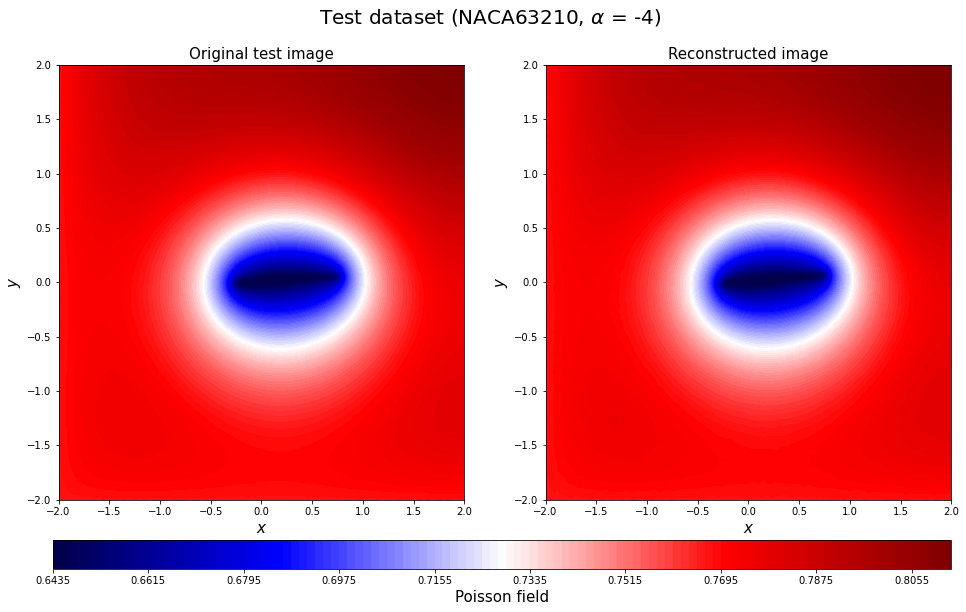

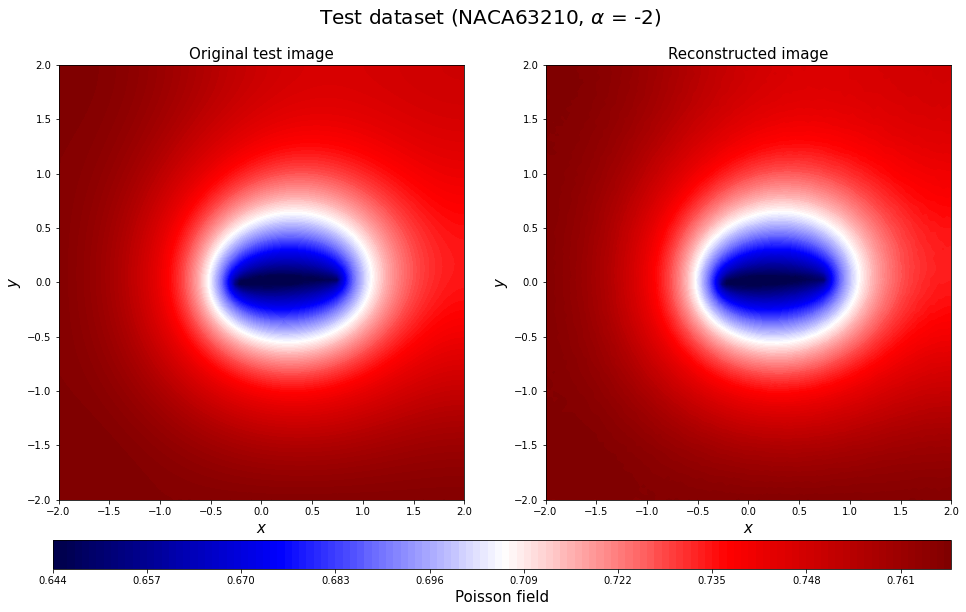

...

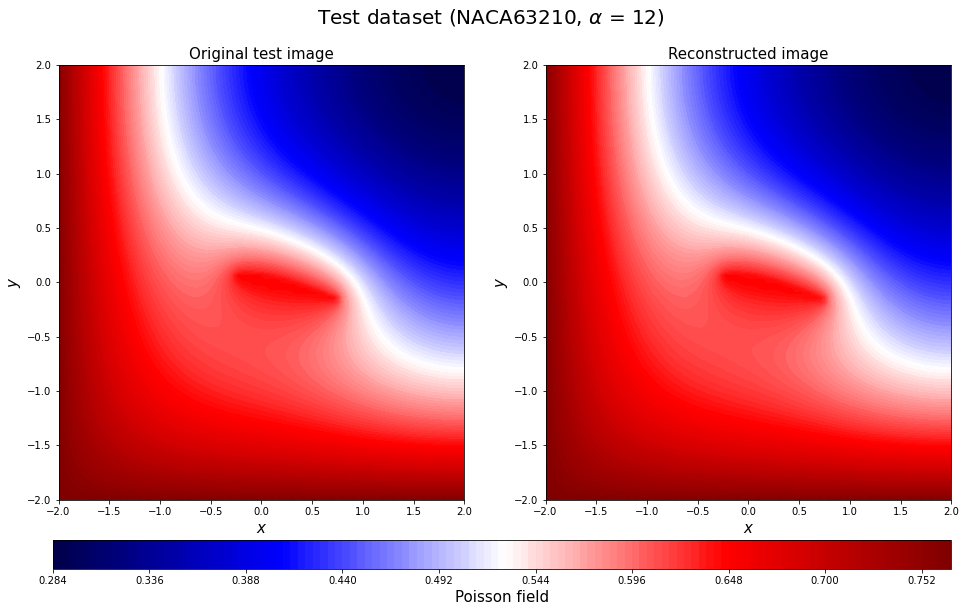

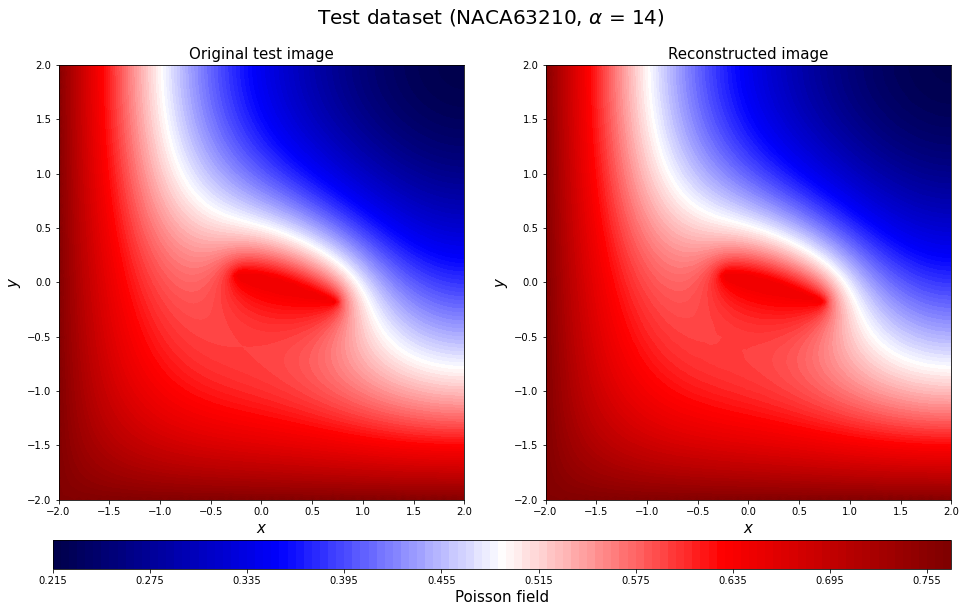

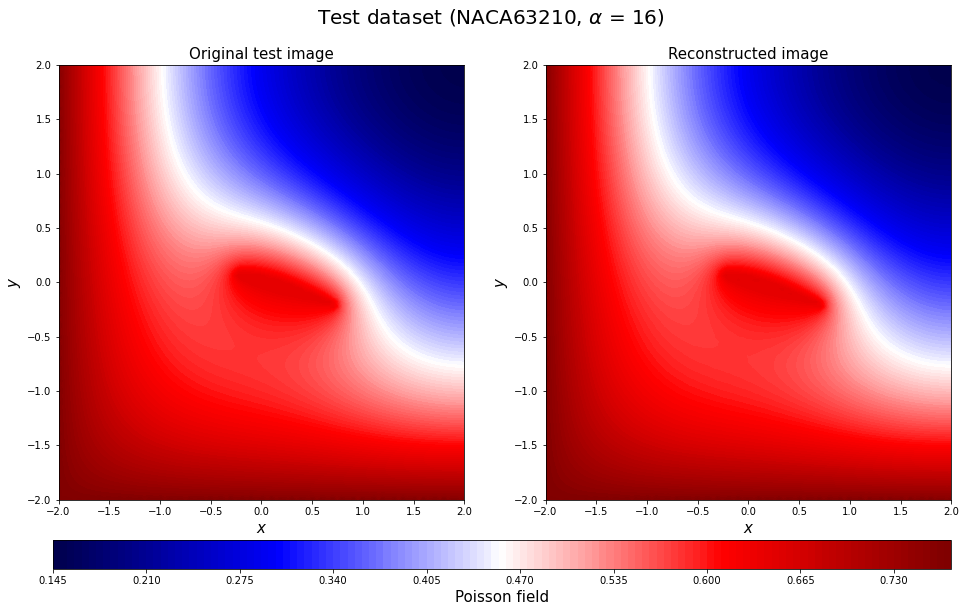

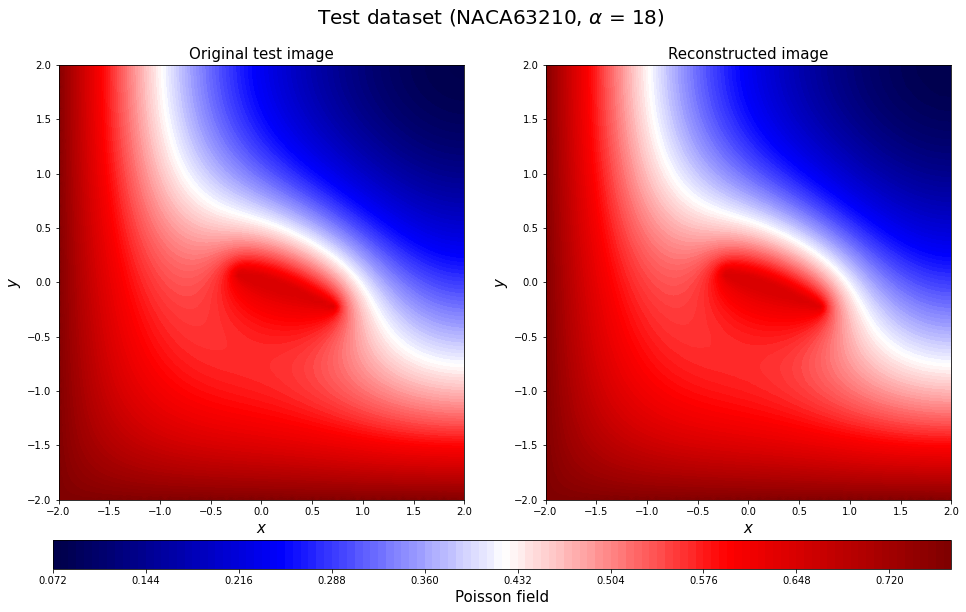

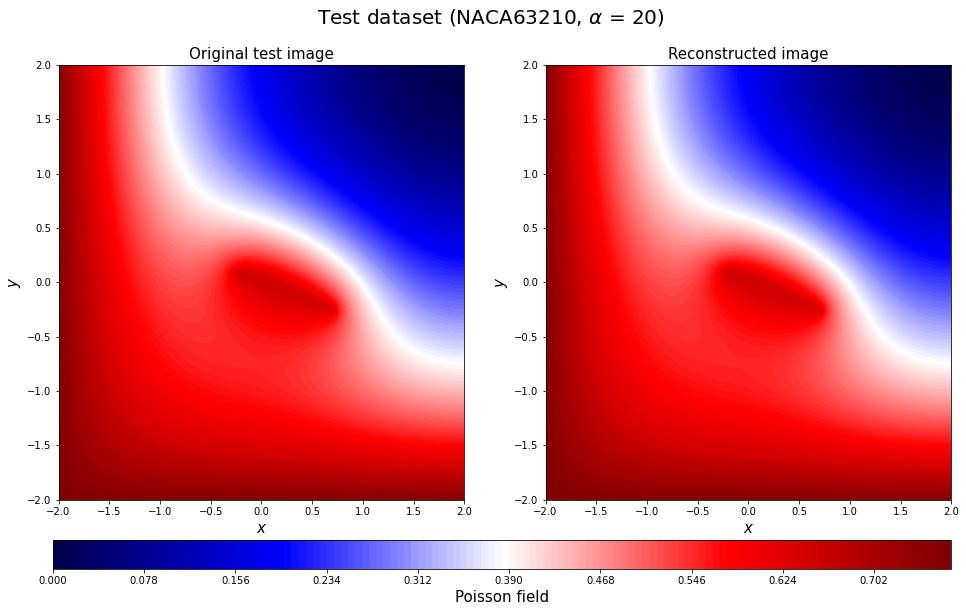

In [84]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test2_rotate = y_test[2*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[2*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test2_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[2*16+c])[3:-2], aa_test[2*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

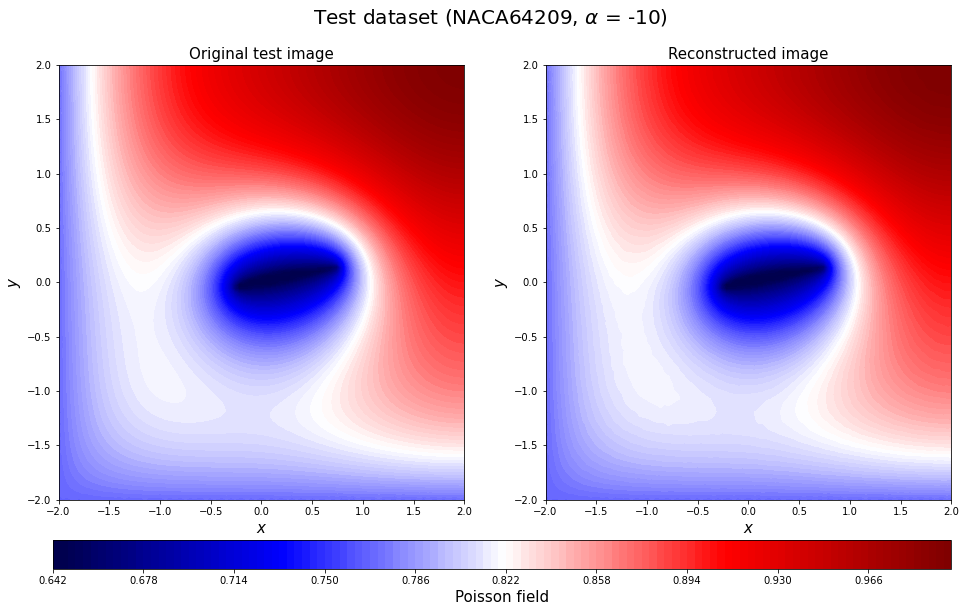

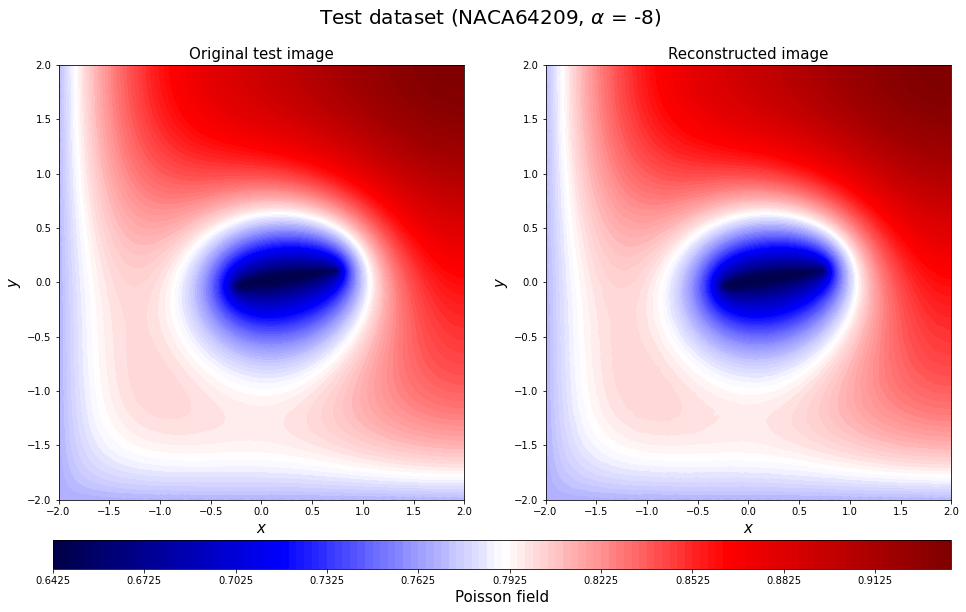

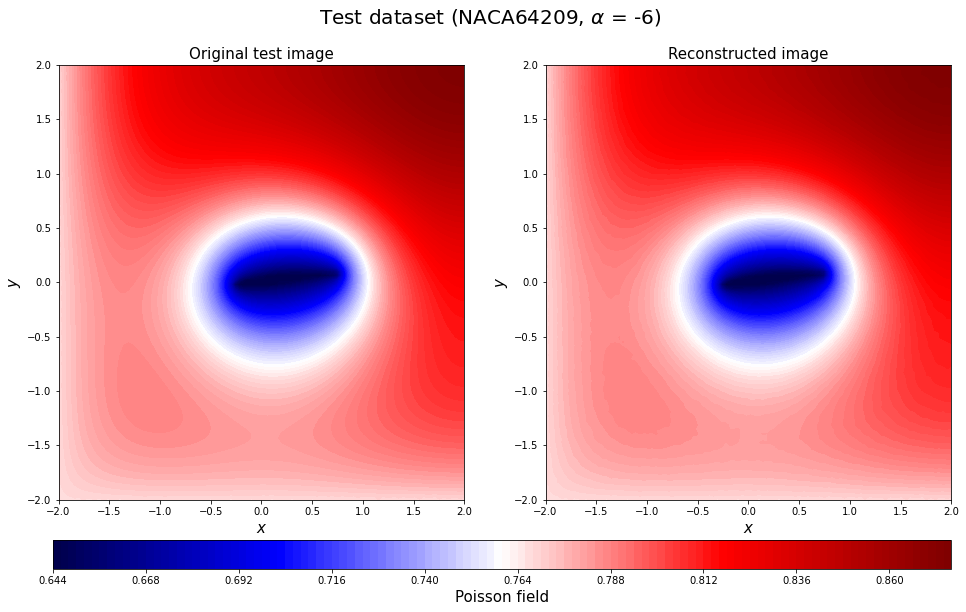

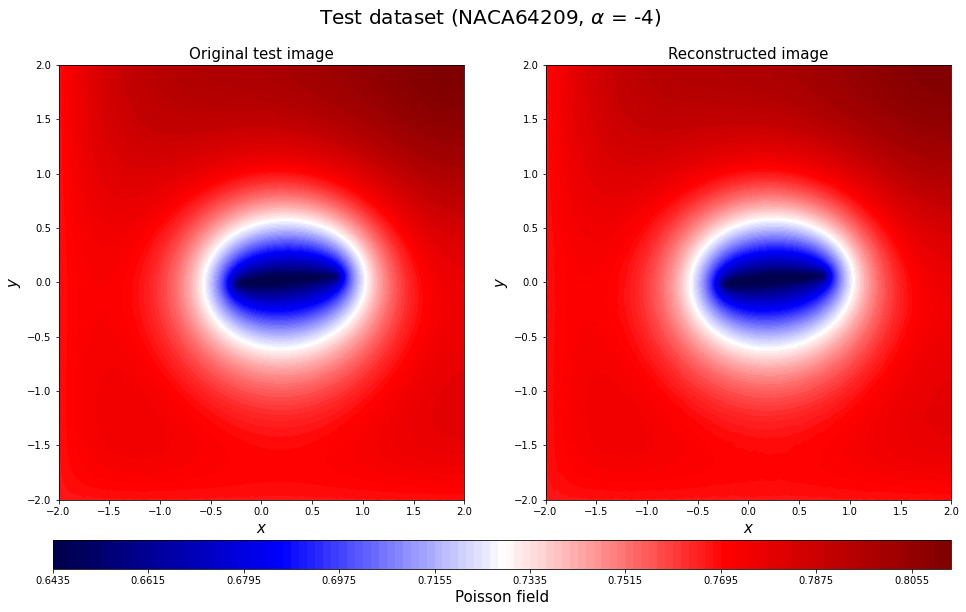

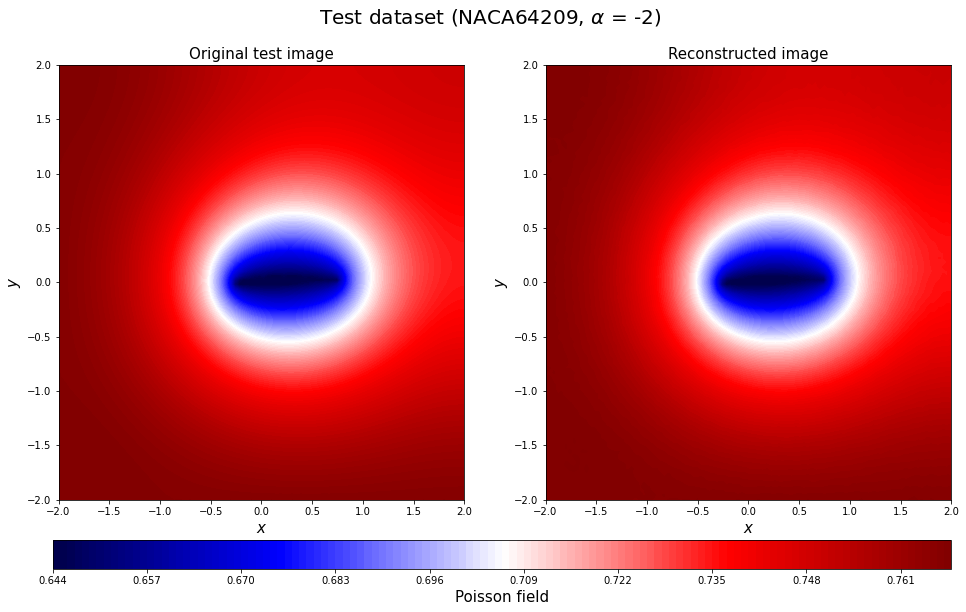

...

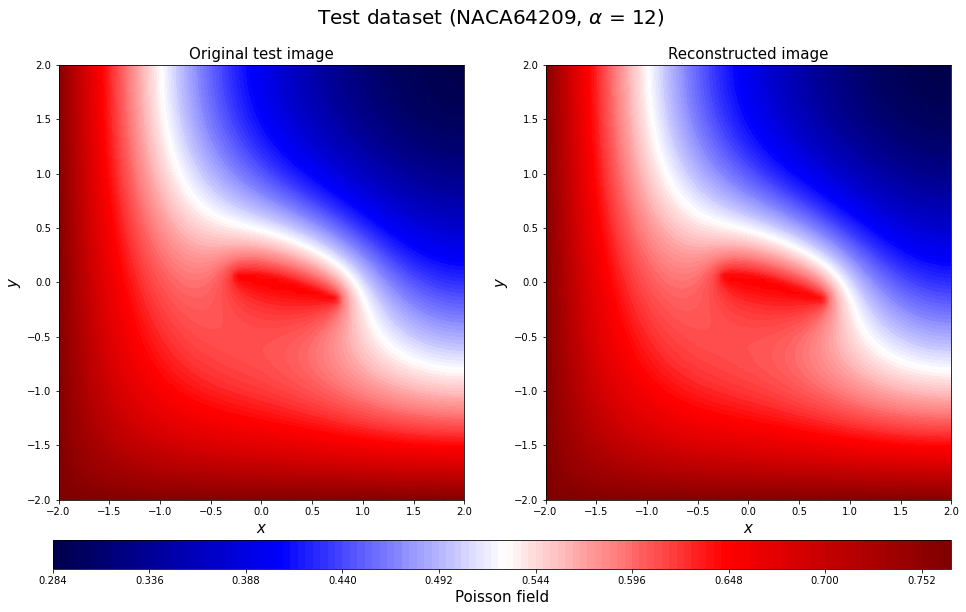

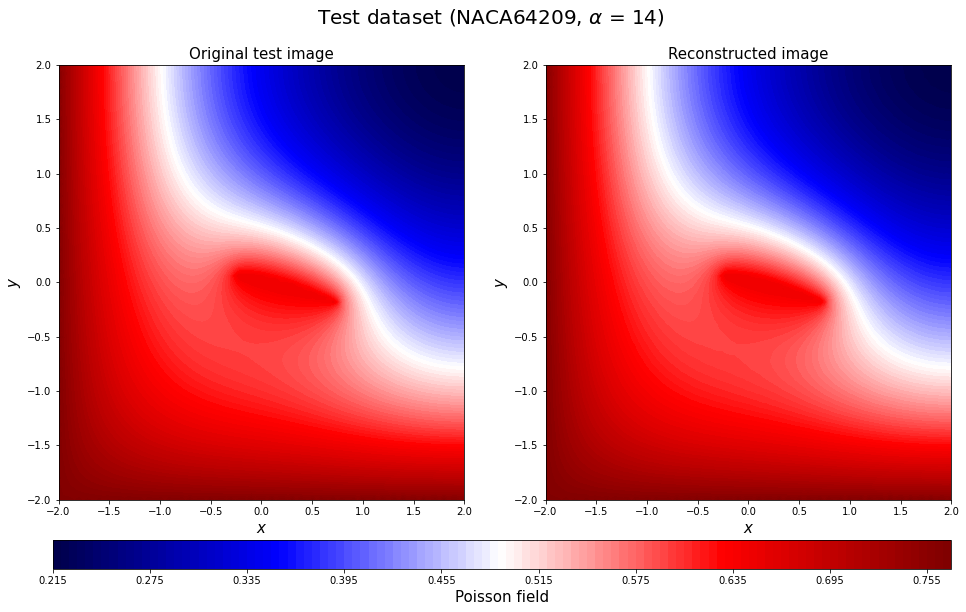

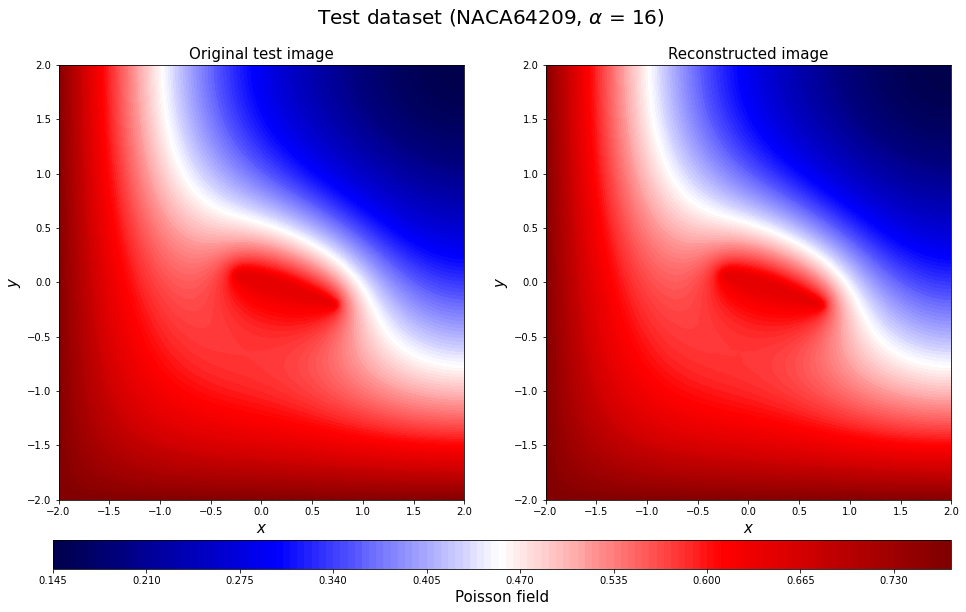

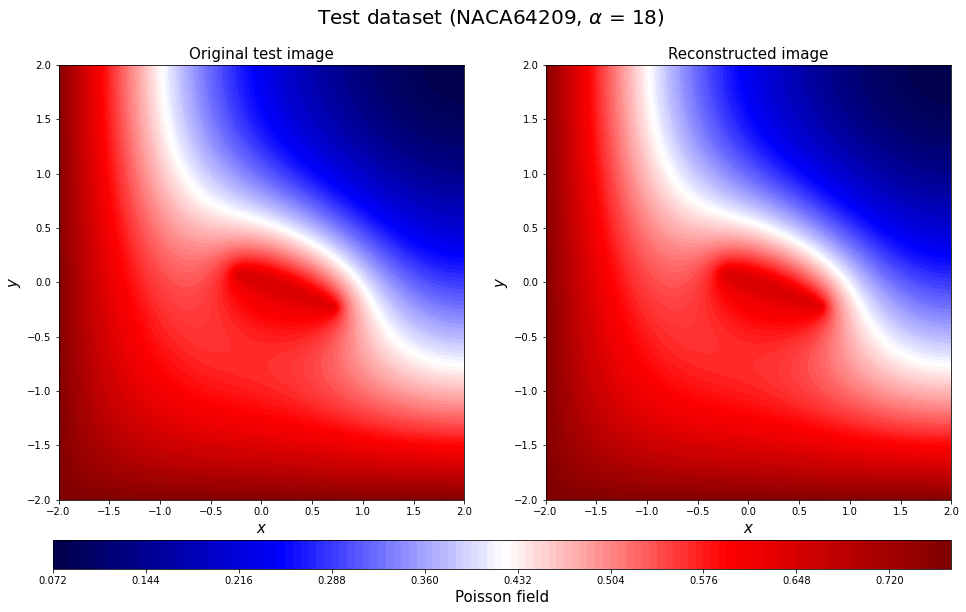

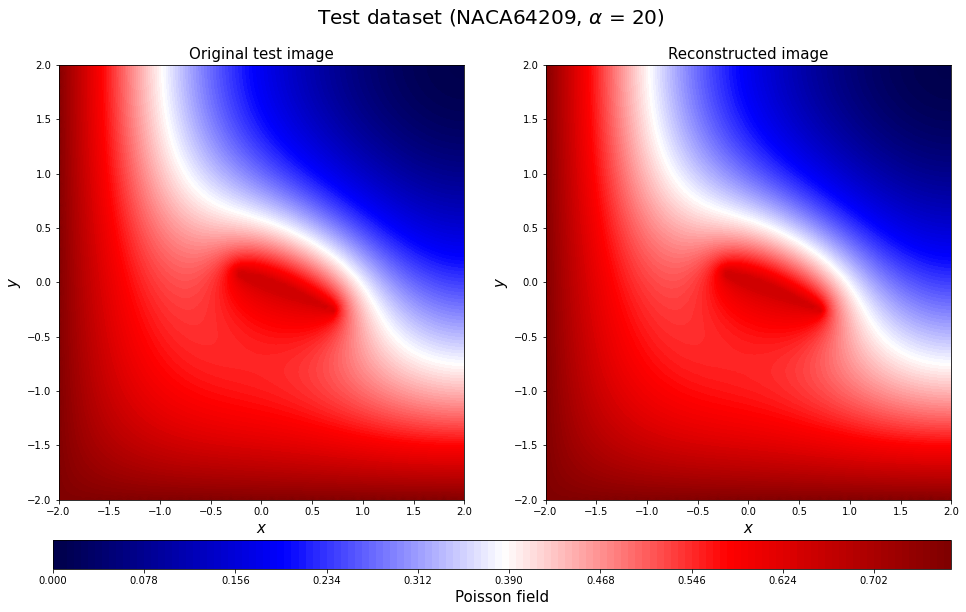

In [85]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

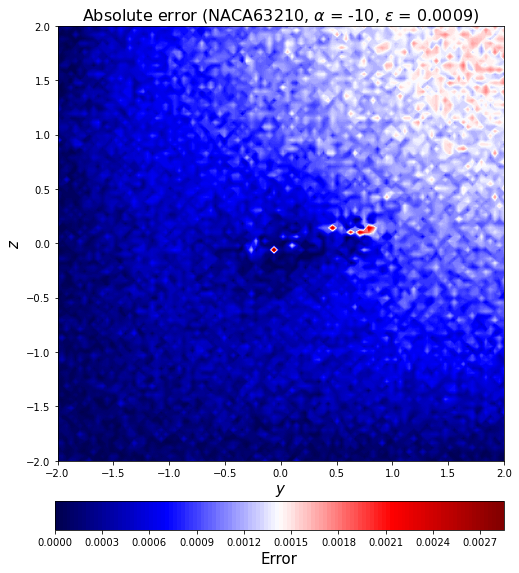

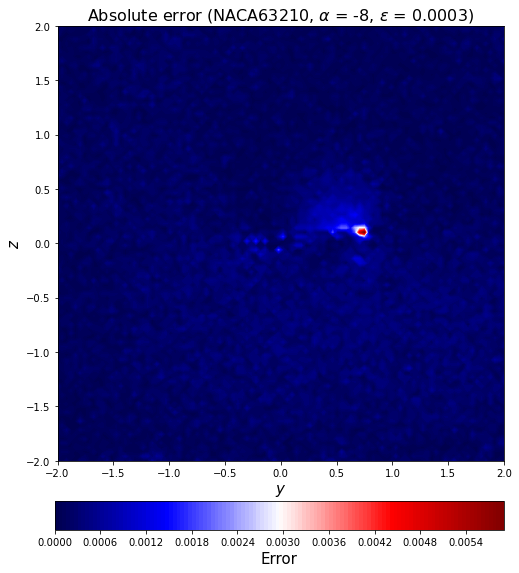

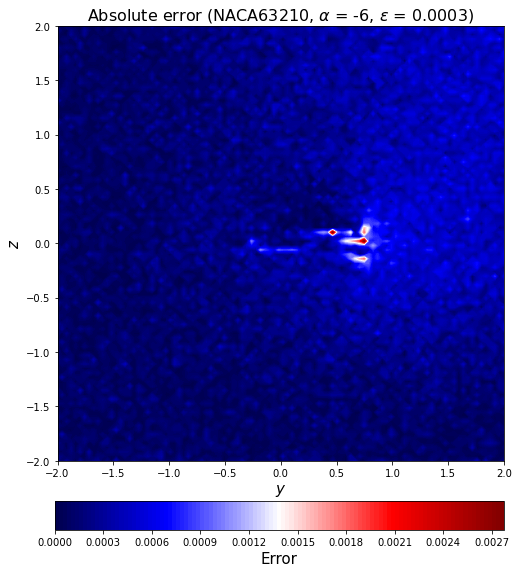

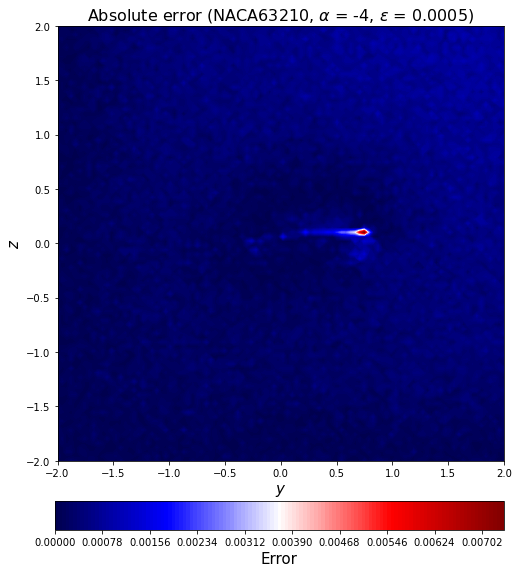

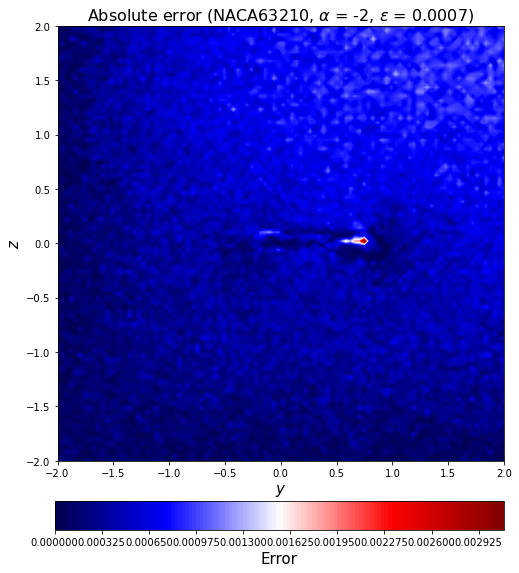

...

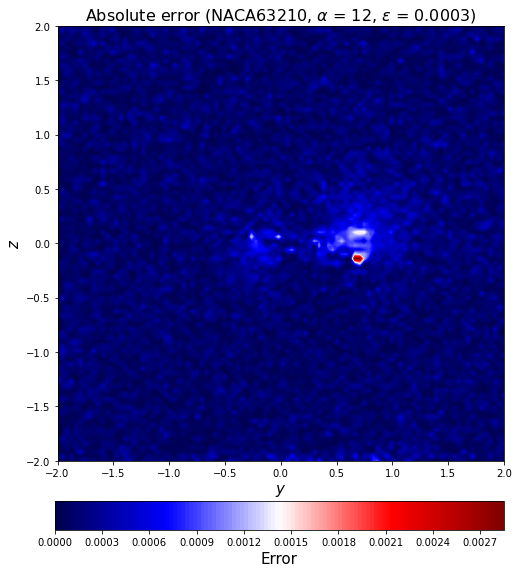

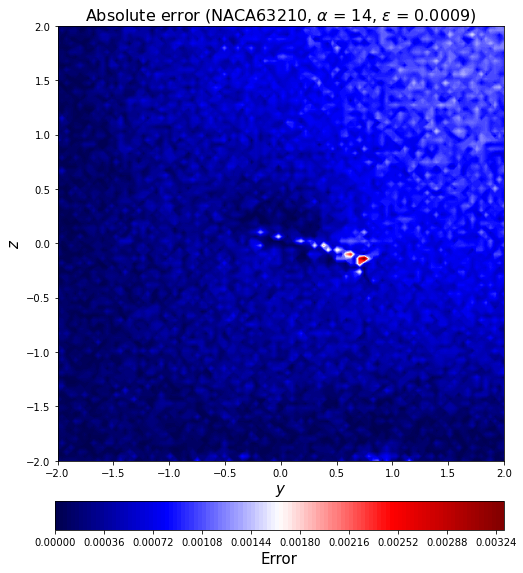

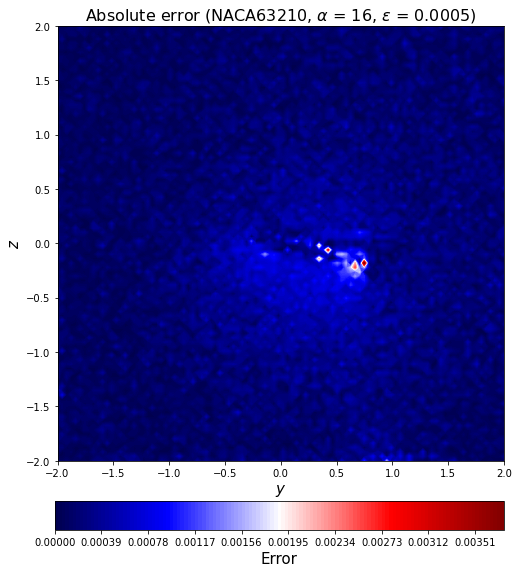

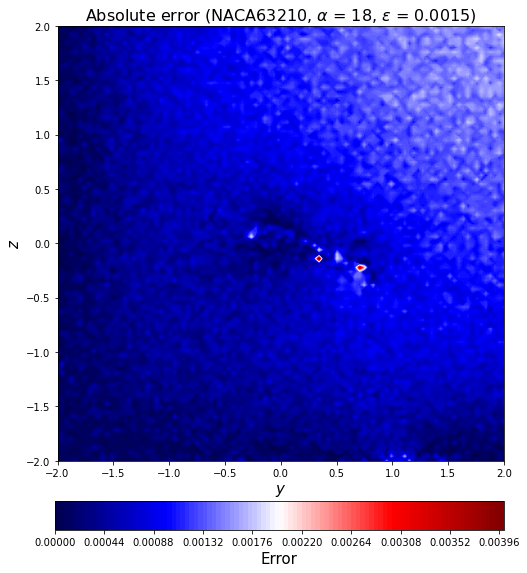

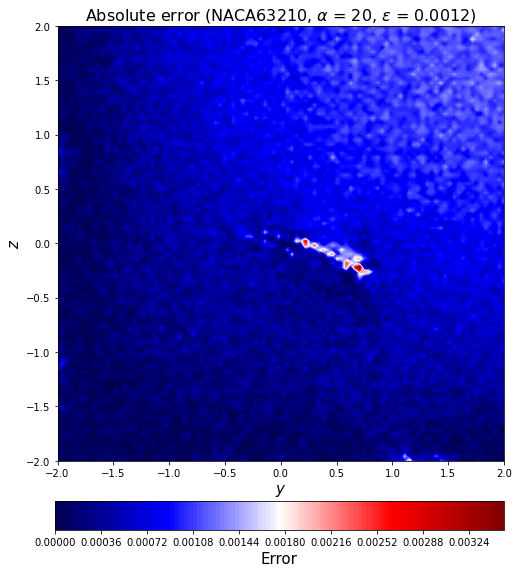

In [86]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[2*16+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[2*16+c])[3:-2],
                                                                       aa_test[2*16+c], l2_error_test_list[2*16+c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

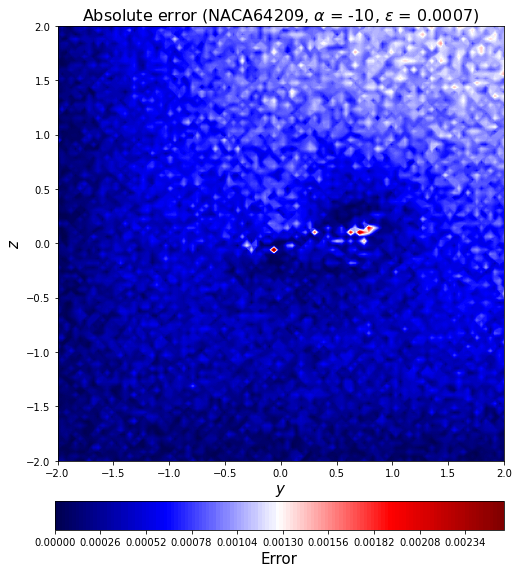

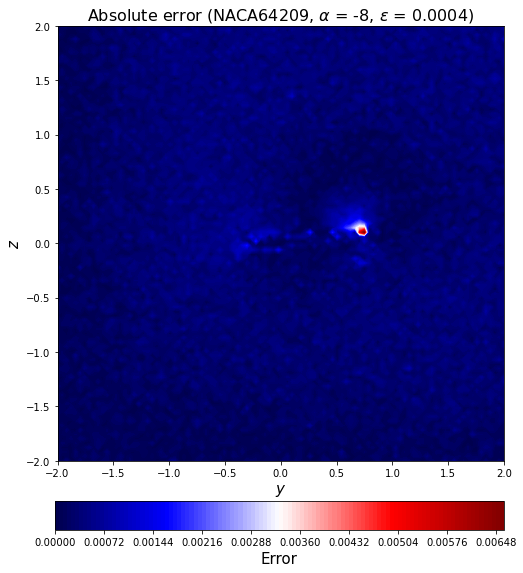

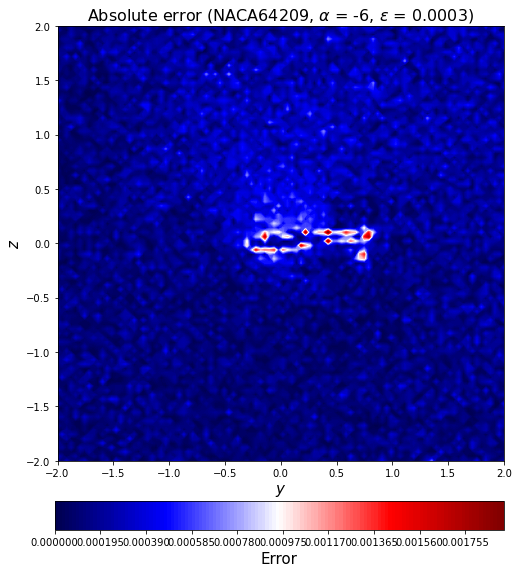

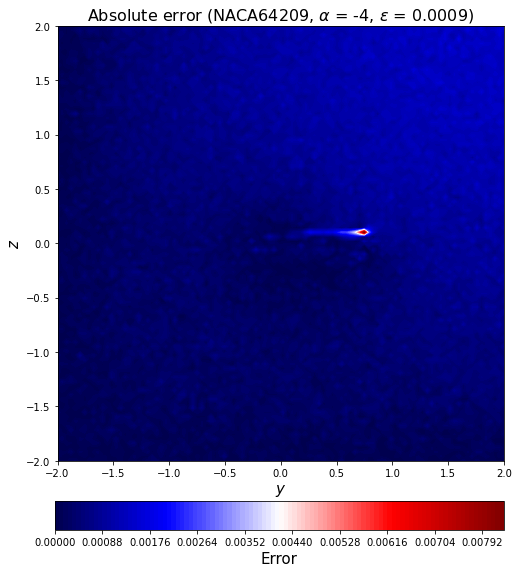

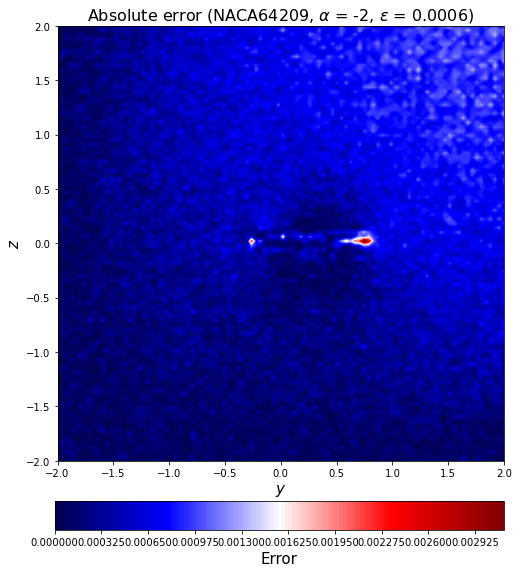

...

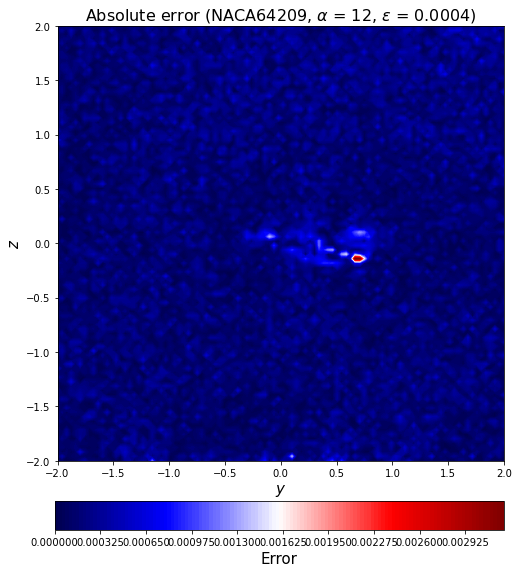

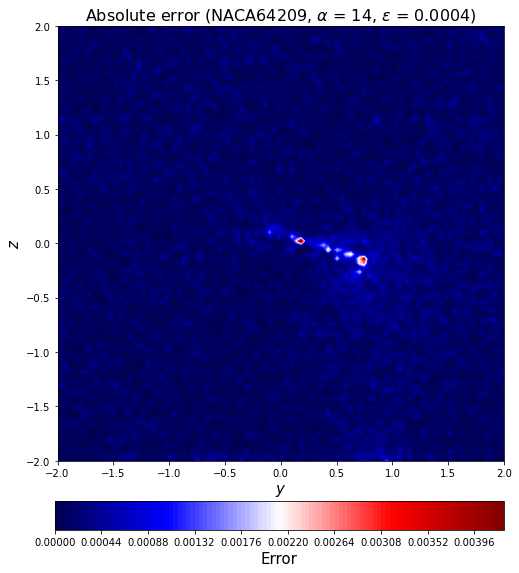

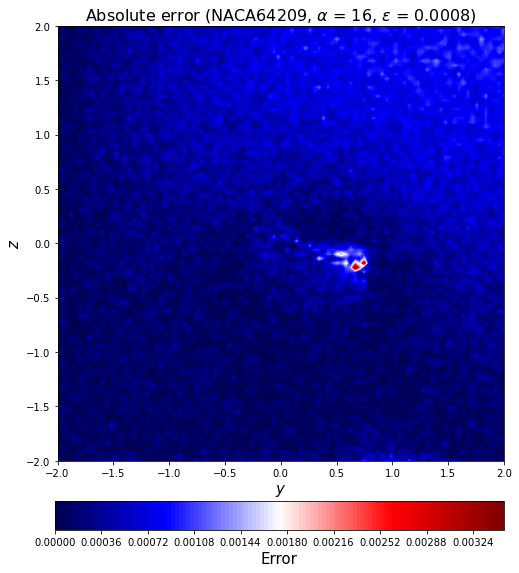

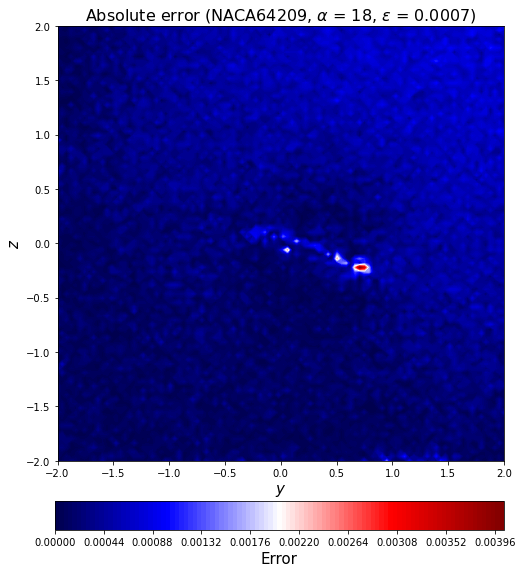

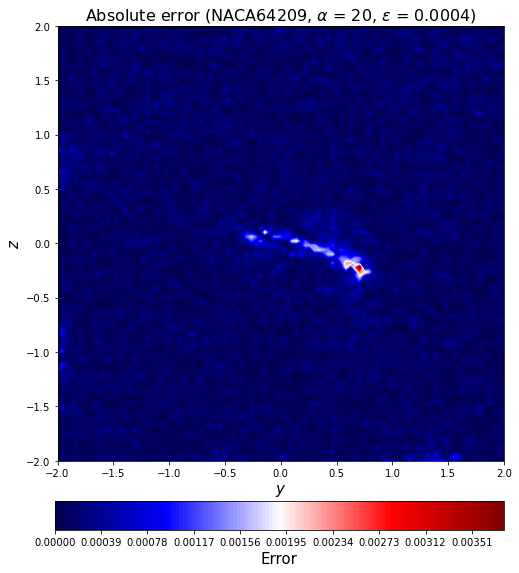

In [87]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

In [88]:
MAPE_train = (np.sum(np.abs(np.sum(y_train)-np.sum(decoded_train))) / np.abs(np.sum(y_train)))/(y_train.shape[0]/16)*100
acc_train = 1-MAPE_train

In [89]:
MAPE_val = (np.sum(np.abs(np.sum(y_val)-np.sum(decoded_val))) / np.abs(np.sum(y_val)))/(y_val.shape[0]/16)*100
acc_val = 1-MAPE_val

In [90]:
MAPE_test = (np.sum(np.abs(np.sum(y_test)-np.sum(decoded_test))) / np.abs(np.sum(y_test)))/(y_test.shape[0]/16)*100
acc_test = 1-MAPE_test

In [91]:
print(MAPE_train)
print(acc_train)

1.270632731493866e-05
0.999987293672685


In [92]:
print(MAPE_val)
print(acc_val)

0.001043677097714119
0.9989563229022859


In [93]:
print(MAPE_test)
print(acc_test)

0.01337029451133371
0.9866297054886662


In [94]:
MAPE_train_list = []
acc_train_list = []
for i in range(0, len(aa_train)):
    MAPE_train_data = (np.sum(np.abs(y_train[i]-decoded_train[i])) / np.sum(np.abs(y_train[i])))/(y_train.shape[0]/16)*100
    MAPE_train_list.append(MAPE_train_data)
    acc_train_data = 1 - MAPE_train_data
    acc_train_list.append(acc_train_data)

In [95]:
MAPE_val_list = []
acc_val_list = []
for i in range(0, len(aa_val)):
    MAPE_val_data = (np.sum(np.abs(y_val[i]-decoded_val[i])) / np.sum(np.abs(y_val[i])))/(y_val.shape[0]/16)*100
    MAPE_val_list.append(MAPE_val_data)
    acc_val_data = 1 - MAPE_val_data
    acc_val_list.append(acc_val_data)

In [96]:
MAPE_test_list = []
acc_test_list = []
for i in range(0, len(aa_test)):
    MAPE_test_data = (np.sum(np.abs(y_test[i]-decoded_test[i])) / np.sum(np.abs(y_test[i])))/(y_test.shape[0]/16)*100
    MAPE_test_list.append(MAPE_test_data)
    acc_test_data = 1 - MAPE_test_data
    acc_test_list.append(acc_test_data)

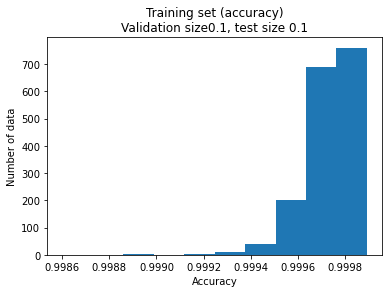

In [97]:
plt.hist(acc_train_list)
plt.title('Training set (accuracy)\nValidation size0.1, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
save_acc_name = "20221030Accuracy_Poisson_bc2(training).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

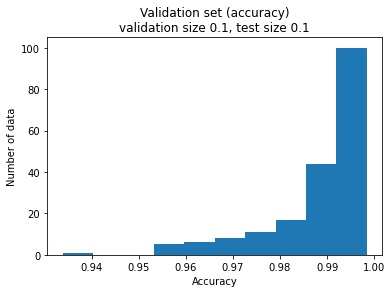

In [98]:
plt.hist(acc_val_list)
plt.title('Validation set (accuracy)\nvalidation size 0.1, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(validation).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

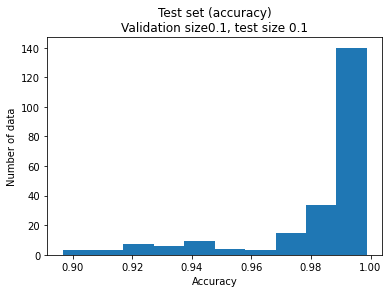

In [99]:
plt.hist(acc_test_list)
plt.title('Test set (accuracy)\nValidation size0.1, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(test).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

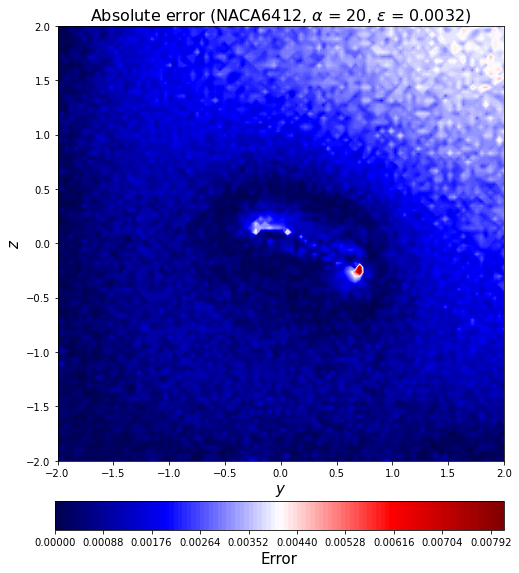

In [100]:
error_test_abs2_rotate = error_test_abs[-1].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-1])[3:-2],
                                                                   aa_test[-1], l2_error_test_list[-1]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-1])[3:-2])+str(aa_test[-1])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

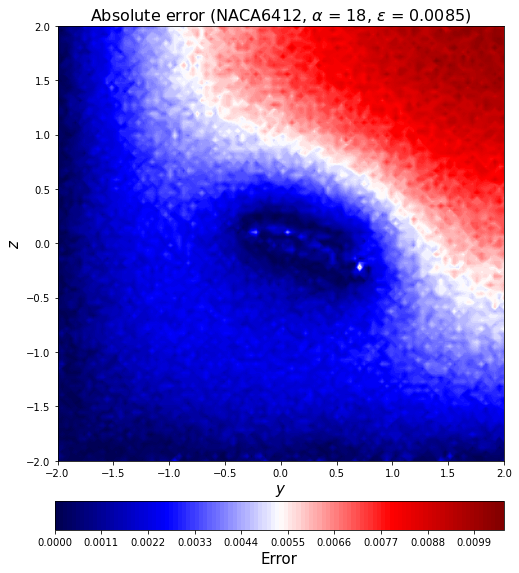

In [101]:
error_test_abs2_rotate = error_test_abs[-2].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-2])[3:-2],
                                                                   aa_test[-2], l2_error_test_list[-2]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-2])[3:-2])+str(aa_test[-2])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

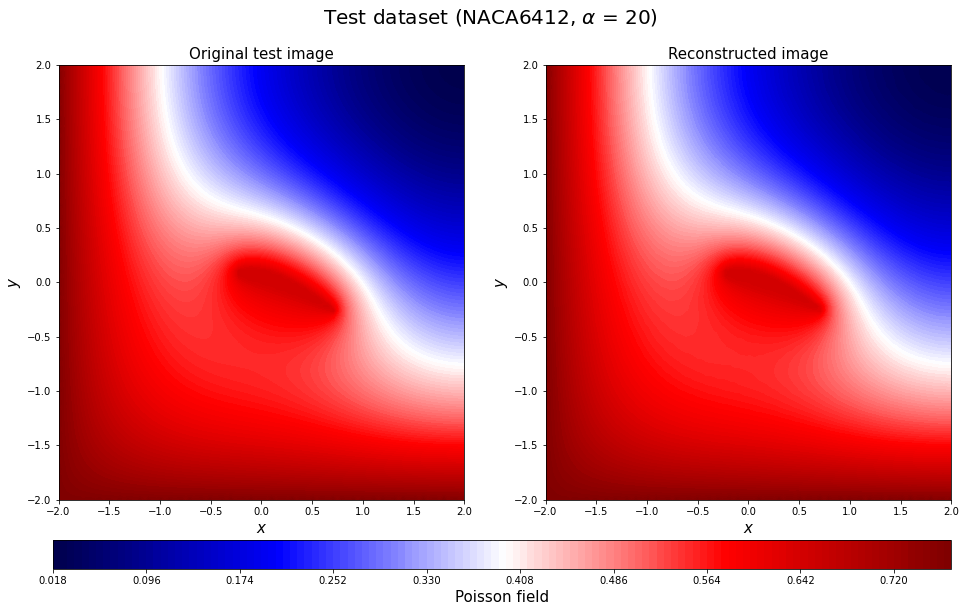

In [102]:
c=-1
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

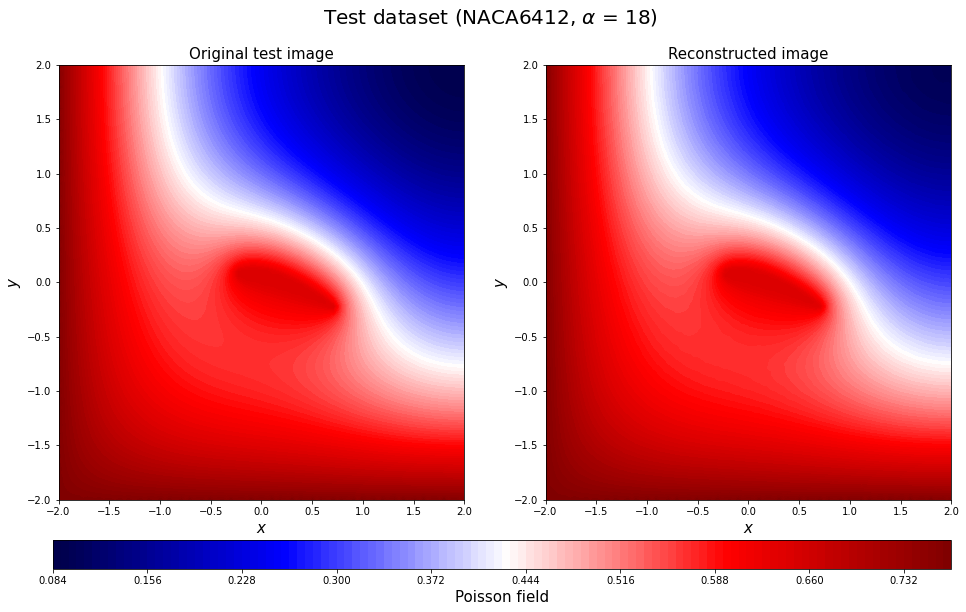

In [103]:
c=-2
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

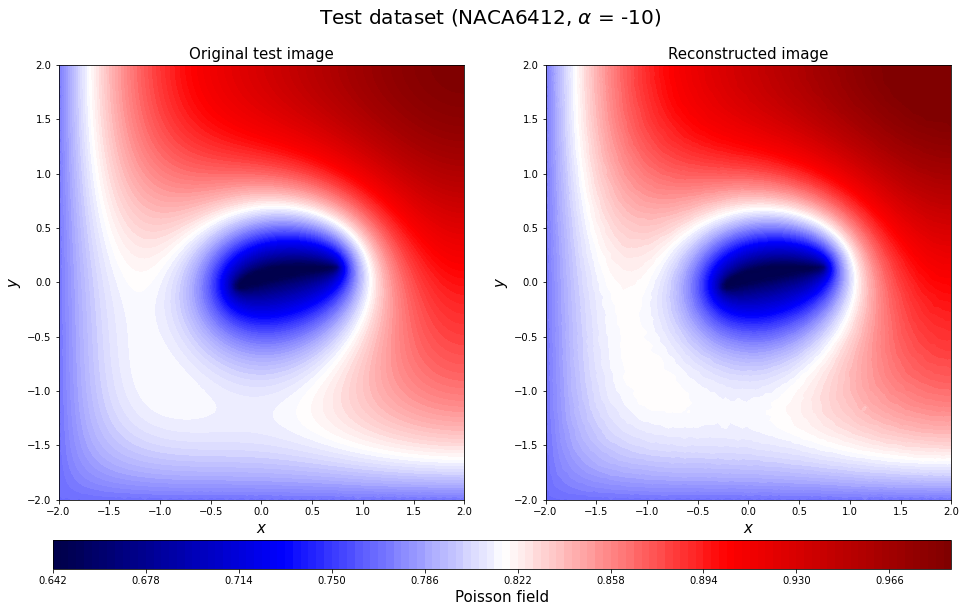

In [104]:
c=-16
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

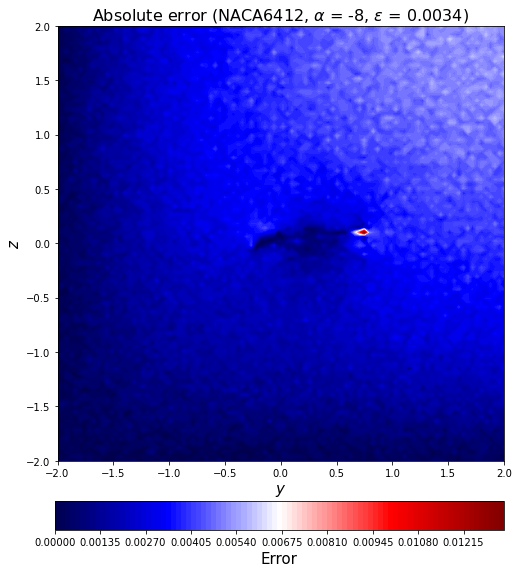

In [105]:
error_test_abs2_rotate = error_test_abs[-15].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-15])[3:-2],
                                                                   aa_test[-15], l2_error_test_list[-15]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-15])[3:-2])+str(aa_test[-15])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

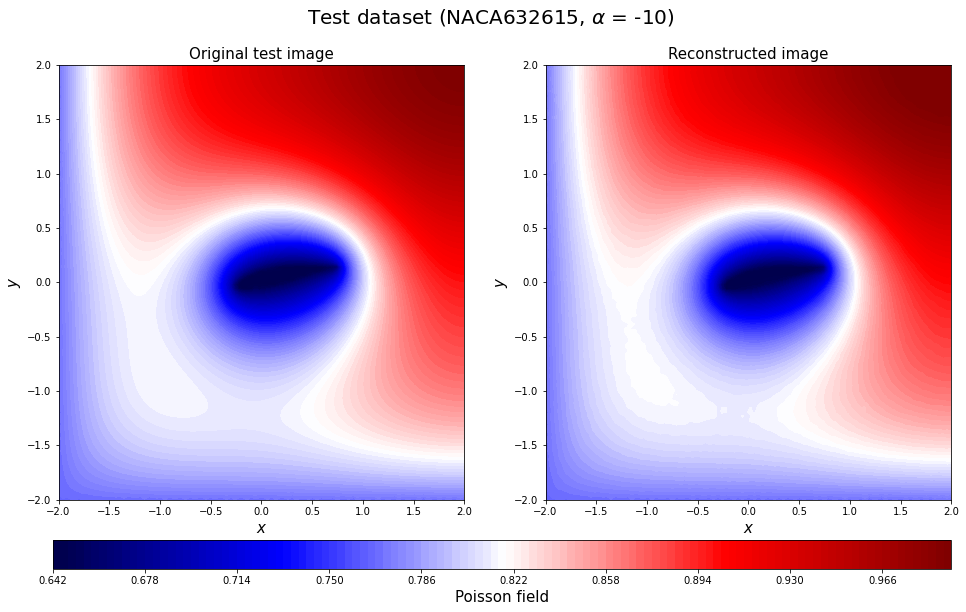

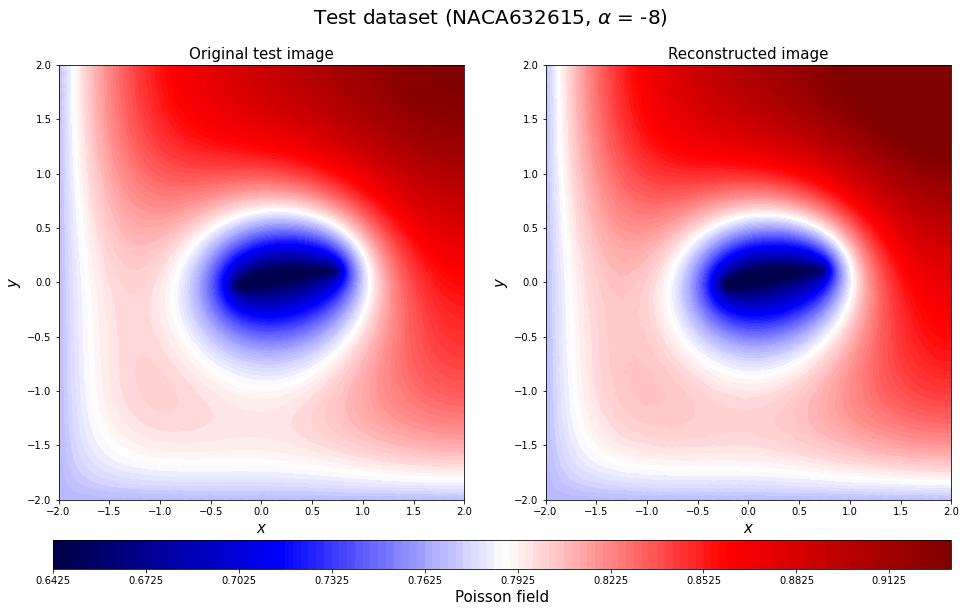

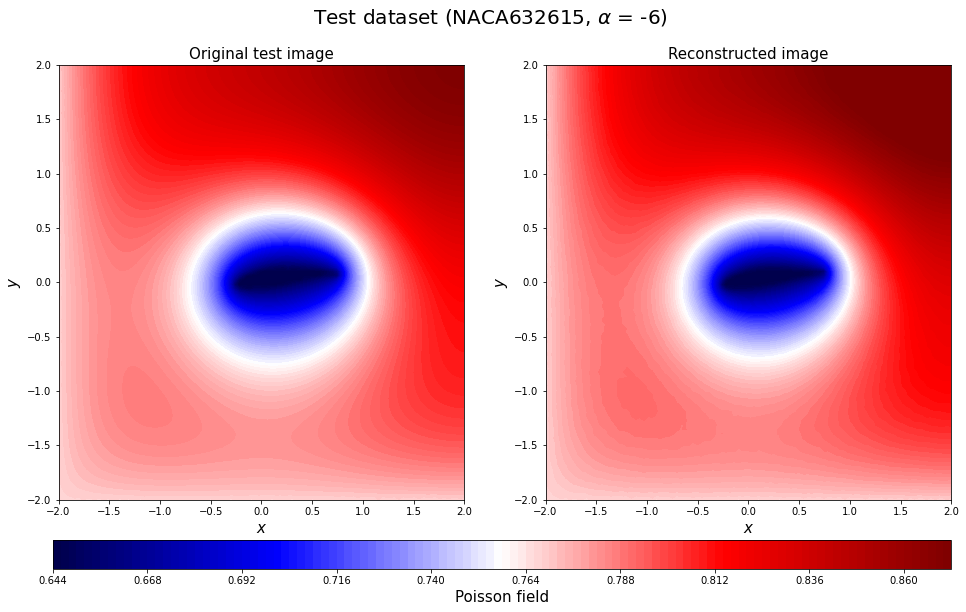

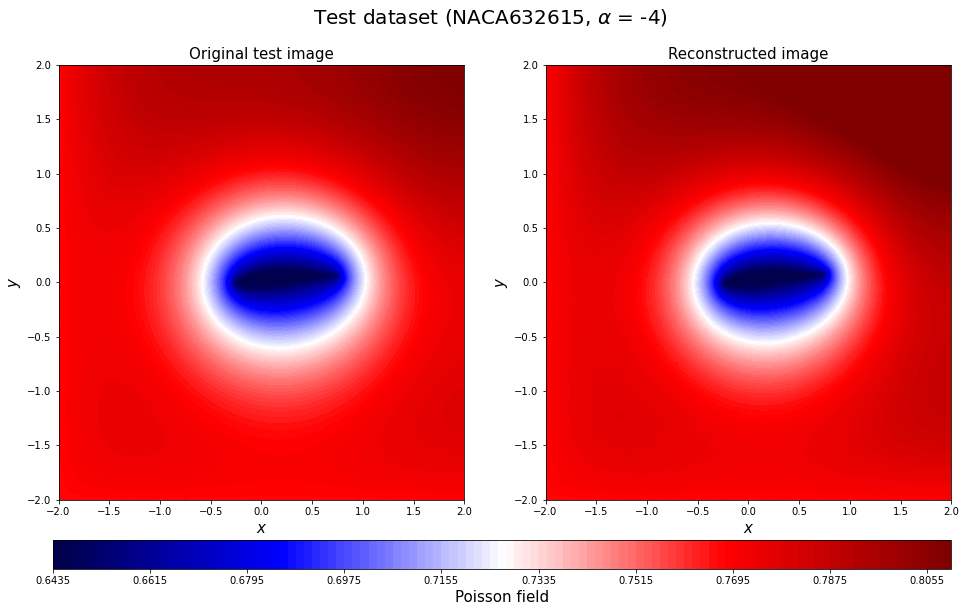

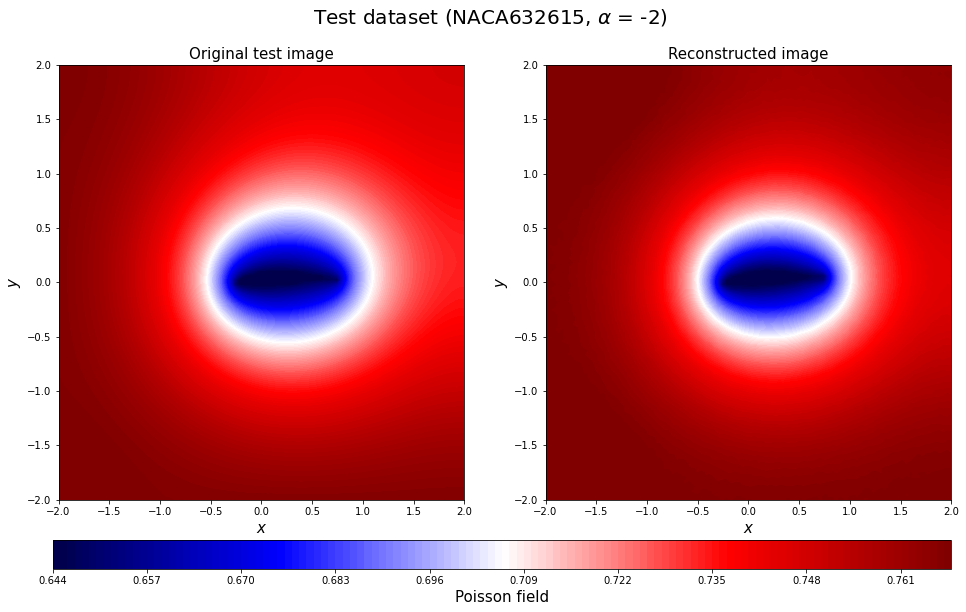

...

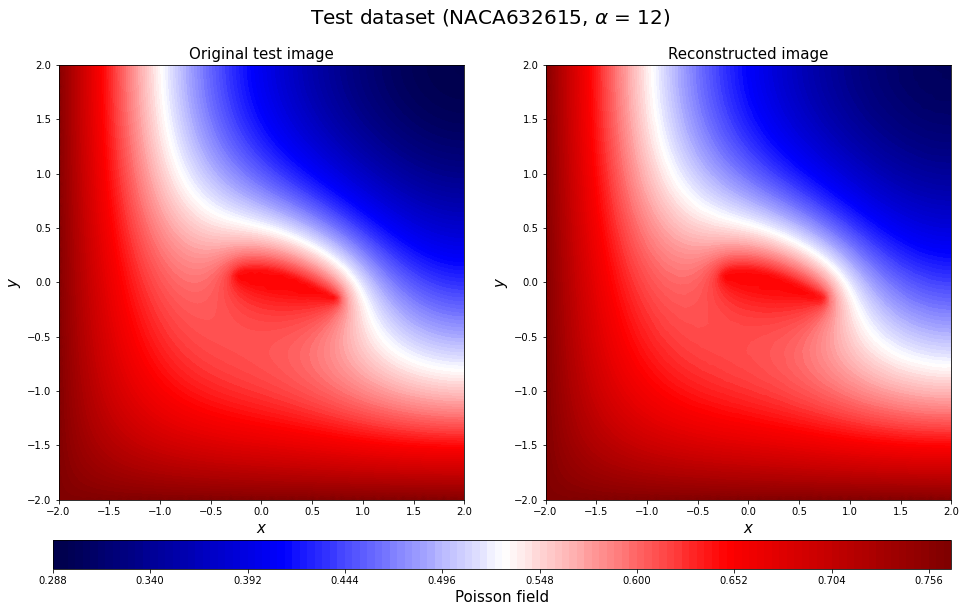

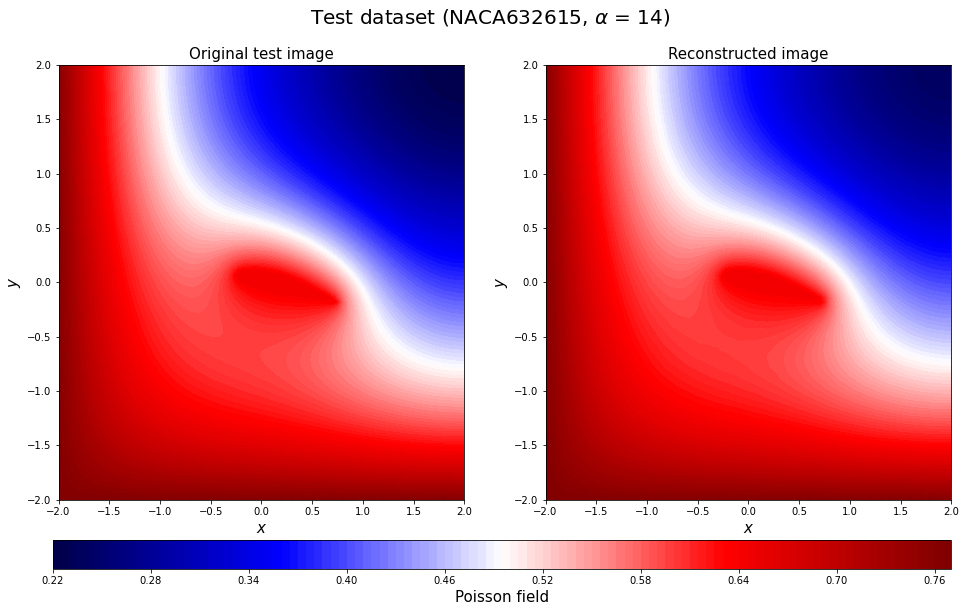

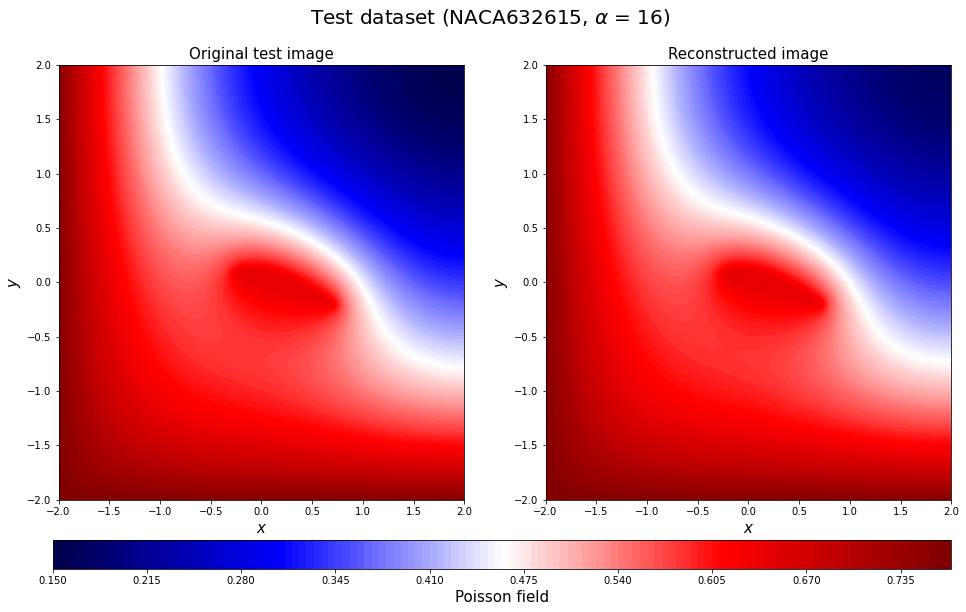

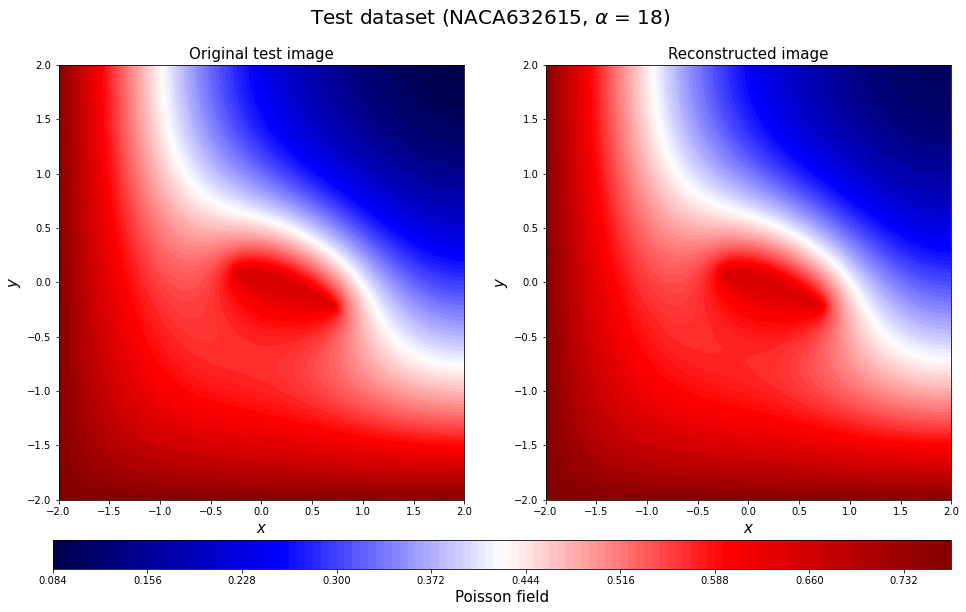

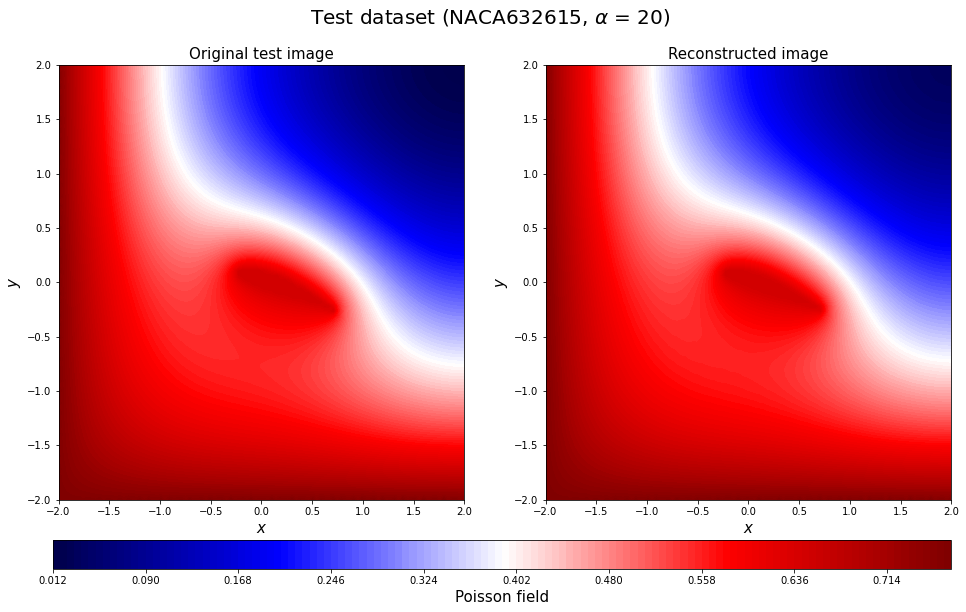

In [106]:
for c in range(96,112):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

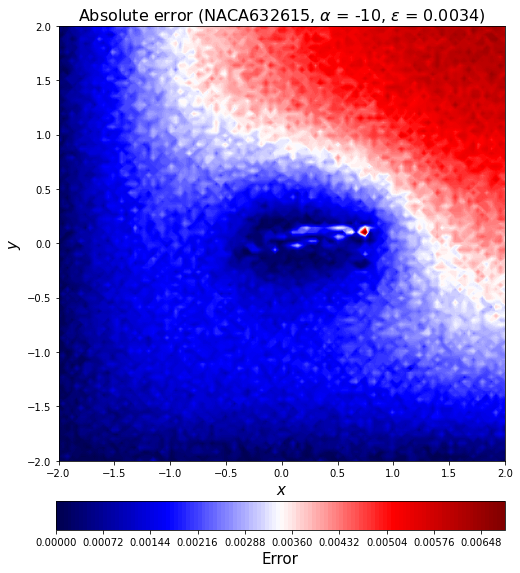

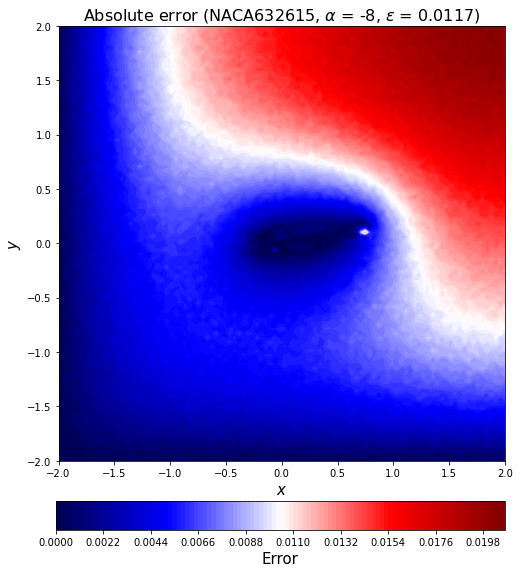

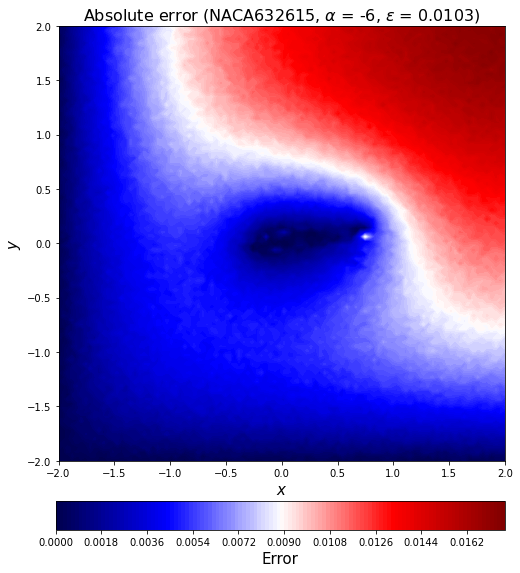

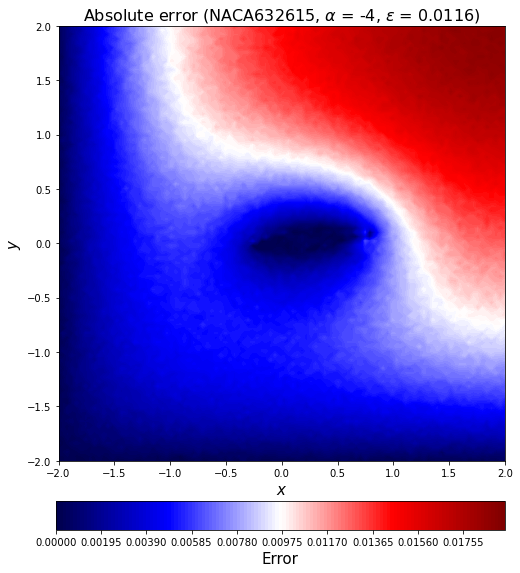

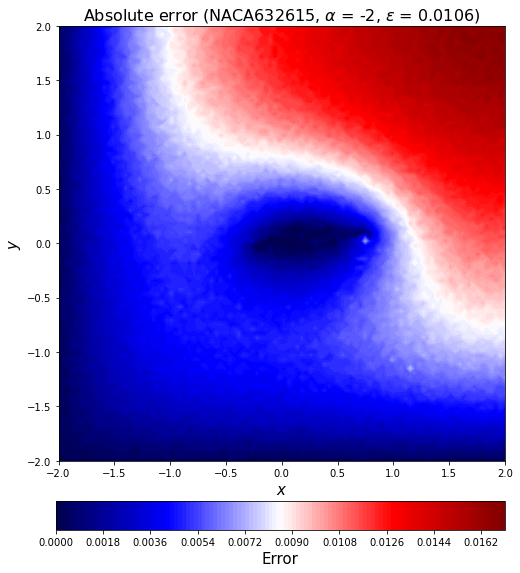

...

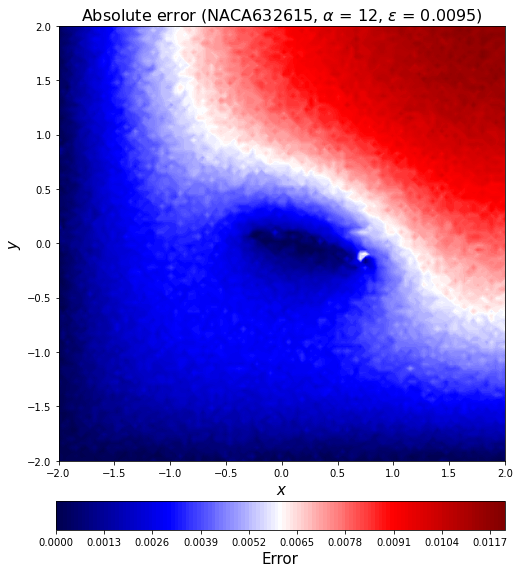

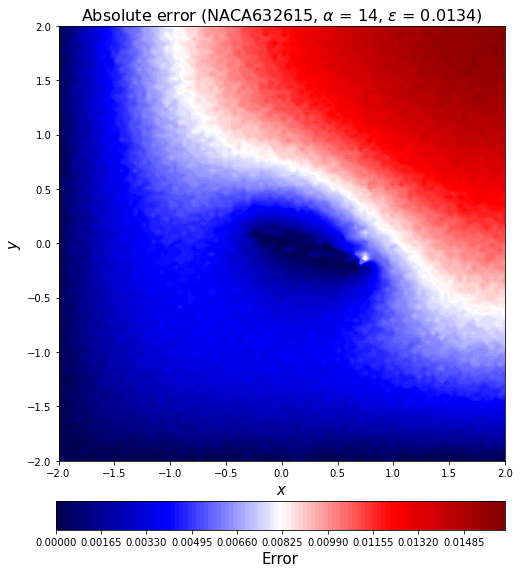

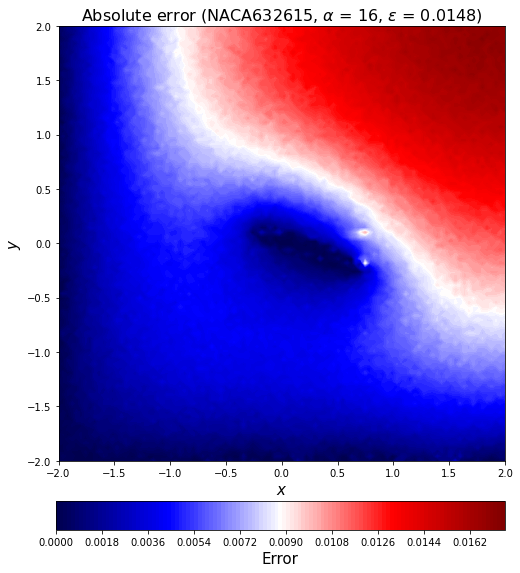

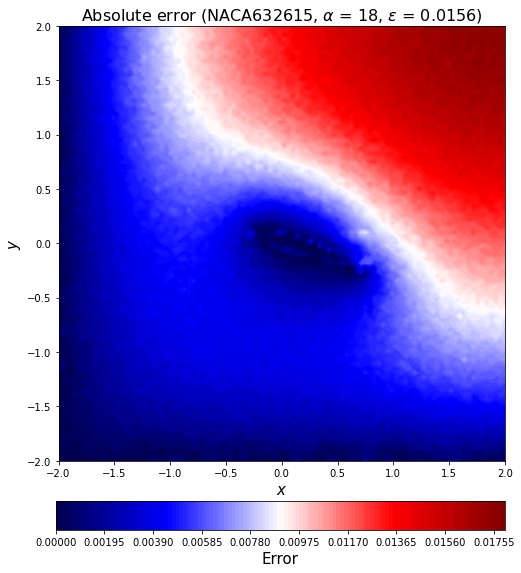

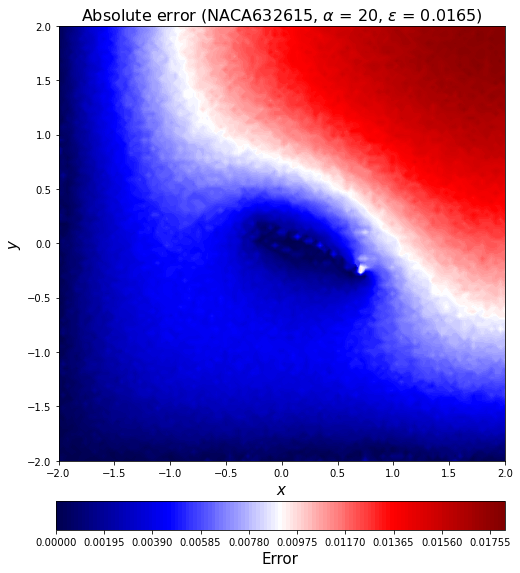

In [107]:
for c in range(96,112):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

0.999900296193777
9.970380622303932e-05
0.9986879450264109
0.0013120549735891052
0.9976696435775814
0.0023303564224186335


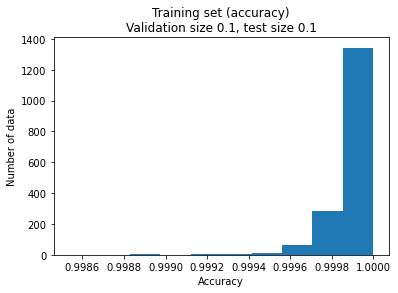

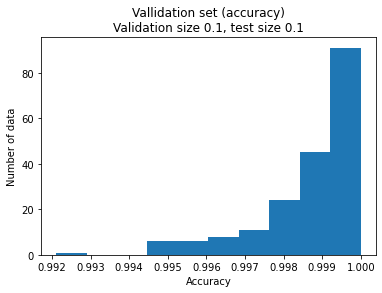

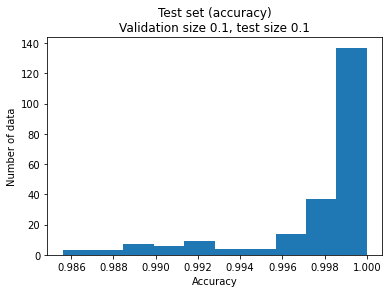

In [111]:
yTrainSum = np.zeros((y_train.shape[0],1))
dTrainSum = np.zeros((decoded_train.shape[0], 1))
MAPE_train_list = np.zeros((y_train.shape[0], 1))
for i in range(0, y_train.shape[0]):
    yTrainSum[i,:] = np.sum(y_train[i])
    dTrainSum[i,:] = np.sum(decoded_train[i])
    MAPE_train_list[i,:] = np.abs((dTrainSum[i,:]-yTrainSum[i,:])/yTrainSum[i,:])
    
MAPE_train =1-np.sum(MAPE_train_list)/x_train.shape[0]
print(MAPE_train)
acc_train = 1-MAPE_train
print(acc_train)
acc_train_list = 1 - MAPE_train_list

yValSum = np.zeros((y_val.shape[0],1))
dValSum = np.zeros((decoded_val.shape[0], 1))
MAPE_val_list = np.zeros((y_val.shape[0], 1))
for i in range(0, y_val.shape[0]):
    yValSum[i,:] = np.sum(y_val[i])
    dValSum[i,:] = np.sum(decoded_val[i])
    MAPE_val_list[i,:] = np.abs((dValSum[i,:]-yValSum[i,:])/yValSum[i,:])
    
MAPE_val = 1-np.sum(MAPE_val_list)/x_val.shape[0]
print(MAPE_val)
acc_val = 1-MAPE_val
print(acc_val)
acc_val_list = 1 - MAPE_val_list

yTestSum = np.zeros((y_test.shape[0],1))
dTestSum = np.zeros((decoded_test.shape[0], 1))
MAPE_test_list = np.zeros((y_test.shape[0], 1))
for i in range(0, y_test.shape[0]):
    yTestSum[i,:] = np.sum(y_test[i])
    dTestSum[i,:] = np.sum(decoded_test[i])
    MAPE_test_list[i,:] = np.abs((dTestSum[i,:]-yTestSum[i,:])/yTestSum[i,:])
    
MAPE_test = 1-np.sum(MAPE_test_list)/x_test.shape[0]
print(MAPE_test)
acc_test = 1-MAPE_test
print(acc_test)
acc_test_list = 1 - MAPE_test_list

plt.hist(acc_train_list)
plt.title('Training set (accuracy)\nValidation size 0.1, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
save_acc_name = "20221030Accuracy_Poisson_bc2(training).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

plt.hist(acc_val_list)
plt.title('Vallidation set (accuracy)\nValidation size 0.1, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(validation).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

plt.hist(acc_test_list)
plt.title('Test set (accuracy)\nValidation size 0.1, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(test).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()